In [109]:
import requests  # Para hacer peticiones HTTP
from bs4 import BeautifulSoup  # Para parsear HTML
import pandas as pd  # Para trabajar con DataFrames
import time  # Para pausas entre peticiones
from tqdm import tqdm  # Para barras de progreso
import numpy as np
from datetime import datetime
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
from sklearn.linear_model import LinearRegression

# Lista para almacenar los datos recopilados de todos los años y meses
all_data = []

# Definimos el rango de años que queremos analizar
start_year = 1974
end_year = 2024

# ID de la estación meteorológica (tomado de la URL)
station_id = "724080"

# Base de la URL con formato donde cambiaremos año y mes
BASE_URL = "https://www.tutiempo.net/clima/{:02d}-{:d}/ws-{}.html"

# Bucle para recorrer todos los años y meses con barra de progreso
for year in tqdm(range(start_year, end_year + 1), desc="Procesando años"):
    for month in tqdm(range(1, 13), desc=f"Procesando meses de {year}", leave=False):
        # Formateamos la URL con el año y mes actual
        url = BASE_URL.format(month, year, station_id)

        # Hacemos la petición GET a la URL
        response = requests.get(url)

        # Verificamos si la petición fue exitosa (código 200)
        if response.status_code != 200:
            print(f"Error al acceder a {url}")
            continue  # Si hay error, pasamos al siguiente mes

        # Parseamos el HTML de la respuesta con BeautifulSoup
        soup = BeautifulSoup(response.text, "html.parser")

        # Buscamos la tabla con las medias mensuales
        table = soup.find("table", class_="medias")

        # Verificamos si encontramos la tabla
        if not table:
            print(f"No se encontró la tabla en {url}")
            continue  # Si no hay tabla, pasamos al siguiente mes

        # Buscamos todas las filas de la tabla
        rows = table.find_all("tr")

        # Verificamos si hay filas en la tabla
        if len(rows) == 0:
            print(f"No se encontraron filas en la tabla de {url}")
            continue  # Si no hay filas, pasamos al siguiente mes

        # Extraemos los datos relevantes de la última fila (la de las medias)
        monthly_data = rows[-1].find_all("td")
        print(monthly_data)  # Imprimimos las celdas para verificar

        # Verificamos si hay suficientes celdas en la fila
        if len(monthly_data) >= 6:
            # Extraemos y limpiamos los datos de temperatura media, mínima, máxima y precipitaciones
            temp_media = monthly_data[1].text.strip().replace("-", "").replace("N/D", "")
            temp_min = monthly_data[2].text.strip().replace("-", "").replace("N/D", "")
            temp_max = monthly_data[3].text.strip().replace("-", "").replace("N/D", "")
            precip = monthly_data[4].text.strip().replace("-", "").replace("N/D", "")

            # Agregamos los datos a la lista all_data
            all_data.append([year, month, temp_media, temp_min, temp_max, precip])

        # Pausa de 2 segundos para no sobrecargar el servidor
        time.sleep(2)

# Convertimos la lista en un DataFrame de Pandas
df = pd.DataFrame(all_data, columns=["Ano", "Mes", "Temp Media", "Temp Minima", "Temp Maxima", "Precipitaciones Totales"])

# Imprimimos el DataFrame resultante
print(df)


cesando meses de 1974:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">2.1</td>, <td class="tc3">7.4</td>, <td class="tc4">-2.1</td>, <td class="tc5">1021.1</td>, <td class="tc6">70.2</td>, <td class="tc7"><span>83.83</span></td>, <td class="tc8">14.1</td>, <td class="tc9">14.2</td>, <td class="tc10">24.8</td>, <td> </td>, <td>14</td>, <td>4</td>, <td>0</td>, <td>16</td>]



cesando meses de 1974:   8%|█            | 1/12 [00:02<00:23,  2.14s/it]

[<td> </td>, <td class="tc2">0.2</td>, <td class="tc3">6.9</td>, <td class="tc4">-5.2</td>, <td class="tc5">1015.2</td>, <td class="tc6">57.3</td>, <td class="tc7"><span>48.76</span></td>, <td class="tc8">18.7</td>, <td class="tc9">19.3</td>, <td class="tc10">29.9</td>, <td> </td>, <td>11</td>, <td>11</td>, <td>2</td>, <td>5</td>]



cesando meses de 1974:  17%|██▏          | 2/12 [00:04<00:21,  2.14s/it]

[<td> </td>, <td class="tc2">6.5</td>, <td class="tc3">13.3</td>, <td class="tc4">0.4</td>, <td class="tc5">1014.9</td>, <td class="tc6">55.4</td>, <td class="tc7"><span>144.02</span></td>, <td class="tc8">21.3</td>, <td class="tc9">20.7</td>, <td class="tc10">33</td>, <td> </td>, <td>17</td>, <td>5</td>, <td>2</td>, <td>11</td>]



cesando meses de 1974:  25%|███▎         | 3/12 [00:06<00:19,  2.15s/it]

[<td> </td>, <td class="tc2">13.1</td>, <td class="tc3">20.5</td>, <td class="tc4">6</td>, <td class="tc5">1015.4</td>, <td class="tc6">54.6</td>, <td class="tc7"><span>80.51</span></td>, <td class="tc8">20.3</td>, <td class="tc9">19.3</td>, <td class="tc10">31.3</td>, <td> </td>, <td>12</td>, <td>1</td>, <td>2</td>, <td>8</td>]



cesando meses de 1974:  33%|████▎        | 4/12 [00:08<00:17,  2.14s/it]

[<td> </td>, <td class="tc2">16.9</td>, <td class="tc3">24.3</td>, <td class="tc4">10.5</td>, <td class="tc5">1014.2</td>, <td class="tc6">55.2</td>, <td class="tc7"><span>89.66</span></td>, <td class="tc8">18.8</td>, <td class="tc9">16.8</td>, <td class="tc10">28.6</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>4</td>, <td>7</td>]



cesando meses de 1974:  42%|█████▍       | 5/12 [00:10<00:14,  2.14s/it]

[<td> </td>, <td class="tc2">21</td>, <td class="tc3">27.6</td>, <td class="tc4">15.3</td>, <td class="tc5">1014.8</td>, <td class="tc6">65.9</td>, <td class="tc7"><span>117.1</span></td>, <td class="tc8">13.6</td>, <td class="tc9">15.8</td>, <td class="tc10">26.4</td>, <td> </td>, <td>18</td>, <td>0</td>, <td>4</td>, <td>17</td>]



cesando meses de 1974:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">24.9</td>, <td class="tc3">31.3</td>, <td class="tc4">18.4</td>, <td class="tc5">1016</td>, <td class="tc6">60.2</td>, <td class="tc7"><span>75.96</span></td>, <td class="tc8">16.2</td>, <td class="tc9">14.3</td>, <td class="tc10">24.2</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>4</td>, <td>11</td>]



cesando meses de 1974:  58%|███████▌     | 7/12 [00:14<00:10,  2.14s/it]

[<td> </td>, <td class="tc2">24.4</td>, <td class="tc3">30.4</td>, <td class="tc4">19</td>, <td class="tc5">1018.8</td>, <td class="tc6">67.7</td>, <td class="tc7"><span>135.14</span></td>, <td class="tc8">12.9</td>, <td class="tc9">13.7</td>, <td class="tc10">23.5</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>6</td>, <td>14</td>]



cesando meses de 1974:  67%|████████▋    | 8/12 [00:17<00:08,  2.14s/it]

[<td> </td>, <td class="tc2">20</td>, <td class="tc3">26.2</td>, <td class="tc4">14.5</td>, <td class="tc5">1017.9</td>, <td class="tc6">69.8</td>, <td class="tc7"><span>135.62</span></td>, <td class="tc8">15.4</td>, <td class="tc9">14.2</td>, <td class="tc10">23.8</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>7</td>, <td>17</td>]



cesando meses de 1974:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">12.3</td>, <td class="tc3">19.9</td>, <td class="tc4">5.4</td>, <td class="tc5">1023.3</td>, <td class="tc6">62.1</td>, <td class="tc7"><span>49.02</span></td>, <td class="tc8">20.4</td>, <td class="tc9">13.5</td>, <td class="tc10">22</td>, <td> </td>, <td>6</td>, <td>0</td>, <td>1</td>, <td>7</td>]



cesando meses de 1974:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">9.1</td>, <td class="tc3">15.8</td>, <td class="tc4">3.2</td>, <td class="tc5">1017.4</td>, <td class="tc6">61.1</td>, <td class="tc7"><span>28.97</span></td>, <td class="tc8">20.4</td>, <td class="tc9">15.8</td>, <td class="tc10">25.1</td>, <td> </td>, <td>11</td>, <td>1</td>, <td>1</td>, <td>9</td>]



cesando meses de 1974:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">4.4</td>, <td class="tc3">9.6</td>, <td class="tc4">-0.5</td>, <td class="tc5">1016.9</td>, <td class="tc6">66.5</td>, <td class="tc7"><span>120.16</span></td>, <td class="tc8">18.8</td>, <td class="tc9">15.9</td>, <td class="tc10">27.5</td>, <td> </td>, <td>11</td>, <td>2</td>, <td>1</td>, <td>10</td>]



cesando meses de 1975:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">2.9</td>, <td class="tc3">9.2</td>, <td class="tc4">-2.6</td>, <td class="tc5">1019.4</td>, <td class="tc6"><span>68.8</span></td>, <td class="tc7"><span>124.21</span></td>, <td class="tc8">17.8</td>, <td class="tc9">16.3</td>, <td class="tc10">27.9</td>, <td> </td>, <td>16</td>, <td>8</td>, <td>1</td>, <td>15</td>]



cesando meses de 1975:   8%|█            | 1/12 [00:02<00:23,  2.13s/it]

[<td> </td>, <td class="tc2">2.2</td>, <td class="tc3">7.5</td>, <td class="tc4">-3.1</td>, <td class="tc5">1018.2</td>, <td class="tc6"><span>65.8</span></td>, <td class="tc7"><span>70.37</span></td>, <td class="tc8">18.7</td>, <td class="tc9">16</td>, <td class="tc10">28.1</td>, <td> </td>, <td>11</td>, <td>7</td>, <td>0</td>, <td>11</td>]



cesando meses de 1975:  17%|██▏          | 2/12 [00:04<00:21,  2.14s/it]

[<td> </td>, <td class="tc2">5.1</td>, <td class="tc3">11.6</td>, <td class="tc4">-0.9</td>, <td class="tc5">1014.7</td>, <td class="tc6">57.8</td>, <td class="tc7"><span>133.36</span></td>, <td class="tc8">22.2</td>, <td class="tc9">18.7</td>, <td class="tc10">29.4</td>, <td> </td>, <td>16</td>, <td>5</td>, <td>1</td>, <td>12</td>]



cesando meses de 1975:  25%|███▎         | 3/12 [00:06<00:19,  2.13s/it]

[<td> </td>, <td class="tc2">9.1</td>, <td class="tc3">15.8</td>, <td class="tc4">2.1</td>, <td class="tc5">1014.9</td>, <td class="tc6">49.1</td>, <td class="tc7"><span>55.62</span></td>, <td class="tc8">23.3</td>, <td class="tc9">20</td>, <td class="tc10">31.5</td>, <td> </td>, <td>8</td>, <td>3</td>, <td>0</td>, <td>6</td>]



cesando meses de 1975:  33%|████▎        | 4/12 [00:08<00:16,  2.12s/it]

[<td> </td>, <td class="tc2">18.6</td>, <td class="tc3">25.8</td>, <td class="tc4">12.8</td>, <td class="tc5">1015.4</td>, <td class="tc6">64</td>, <td class="tc7"><span>115.31</span></td>, <td class="tc8">14.9</td>, <td class="tc9">13.2</td>, <td class="tc10">23.3</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>6</td>, <td>17</td>]



cesando meses de 1975:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">22</td>, <td class="tc3">28.4</td>, <td class="tc4">16.7</td>, <td class="tc5">1016.8</td>, <td class="tc6">70.7</td>, <td class="tc7"><span>197.87</span></td>, <td class="tc8">16.3</td>, <td class="tc9">13.5</td>, <td class="tc10">24.3</td>, <td> </td>, <td>16</td>, <td>0</td>, <td>10</td>, <td>16</td>]



cesando meses de 1975:  50%|██████▌      | 6/12 [00:12<00:12,  2.12s/it]

[<td> </td>, <td class="tc2">24.5</td>, <td class="tc3">30.5</td>, <td class="tc4">18.8</td>, <td class="tc5">1016.1</td>, <td class="tc6">70.1</td>, <td class="tc7"><span>162.55</span></td>, <td class="tc8">15.5</td>, <td class="tc9">11.6</td>, <td class="tc10">20.9</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>13</td>, <td>14</td>]



cesando meses de 1975:  58%|███████▌     | 7/12 [00:14<00:10,  2.14s/it]

[<td> </td>, <td class="tc2">25</td>, <td class="tc3">31.5</td>, <td class="tc4">19.2</td>, <td class="tc5">1017.4</td>, <td class="tc6">67.1</td>, <td class="tc7"><span>65.03</span></td>, <td class="tc8">15.2</td>, <td class="tc9">12.5</td>, <td class="tc10">22.2</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>3</td>, <td>12</td>]



cesando meses de 1975:  67%|████████▋    | 8/12 [00:17<00:08,  2.14s/it]

[<td> </td>, <td class="tc2">19.1</td>, <td class="tc3">25</td>, <td class="tc4">13.8</td>, <td class="tc5">1019.7</td>, <td class="tc6">70.5</td>, <td class="tc7"><span>150.87</span></td>, <td class="tc8">16.9</td>, <td class="tc9">14</td>, <td class="tc10">21.9</td>, <td> </td>, <td>20</td>, <td>0</td>, <td>3</td>, <td>13</td>]



cesando meses de 1975:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">16</td>, <td class="tc3">23.2</td>, <td class="tc4">10.2</td>, <td class="tc5">1019.9</td>, <td class="tc6">70.6</td>, <td class="tc7"><span>103.37</span></td>, <td class="tc8">16.4</td>, <td class="tc9">14.4</td>, <td class="tc10">23.9</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>1</td>, <td>18</td>]



cesando meses de 1975:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">11.2</td>, <td class="tc3">17.9</td>, <td class="tc4">4.8</td>, <td class="tc5">1020.3</td>, <td class="tc6">67.2</td>, <td class="tc7"><span>80.02</span></td>, <td class="tc8">17.9</td>, <td class="tc9">13.4</td>, <td class="tc10">23.3</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>2</td>, <td>11</td>]



cesando meses de 1975:  92%|███████████ | 11/12 [00:23<00:02,  2.14s/it]

[<td> </td>, <td class="tc2">2.9</td>, <td class="tc3">8.7</td>, <td class="tc4">-2.2</td>, <td class="tc5">1021.5</td>, <td class="tc6"><span>67.9</span></td>, <td class="tc7"><span>53.85</span></td>, <td class="tc8">19.9</td>, <td class="tc9">16.6</td>, <td class="tc10">27.1</td>, <td> </td>, <td>13</td>, <td>6</td>, <td>0</td>, <td>11</td>]



cesando meses de 1976:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">-1.6</td>, <td class="tc3">3.8</td>, <td class="tc4">-6.7</td>, <td class="tc5">1019.5</td>, <td class="tc6"><span>67</span></td>, <td class="tc7"><span>134.6</span></td>, <td class="tc8">22.2</td>, <td class="tc9">18.2</td>, <td class="tc10">29.5</td>, <td> </td>, <td>11</td>, <td>8</td>, <td>0</td>, <td>14</td>]



cesando meses de 1976:   8%|█            | 1/12 [00:02<00:23,  2.11s/it]

[<td> </td>, <td class="tc2">4.8</td>, <td class="tc3">12.6</td>, <td class="tc4">-2.5</td>, <td class="tc5">1016.7</td>, <td class="tc6">62.3</td>, <td class="tc7">72.89</td>, <td class="tc8">23.9</td>, <td class="tc9">18.3</td>, <td class="tc10">30.2</td>, <td> </td>, <td>9</td>, <td>4</td>, <td>1</td>, <td>8</td>]



cesando meses de 1976:  17%|██▏          | 2/12 [00:04<00:21,  2.14s/it]

[<td> </td>, <td class="tc2">7.8</td>, <td class="tc3">15.4</td>, <td class="tc4">1.4</td>, <td class="tc5">1018.3</td>, <td class="tc6">60.8</td>, <td class="tc7"><span>59.94</span></td>, <td class="tc8">21.5</td>, <td class="tc9">19.2</td>, <td class="tc10">32</td>, <td> </td>, <td>12</td>, <td>5</td>, <td>1</td>, <td>11</td>]



cesando meses de 1976:  25%|███▎         | 3/12 [00:06<00:19,  2.13s/it]

[<td> </td>, <td class="tc2">13.5</td>, <td class="tc3">21.3</td>, <td class="tc4">6.2</td>, <td class="tc5">1015.7</td>, <td class="tc6">47.7</td>, <td class="tc7"><span>61.46</span></td>, <td class="tc8">22.3</td>, <td class="tc9">17.4</td>, <td class="tc10">28.9</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>4</td>, <td>3</td>]



cesando meses de 1976:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">17</td>, <td class="tc3">24.2</td>, <td class="tc4">10.7</td>, <td class="tc5">1015</td>, <td class="tc6">60.4</td>, <td class="tc7"><span>134.37</span></td>, <td class="tc8">20.5</td>, <td class="tc9">16.5</td>, <td class="tc10">29.2</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>3</td>, <td>8</td>]



cesando meses de 1976:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">23.7</td>, <td class="tc3">30.6</td>, <td class="tc4">17.8</td>, <td class="tc5">1017.5</td>, <td class="tc6">64.7</td>, <td class="tc7"><span>86.87</span></td>, <td class="tc8">17.5</td>, <td class="tc9">15.2</td>, <td class="tc10">26.1</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>6</td>, <td>10</td>]



cesando meses de 1976:  50%|██████▌      | 6/12 [00:12<00:12,  2.12s/it]

[<td> </td>, <td class="tc2">23.8</td>, <td class="tc3">30</td>, <td class="tc4">18.4</td>, <td class="tc5">1014.1</td>, <td class="tc6">65.6</td>, <td class="tc7"><span>154.43</span></td>, <td class="tc8">15.8</td>, <td class="tc9">13.9</td>, <td class="tc10">24.4</td>, <td> </td>, <td>18</td>, <td>0</td>, <td>9</td>, <td>15</td>]



cesando meses de 1976:  58%|███████▌     | 7/12 [00:14<00:10,  2.16s/it]

[<td> </td>, <td class="tc2">23.7</td>, <td class="tc3">30.1</td>, <td class="tc4">18.1</td>, <td class="tc5">1018.6</td>, <td class="tc6">67.5</td>, <td class="tc7">85.59</td>, <td class="tc8">15.3</td>, <td class="tc9">13.6</td>, <td class="tc10">24</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>3</td>, <td>17</td>]



cesando meses de 1976:  67%|████████▋    | 8/12 [00:17<00:08,  2.15s/it]

[<td> </td>, <td class="tc2">19.5</td>, <td class="tc3">26.8</td>, <td class="tc4">12.7</td>, <td class="tc5">1016.8</td>, <td class="tc6">62.6</td>, <td class="tc7">59.94</td>, <td class="tc8">18.4</td>, <td class="tc9">13.4</td>, <td class="tc10">23</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>0</td>, <td>15</td>]



cesando meses de 1976:  75%|█████████▊   | 9/12 [00:19<00:06,  2.14s/it]

[<td> </td>, <td class="tc2">11.5</td>, <td class="tc3">17.1</td>, <td class="tc4">6.2</td>, <td class="tc5">1017.5</td>, <td class="tc6">60.5</td>, <td class="tc7">146.05</td>, <td class="tc8">20</td>, <td class="tc9">16.1</td>, <td class="tc10">26</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>0</td>, <td>13</td>]



cesando meses de 1976:  83%|██████████  | 10/12 [00:21<00:04,  2.14s/it]

[<td> </td>, <td class="tc2">4.6</td>, <td class="tc3">11.1</td>, <td class="tc4">-0.9</td>, <td class="tc5">1015.6</td>, <td class="tc6">50.7</td>, <td class="tc7">14.49</td>, <td class="tc8">23.7</td>, <td class="tc9">16</td>, <td class="tc10">27.4</td>, <td> </td>, <td>6</td>, <td>5</td>, <td>0</td>, <td>4</td>]



cesando meses de 1976:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">-0.7</td>, <td class="tc3">5.4</td>, <td class="tc4">-6.4</td>, <td class="tc5">1016.6</td>, <td class="tc6">60.8</td>, <td class="tc7"><span>40.63</span></td>, <td class="tc8">23.9</td>, <td class="tc9">16</td>, <td class="tc10">28.9</td>, <td> </td>, <td>8</td>, <td>8</td>, <td>0</td>, <td>10</td>]



cesando meses de 1977:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">-6.3</td>, <td class="tc3">-1</td>, <td class="tc4">-11.8</td>, <td class="tc5">1013.6</td>, <td class="tc6"><span>54</span></td>, <td class="tc7"><span>52.57</span></td>, <td class="tc8">22.6</td>, <td class="tc9">19.2</td>, <td class="tc10">31.7</td>, <td> </td>, <td>3</td>, <td>11</td>, <td>0</td>, <td>6</td>]



cesando meses de 1977:   8%|█            | 1/12 [00:02<00:23,  2.12s/it]

[<td> </td>, <td class="tc2">0.9</td>, <td class="tc3">7.7</td>, <td class="tc4">-5.4</td>, <td class="tc5">1014.9</td>, <td class="tc6">55.5</td>, <td class="tc7"><span>46.48</span></td>, <td class="tc8">22</td>, <td class="tc9">18</td>, <td class="tc10">29.7</td>, <td> </td>, <td>9</td>, <td>5</td>, <td>0</td>, <td>4</td>]



cesando meses de 1977:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">9.1</td>, <td class="tc3">16.3</td>, <td class="tc4">2.5</td>, <td class="tc5">1015.8</td>, <td class="tc6"><span>57.4</span></td>, <td class="tc7"><span>120.4</span></td>, <td class="tc8">23.6</td>, <td class="tc9">18.6</td>, <td class="tc10">32.4</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>1</td>, <td>12</td>]



cesando meses de 1977:  25%|███▎         | 3/12 [00:06<00:19,  2.12s/it]

[<td> </td>, <td class="tc2">14.1</td>, <td class="tc3">22.6</td>, <td class="tc4">6.3</td>, <td class="tc5">1018.4</td>, <td class="tc6">50.4</td>, <td class="tc7"><span>147.3</span></td>, <td class="tc8">23.2</td>, <td class="tc9">16.1</td>, <td class="tc10">26.9</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>2</td>, <td>10</td>]



cesando meses de 1977:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">18.7</td>, <td class="tc3">27</td>, <td class="tc4">11.2</td>, <td class="tc5">1016.8</td>, <td class="tc6">57.8</td>, <td class="tc7"><span>18.29</span></td>, <td class="tc8">22.8</td>, <td class="tc9">15.3</td>, <td class="tc10">26</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>2</td>, <td>10</td>]



cesando meses de 1977:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">20.2</td>, <td class="tc3">26.7</td>, <td class="tc4">13.7</td>, <td class="tc5">1012.8</td>, <td class="tc6">68.8</td>, <td class="tc7"><span>181.87</span></td>, <td class="tc8">20.2</td>, <td class="tc9">15.3</td>, <td class="tc10">25.5</td>, <td> </td>, <td>16</td>, <td>0</td>, <td>6</td>, <td>13</td>]



cesando meses de 1977:  50%|██████▌      | 6/12 [00:12<00:12,  2.12s/it]

[<td> </td>, <td class="tc2">25.2</td>, <td class="tc3">31.9</td>, <td class="tc4">18.9</td>, <td class="tc5">1017.3</td>, <td class="tc6">66.5</td>, <td class="tc7"><span>27.68</span></td>, <td class="tc8">18.7</td>, <td class="tc9">13.7</td>, <td class="tc10">23.2</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>4</td>, <td>15</td>]



cesando meses de 1977:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">24</td>, <td class="tc3">30.2</td>, <td class="tc4">18.9</td>, <td class="tc5">1018</td>, <td class="tc6">76</td>, <td class="tc7"><span>196.83</span></td>, <td class="tc8">15.6</td>, <td class="tc9">12</td>, <td class="tc10">22.5</td>, <td> </td>, <td>16</td>, <td>0</td>, <td>12</td>, <td>20</td>]



cesando meses de 1977:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">20.7</td>, <td class="tc3">26.8</td>, <td class="tc4">15.7</td>, <td class="tc5">1017</td>, <td class="tc6">76.1</td>, <td class="tc7"><span>118.36</span></td>, <td class="tc8">16.1</td>, <td class="tc9">13.8</td>, <td class="tc10">22.6</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>4</td>, <td>17</td>]



cesando meses de 1977:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">12.2</td>, <td class="tc3">18.9</td>, <td class="tc4">6.5</td>, <td class="tc5">1017.1</td>, <td class="tc6">72.2</td>, <td class="tc7"><span>70.36</span></td>, <td class="tc8">20.6</td>, <td class="tc9">15.3</td>, <td class="tc10">25.9</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>2</td>, <td>13</td>]



cesando meses de 1977:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">8.1</td>, <td class="tc3">13.7</td>, <td class="tc4">3.6</td>, <td class="tc5">1020.6</td>, <td class="tc6">76.1</td>, <td class="tc7"><span>202.45</span></td>, <td class="tc8">18.3</td>, <td class="tc9">16.9</td>, <td class="tc10"><span>26.6</span></td>, <td> </td>, <td>19</td>, <td>3</td>, <td>3</td>, <td>17</td>]



cesando meses de 1977:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">0.7</td>, <td class="tc3">6</td>, <td class="tc4">-4.2</td>, <td class="tc5">1017</td>, <td class="tc6">67.1</td>, <td class="tc7"><span>164.08</span></td>, <td class="tc8">20.3</td>, <td class="tc9">17.3</td>, <td class="tc10">29.3</td>, <td> </td>, <td>16</td>, <td>6</td>, <td>0</td>, <td>15</td>]



cesando meses de 1978:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">-2.2</td>, <td class="tc3">2.3</td>, <td class="tc4">-7</td>, <td class="tc5">1016.9</td>, <td class="tc6">65.1</td>, <td class="tc7">247.15</td>, <td class="tc8">20.7</td>, <td class="tc9">21</td>, <td class="tc10">32.9</td>, <td> </td>, <td>11</td>, <td>11</td>, <td>0</td>, <td>14</td>]



cesando meses de 1978:   8%|█            | 1/12 [00:02<00:23,  2.13s/it]

[<td> </td>, <td class="tc2">-3.7</td>, <td class="tc3">0.7</td>, <td class="tc4">-9.1</td>, <td class="tc5">1018.1</td>, <td class="tc6"><span>56.6</span></td>, <td class="tc7">43.18</td>, <td class="tc8">20.2</td>, <td class="tc9">15.8</td>, <td class="tc10">25.5</td>, <td> </td>, <td>0</td>, <td>6</td>, <td>0</td>, <td>2</td>]



cesando meses de 1978:  17%|██▏          | 2/12 [00:04<00:21,  2.13s/it]

[<td> </td>, <td class="tc2">3.8</td>, <td class="tc3">10</td>, <td class="tc4">-1.8</td>, <td class="tc5">1018</td>, <td class="tc6">61</td>, <td class="tc7"><span>107.17</span></td>, <td class="tc8">21</td>, <td class="tc9">17.6</td>, <td class="tc10">28.8</td>, <td> </td>, <td>10</td>, <td>10</td>, <td>1</td>, <td>12</td>]



cesando meses de 1978:  25%|███▎         | 3/12 [00:06<00:19,  2.13s/it]

[<td> </td>, <td class="tc2">10.3</td>, <td class="tc3">18.3</td>, <td class="tc4">3.1</td>, <td class="tc5">1014.4</td>, <td class="tc6">50.5</td>, <td class="tc7"><span>69.6</span></td>, <td class="tc8">25.3</td>, <td class="tc9">18.7</td>, <td class="tc10">31.3</td>, <td> </td>, <td>12</td>, <td>1</td>, <td>2</td>, <td>6</td>]



cesando meses de 1978:  33%|████▎        | 4/12 [00:08<00:17,  2.14s/it]

[<td> </td>, <td class="tc2">16.1</td>, <td class="tc3">23.2</td>, <td class="tc4">10</td>, <td class="tc5">1015.1</td>, <td class="tc6">67.7</td>, <td class="tc7"><span>161.05</span></td>, <td class="tc8">15.9</td>, <td class="tc9">16.6</td>, <td class="tc10">27.9</td>, <td> </td>, <td>21</td>, <td>0</td>, <td>4</td>, <td>20</td>]



cesando meses de 1978:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">22.4</td>, <td class="tc3">29.3</td>, <td class="tc4">15.8</td>, <td class="tc5">1017</td>, <td class="tc6">62</td>, <td class="tc7"><span>54.34</span></td>, <td class="tc8">18.5</td>, <td class="tc9">15.3</td>, <td class="tc10">26</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>7</td>, <td>9</td>]



cesando meses de 1978:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">24</td>, <td class="tc3">30.3</td>, <td class="tc4">18.2</td>, <td class="tc5">1016.4</td>, <td class="tc6">69.1</td>, <td class="tc7"><span>159.49</span></td>, <td class="tc8">17.4</td>, <td class="tc9">14.7</td>, <td class="tc10">24.1</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>3</td>, <td>15</td>]



cesando meses de 1978:  58%|███████▌     | 7/12 [00:14<00:10,  2.14s/it]

[<td> </td>, <td class="tc2">25.8</td>, <td class="tc3">31.1</td>, <td class="tc4">21.4</td>, <td class="tc5">1018.2</td>, <td class="tc6">71.3</td>, <td class="tc7"><span>240.02</span></td>, <td class="tc8">11.2</td>, <td class="tc9">13.2</td>, <td class="tc10">22.3</td>, <td> </td>, <td>16</td>, <td>0</td>, <td>10</td>, <td>17</td>]



cesando meses de 1978:  67%|████████▋    | 8/12 [00:17<00:08,  2.14s/it]

[<td> </td>, <td class="tc2">20</td>, <td class="tc3">27.3</td>, <td class="tc4">14.2</td>, <td class="tc5">1019</td>, <td class="tc6">68.2</td>, <td class="tc7"><span>52.07</span></td>, <td class="tc8">18.8</td>, <td class="tc9">13.6</td>, <td class="tc10">22.7</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>3</td>, <td>10</td>]



cesando meses de 1978:  75%|█████████▊   | 9/12 [00:19<00:06,  2.14s/it]

[<td> </td>, <td class="tc2">13</td>, <td class="tc3">19.8</td>, <td class="tc4">6.9</td>, <td class="tc5">1019.6</td>, <td class="tc6">72.2</td>, <td class="tc7"><span>106.92</span></td>, <td class="tc8">19.8</td>, <td class="tc9">13.3</td>, <td class="tc10">24.2</td>, <td> </td>, <td>16</td>, <td>0</td>, <td>1</td>, <td>14</td>]



cesando meses de 1978:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">8.8</td>, <td class="tc3">15.1</td>, <td class="tc4">3.7</td>, <td class="tc5">1022.2</td>, <td class="tc6">68.7</td>, <td class="tc7"><span>87.89</span></td>, <td class="tc8">15.5</td>, <td class="tc9">13.6</td>, <td class="tc10">22.5</td>, <td> </td>, <td>14</td>, <td>1</td>, <td>0</td>, <td>15</td>]



cesando meses de 1978:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">3.5</td>, <td class="tc3">9.6</td>, <td class="tc4">-2.3</td>, <td class="tc5">1018.1</td>, <td class="tc6">58.9</td>, <td class="tc7"><span>176</span></td>, <td class="tc8">23.3</td>, <td class="tc9">16.5</td>, <td class="tc10">29.2</td>, <td> </td>, <td>11</td>, <td>3</td>, <td>1</td>, <td>14</td>]



cesando meses de 1979:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">0.3</td>, <td class="tc3">6.1</td>, <td class="tc4">-4.8</td>, <td class="tc5">1015.3</td>, <td class="tc6">66</td>, <td class="tc7"><span>201.17</span></td>, <td class="tc8">21.7</td>, <td class="tc9">19.6</td>, <td class="tc10"><span>32.5</span></td>, <td> </td>, <td>15</td>, <td>14</td>, <td>4</td>, <td>15</td>]



cesando meses de 1979:   8%|█            | 1/12 [00:02<00:23,  2.11s/it]

[<td> </td>, <td class="tc2">-4.7</td>, <td class="tc3">0.1</td>, <td class="tc4">-9.6</td>, <td class="tc5">1021.4</td>, <td class="tc6">62.2</td>, <td class="tc7">156.71</td>, <td class="tc8">19.8</td>, <td class="tc9">18.1</td>, <td class="tc10">31.6</td>, <td> </td>, <td>9</td>, <td>11</td>, <td>0</td>, <td>14</td>]



cesando meses de 1979:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">8.1</td>, <td class="tc3">15.5</td>, <td class="tc4">1.2</td>, <td class="tc5">1019.7</td>, <td class="tc6">58</td>, <td class="tc7">65.29</td>, <td class="tc8">21.8</td>, <td class="tc9">16.4</td>, <td class="tc10">27.3</td>, <td> </td>, <td>13</td>, <td>2</td>, <td>1</td>, <td>12</td>]



cesando meses de 1979:  25%|███▎         | 3/12 [00:06<00:19,  2.12s/it]

[<td> </td>, <td class="tc2">11.4</td>, <td class="tc3">17.8</td>, <td class="tc4">5.7</td>, <td class="tc5">1017</td>, <td class="tc6">61.8</td>, <td class="tc7">132.07</td>, <td class="tc8">21.1</td>, <td class="tc9">16.3</td>, <td class="tc10">28</td>, <td> </td>, <td>19</td>, <td>1</td>, <td>0</td>, <td>16</td>]



cesando meses de 1979:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">18.8</td>, <td class="tc3">25.3</td>, <td class="tc4">13.2</td>, <td class="tc5">1016.3</td>, <td class="tc6">68.8</td>, <td class="tc7">107.95</td>, <td class="tc8">15.7</td>, <td class="tc9">14</td>, <td class="tc10">24</td>, <td> </td>, <td>19</td>, <td>0</td>, <td>3</td>, <td>16</td>]



cesando meses de 1979:  42%|█████▍       | 5/12 [00:10<00:15,  2.16s/it]

[<td> </td>, <td class="tc2">20.4</td>, <td class="tc3">26.8</td>, <td class="tc4">14.4</td>, <td class="tc5">1018.9</td>, <td class="tc6">64.7</td>, <td class="tc7">116.33</td>, <td class="tc8">17.2</td>, <td class="tc9">12.3</td>, <td class="tc10">23.2</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>6</td>, <td>12</td>]



cesando meses de 1979:  50%|██████▌      | 6/12 [00:12<00:12,  2.16s/it]

[<td> </td>, <td class="tc2">24</td>, <td class="tc3">30.1</td>, <td class="tc4">19.1</td>, <td class="tc5">1016.9</td>, <td class="tc6">69.3</td>, <td class="tc7">106.67</td>, <td class="tc8">13.7</td>, <td class="tc9">11.7</td>, <td class="tc10"><span>21.3</span></td>, <td> </td>, <td>16</td>, <td>0</td>, <td>9</td>, <td>20</td>]



cesando meses de 1979:  58%|███████▌     | 7/12 [00:15<00:10,  2.15s/it]

[<td> </td>, <td class="tc2">23.6</td>, <td class="tc3">29.7</td>, <td class="tc4">18.6</td>, <td class="tc5">1016.8</td>, <td class="tc6">76.2</td>, <td class="tc7">178.82</td>, <td class="tc8">14.2</td>, <td class="tc9">12.8</td>, <td class="tc10">23.1</td>, <td> </td>, <td>19</td>, <td>0</td>, <td>10</td>, <td>20</td>]



cesando meses de 1979:  67%|████████▋    | 8/12 [00:17<00:08,  2.15s/it]

[<td> </td>, <td class="tc2">20.1</td>, <td class="tc3">25.7</td>, <td class="tc4">14.8</td>, <td class="tc5">1018.2</td>, <td class="tc6">75.4</td>, <td class="tc7">131.31</td>, <td class="tc8">19</td>, <td class="tc9">13.8</td>, <td class="tc10">23.2</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>1</td>, <td>18</td>]



cesando meses de 1979:  75%|█████████▊   | 9/12 [00:19<00:06,  2.14s/it]

[<td> </td>, <td class="tc2">12.5</td>, <td class="tc3">18.9</td>, <td class="tc4">7.5</td>, <td class="tc5">1015.8</td>, <td class="tc6">78.8</td>, <td class="tc7">124.21</td>, <td class="tc8">18.1</td>, <td class="tc9">13.4</td>, <td class="tc10">22.4</td>, <td> </td>, <td>15</td>, <td>1</td>, <td>3</td>, <td>20</td>]



cesando meses de 1979:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">10.2</td>, <td class="tc3">16.6</td>, <td class="tc4">4.2</td>, <td class="tc5">1020.3</td>, <td class="tc6">74.8</td>, <td class="tc7">64.52</td>, <td class="tc8">19.4</td>, <td class="tc9">13.9</td>, <td class="tc10">23.9</td>, <td> </td>, <td>10</td>, <td>1</td>, <td>0</td>, <td>13</td>]



cesando meses de 1979:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">3.4</td>, <td class="tc3">9</td>, <td class="tc4">-1.5</td>, <td class="tc5">1020.6</td>, <td class="tc6">67.2</td>, <td class="tc7">41.41</td>, <td class="tc8">22.3</td>, <td class="tc9">15.6</td>, <td class="tc10">25.6</td>, <td> </td>, <td>9</td>, <td>2</td>, <td>0</td>, <td>12</td>]



cesando meses de 1980:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">0.2</td>, <td class="tc3">4.4</td>, <td class="tc4">-4.3</td>, <td class="tc5">1019</td>, <td class="tc6"><span>57.6</span></td>, <td class="tc7">62.99</td>, <td class="tc8">23.3</td>, <td class="tc9">15.7</td>, <td class="tc10">25</td>, <td> </td>, <td>9</td>, <td>7</td>, <td>0</td>, <td>8</td>]



cesando meses de 1980:   8%|█            | 1/12 [00:02<00:23,  2.12s/it]

[<td> </td>, <td class="tc2">-1.2</td>, <td class="tc3">4.4</td>, <td class="tc4">-5.9</td>, <td class="tc5">1017.7</td>, <td class="tc6">51.2</td>, <td class="tc7">32.51</td>, <td class="tc8">24.8</td>, <td class="tc9">16.8</td>, <td class="tc10">27.3</td>, <td> </td>, <td>4</td>, <td>5</td>, <td>1</td>, <td>6</td>]



cesando meses de 1980:  17%|██▏          | 2/12 [00:04<00:21,  2.13s/it]

[<td> </td>, <td class="tc2">4.6</td>, <td class="tc3">10</td>, <td class="tc4">-0.7</td>, <td class="tc5">1016.6</td>, <td class="tc6">63.5</td>, <td class="tc7">173.98</td>, <td class="tc8">22.6</td>, <td class="tc9">19.1</td>, <td class="tc10">31.1</td>, <td> </td>, <td>16</td>, <td>7</td>, <td>3</td>, <td>13</td>]



cesando meses de 1980:  25%|███▎         | 3/12 [00:06<00:19,  2.12s/it]

[<td> </td>, <td class="tc2">12.4</td>, <td class="tc3">19.4</td>, <td class="tc4">6</td>, <td class="tc5">1013.8</td>, <td class="tc6">62.1</td>, <td class="tc7">129.03</td>, <td class="tc8">22.7</td>, <td class="tc9">16.4</td>, <td class="tc10">28.7</td>, <td> </td>, <td>16</td>, <td>1</td>, <td>3</td>, <td>12</td>]



cesando meses de 1980:  33%|████▎        | 4/12 [00:08<00:16,  2.12s/it]

[<td> </td>, <td class="tc2">18.4</td>, <td class="tc3">25.7</td>, <td class="tc4">11.3</td>, <td class="tc5">1013.2</td>, <td class="tc6">64.7</td>, <td class="tc7">101.33</td>, <td class="tc8">20.9</td>, <td class="tc9">14.1</td>, <td class="tc10">25.2</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>7</td>, <td>17</td>]



cesando meses de 1980:  42%|█████▍       | 5/12 [00:10<00:14,  2.12s/it]

[<td> </td>, <td class="tc2">21.4</td>, <td class="tc3">28.5</td>, <td class="tc4">14.2</td>, <td class="tc5">1014.7</td>, <td class="tc6">60</td>, <td class="tc7">62.97</td>, <td class="tc8">21.3</td>, <td class="tc9">12.8</td>, <td class="tc10">23.4</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>8</td>, <td>11</td>]



cesando meses de 1980:  50%|██████▌      | 6/12 [00:12<00:12,  2.12s/it]

[<td> </td>, <td class="tc2">25.5</td>, <td class="tc3">32.1</td>, <td class="tc4">19.3</td>, <td class="tc5">1014.5</td>, <td class="tc6">64.1</td>, <td class="tc7">186.68</td>, <td class="tc8">16.9</td>, <td class="tc9">12.4</td>, <td class="tc10">25.3</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>7</td>, <td>15</td>]



cesando meses de 1980:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">26.3</td>, <td class="tc3">32.4</td>, <td class="tc4">21.3</td>, <td class="tc5">1016.5</td>, <td class="tc6">63.4</td>, <td class="tc7">27.43</td>, <td class="tc8">16.5</td>, <td class="tc9">12.1</td>, <td class="tc10">22.1</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>7</td>, <td>13</td>]



cesando meses de 1980:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">22.1</td>, <td class="tc3">29.1</td>, <td class="tc4">16.5</td>, <td class="tc5">1018.6</td>, <td class="tc6">62.6</td>, <td class="tc7">71.36</td>, <td class="tc8">20.6</td>, <td class="tc9">13</td>, <td class="tc10">21.1</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>3</td>, <td>13</td>]



cesando meses de 1980:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">12.4</td>, <td class="tc3">18.6</td>, <td class="tc4">7</td>, <td class="tc5">1016.6</td>, <td class="tc6">65.6</td>, <td class="tc7">213.35</td>, <td class="tc8">20.6</td>, <td class="tc9">14.3</td>, <td class="tc10">24</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>1</td>, <td>16</td>]



cesando meses de 1980:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">6.1</td>, <td class="tc3">12.5</td>, <td class="tc4">1</td>, <td class="tc5">1018.3</td>, <td class="tc6"><span>62.6</span></td>, <td class="tc7">80.51</td>, <td class="tc8">22.3</td>, <td class="tc9">15.7</td>, <td class="tc10">26.2</td>, <td> </td>, <td>11</td>, <td>3</td>, <td>1</td>, <td>9</td>]



cesando meses de 1980:  92%|███████████ | 11/12 [00:23<00:02,  2.14s/it]

[<td> </td>, <td class="tc2">0.3</td>, <td class="tc3">6.7</td>, <td class="tc4">-5.3</td>, <td class="tc5">1021.3</td>, <td class="tc6">61.4</td>, <td class="tc7">17.53</td>, <td class="tc8">20.7</td>, <td class="tc9">15.2</td>, <td class="tc10">24.3</td>, <td> </td>, <td>8</td>, <td>7</td>, <td>0</td>, <td>10</td>]



cesando meses de 1981:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">-3.6</td>, <td class="tc3">1.9</td>, <td class="tc4">-8.7</td>, <td class="tc5">1017.3</td>, <td class="tc6">63.8</td>, <td class="tc7">20.33</td>, <td class="tc8">19.1</td>, <td class="tc9">14.1</td>, <td class="tc10">23.8</td>, <td> </td>, <td>1</td>, <td>10</td>, <td>0</td>, <td>12</td>]



cesando meses de 1981:   8%|█            | 1/12 [00:02<00:23,  2.11s/it]

[<td> </td>, <td class="tc2">3.2</td>, <td class="tc3"><span>10</span></td>, <td class="tc4">-2.8</td>, <td class="tc5">1021.6</td>, <td class="tc6">68.1</td>, <td class="tc7">72.13</td>, <td class="tc8">17.7</td>, <td class="tc9">16.2</td>, <td class="tc10">27</td>, <td> </td>, <td>15</td>, <td>2</td>, <td>1</td>, <td>16</td>]



cesando meses de 1981:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">4.3</td>, <td class="tc3">10.6</td>, <td class="tc4">-1.6</td>, <td class="tc5">1011.9</td>, <td class="tc6">57.6</td>, <td class="tc7">50.81</td>, <td class="tc8">21.4</td>, <td class="tc9">17.6</td>, <td class="tc10">30.1</td>, <td> </td>, <td>11</td>, <td>5</td>, <td>0</td>, <td>14</td>]



cesando meses de 1981:  25%|███▎         | 3/12 [00:06<00:19,  2.12s/it]

[<td> </td>, <td class="tc2">12.7</td>, <td class="tc3">20.3</td>, <td class="tc4">5.7</td>, <td class="tc5">1017.6</td>, <td class="tc6">58.7</td>, <td class="tc7">117.86</td>, <td class="tc8">21.8</td>, <td class="tc9">16.8</td>, <td class="tc10">28.3</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>2</td>, <td>17</td>]



cesando meses de 1981:  33%|████▎        | 4/12 [00:08<00:16,  2.12s/it]

[<td> </td>, <td class="tc2">16.8</td>, <td class="tc3">24.3</td>, <td class="tc4">10.1</td>, <td class="tc5">1014.3</td>, <td class="tc6">63.7</td>, <td class="tc7">335.79</td>, <td class="tc8">18.6</td>, <td class="tc9">13.7</td>, <td class="tc10">23.4</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>4</td>, <td>17</td>]



cesando meses de 1981:  42%|█████▍       | 5/12 [00:10<00:14,  2.12s/it]

[<td> </td>, <td class="tc2">22.2</td>, <td class="tc3">28.3</td>, <td class="tc4">16.1</td>, <td class="tc5">1014.2</td>, <td class="tc6">68.6</td>, <td class="tc7">114.56</td>, <td class="tc8">17.9</td>, <td class="tc9">12.7</td>, <td class="tc10">22.1</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>5</td>, <td>18</td>]



cesando meses de 1981:  50%|██████▌      | 6/12 [00:12<00:12,  2.12s/it]

[<td> </td>, <td class="tc2">24.9</td>, <td class="tc3">30.7</td>, <td class="tc4">19.2</td>, <td class="tc5">1016.1</td>, <td class="tc6">67.3</td>, <td class="tc7">124.45</td>, <td class="tc8">18.6</td>, <td class="tc9">11.1</td>, <td class="tc10">19.4</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>2</td>, <td>13</td>]



cesando meses de 1981:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">23.6</td>, <td class="tc3">29.8</td>, <td class="tc4">18.1</td>, <td class="tc5">1017.5</td>, <td class="tc6">65.3</td>, <td class="tc7">62.74</td>, <td class="tc8">16.2</td>, <td class="tc9">10.7</td>, <td class="tc10">18.6</td>, <td> </td>, <td>5</td>, <td>0</td>, <td>5</td>, <td>18</td>]



cesando meses de 1981:  67%|████████▋    | 8/12 [00:16<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">19.1</td>, <td class="tc3">25.6</td>, <td class="tc4">14</td>, <td class="tc5">1016.1</td>, <td class="tc6">70.4</td>, <td class="tc7">98.8</td>, <td class="tc8">17.5</td>, <td class="tc9">11.3</td>, <td class="tc10">19.9</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>1</td>, <td>17</td>]



cesando meses de 1981:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">11.8</td>, <td class="tc3">18.7</td>, <td class="tc4">5.5</td>, <td class="tc5">1020.2</td>, <td class="tc6">67.6</td>, <td class="tc7">78.99</td>, <td class="tc8">20.1</td>, <td class="tc9">12.6</td>, <td class="tc10">23</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>1</td>, <td>14</td>]



cesando meses de 1981:  83%|██████████  | 10/12 [00:21<00:04,  2.12s/it]

[<td> </td>, <td class="tc2">7.5</td>, <td class="tc3">13.6</td>, <td class="tc4">2.6</td>, <td class="tc5">1015.7</td>, <td class="tc6">60.1</td>, <td class="tc7">25.66</td>, <td class="tc8">21.1</td>, <td class="tc9">14.3</td>, <td class="tc10">23.1</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>1</td>, <td>11</td>]



cesando meses de 1981:  92%|███████████ | 11/12 [00:23<00:02,  2.12s/it]

[<td> </td>, <td class="tc2">1.4</td>, <td class="tc3">5.8</td>, <td class="tc4">-3</td>, <td class="tc5">1016</td>, <td class="tc6">68.6</td>, <td class="tc7">116.34</td>, <td class="tc8">17.2</td>, <td class="tc9">14.9</td>, <td class="tc10">25.4</td>, <td> </td>, <td>13</td>, <td>7</td>, <td>2</td>, <td>17</td>]



cesando meses de 1982:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">-3.9</td>, <td class="tc3">2</td>, <td class="tc4">-9.1</td>, <td class="tc5">1018.7</td>, <td class="tc6">61.7</td>, <td class="tc7">188.21</td>, <td class="tc8">17.3</td>, <td class="tc9">16.9</td>, <td class="tc10">27.2</td>, <td> </td>, <td>8</td>, <td>13</td>, <td>0</td>, <td>17</td>]



cesando meses de 1982:   8%|█            | 1/12 [00:02<00:23,  2.12s/it]

[<td> </td>, <td class="tc2">1.4</td>, <td class="tc3">6.7</td>, <td class="tc4">-3.5</td>, <td class="tc5">1022</td>, <td class="tc6">60.8</td>, <td class="tc7">91.7</td>, <td class="tc8">17.7</td>, <td class="tc9">15.7</td>, <td class="tc10">26.3</td>, <td> </td>, <td>11</td>, <td>9</td>, <td>0</td>, <td>11</td>]



cesando meses de 1982:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">5.2</td>, <td class="tc3">11.8</td>, <td class="tc4">-0.8</td>, <td class="tc5">1019.3</td>, <td class="tc6"><span>57.1</span></td>, <td class="tc7">91.69</td>, <td class="tc8">17.8</td>, <td class="tc9">14.8</td>, <td class="tc10">24.7</td>, <td> </td>, <td>15</td>, <td>6</td>, <td>0</td>, <td>15</td>]



cesando meses de 1982:  25%|███▎         | 3/12 [00:06<00:19,  2.17s/it]

[<td> </td>, <td class="tc2">10.3</td>, <td class="tc3">18.1</td>, <td class="tc4">3.2</td>, <td class="tc5">1016.6</td>, <td class="tc6">48.6</td>, <td class="tc7">126.49</td>, <td class="tc8">20.8</td>, <td class="tc9">17.9</td>, <td class="tc10">31.3</td>, <td> </td>, <td>11</td>, <td>5</td>, <td>4</td>, <td>9</td>]



cesando meses de 1982:  33%|████▎        | 4/12 [00:08<00:17,  2.16s/it]

[<td> </td>, <td class="tc2">18.5</td>, <td class="tc3">25.6</td>, <td class="tc4">13</td>, <td class="tc5">1017.3</td>, <td class="tc6">60</td>, <td class="tc7">177.04</td>, <td class="tc8">15.1</td>, <td class="tc9">12.7</td>, <td class="tc10">21.1</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>6</td>, <td>17</td>]



cesando meses de 1982:  42%|█████▍       | 5/12 [00:10<00:15,  2.15s/it]

[<td> </td>, <td class="tc2">20</td>, <td class="tc3">26.6</td>, <td class="tc4">15</td>, <td class="tc5">1013.8</td>, <td class="tc6">70.8</td>, <td class="tc7">137.66</td>, <td class="tc8">15.1</td>, <td class="tc9">12.5</td>, <td class="tc10">20.6</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>6</td>, <td>17</td>]



cesando meses de 1982:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">24.6</td>, <td class="tc3">30.8</td>, <td class="tc4">18.9</td>, <td class="tc5">1016.7</td>, <td class="tc6">66.9</td>, <td class="tc7">49.02</td>, <td class="tc8">15.8</td>, <td class="tc9">11.2</td>, <td class="tc10">19.1</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>5</td>, <td>15</td>]



cesando meses de 1982:  58%|███████▌     | 7/12 [00:18<00:16,  3.37s/it]

[<td> </td>, <td class="tc2">22.9</td>, <td class="tc3">29.1</td>, <td class="tc4">17</td>, <td class="tc5">1017.6</td>, <td class="tc6">62.3</td>, <td class="tc7">65.01</td>, <td class="tc8">18.2</td>, <td class="tc9">12.7</td>, <td class="tc10">20.5</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>6</td>, <td>17</td>]



cesando meses de 1982:  67%|████████▋    | 8/12 [00:20<00:11,  2.97s/it]

[<td> </td>, <td class="tc2">19.5</td>, <td class="tc3">26.2</td>, <td class="tc4">14.2</td>, <td class="tc5">1018.7</td>, <td class="tc6">70.6</td>, <td class="tc7">63.5</td>, <td class="tc8">14.5</td>, <td class="tc9">11.9</td>, <td class="tc10">19.4</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>1</td>, <td>20</td>]



cesando meses de 1982:  75%|█████████▊   | 9/12 [00:23<00:08,  2.70s/it]

[<td> </td>, <td class="tc2">13.5</td>, <td class="tc3">20.6</td>, <td class="tc4">8.5</td>, <td class="tc5">1020.6</td>, <td class="tc6">66.9</td>, <td class="tc7">74.42</td>, <td class="tc8">17.5</td>, <td class="tc9">13.2</td>, <td class="tc10">22</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>0</td>, <td>16</td>]



cesando meses de 1982:  83%|██████████  | 10/12 [00:25<00:05,  2.52s/it]

[<td> </td>, <td class="tc2">9.1</td>, <td class="tc3">15.9</td>, <td class="tc4">2.9</td>, <td class="tc5">1023.2</td>, <td class="tc6">67.7</td>, <td class="tc7">201.66</td>, <td class="tc8">17.6</td>, <td class="tc9">16.1</td>, <td class="tc10">26.9</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>0</td>, <td>14</td>]



cesando meses de 1982:  92%|███████████ | 11/12 [00:27<00:02,  2.41s/it]

[<td> </td>, <td class="tc2">5.4</td>, <td class="tc3">11.2</td>, <td class="tc4">0.2</td>, <td class="tc5">1022.9</td>, <td class="tc6">72.8</td>, <td class="tc7">64.51</td>, <td class="tc8">16.9</td>, <td class="tc9">14.8</td>, <td class="tc10">26.6</td>, <td> </td>, <td>12</td>, <td>4</td>, <td>0</td>, <td>19</td>]



cesando meses de 1983:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">1.1</td>, <td class="tc3">6.5</td>, <td class="tc4">-3.4</td>, <td class="tc5">1019.7</td>, <td class="tc6">64.1</td>, <td class="tc7">91.68</td>, <td class="tc8">17.1</td>, <td class="tc9">17</td>, <td class="tc10">27</td>, <td> </td>, <td>9</td>, <td>4</td>, <td>0</td>, <td>13</td>]



cesando meses de 1983:   8%|█            | 1/12 [00:02<00:23,  2.16s/it]

[<td> </td>, <td class="tc2">1.1</td>, <td class="tc3">6.9</td>, <td class="tc4">-4.7</td>, <td class="tc5">1017.8</td>, <td class="tc6">63.1</td>, <td class="tc7">107.44</td>, <td class="tc8">16.8</td>, <td class="tc9">16.3</td>, <td class="tc10">27</td>, <td> </td>, <td>5</td>, <td>4</td>, <td>1</td>, <td>14</td>]



cesando meses de 1983:  17%|██▏          | 2/12 [00:04<00:21,  2.14s/it]

[<td> </td>, <td class="tc2">6.4</td>, <td class="tc3">12.1</td>, <td class="tc4">1.2</td>, <td class="tc5">1011.4</td>, <td class="tc6">63.5</td>, <td class="tc7">167.87</td>, <td class="tc8">17.7</td>, <td class="tc9">20.7</td>, <td class="tc10">32.4</td>, <td> </td>, <td>13</td>, <td>1</td>, <td>2</td>, <td>13</td>]



cesando meses de 1983:  25%|███▎         | 3/12 [00:06<00:19,  2.14s/it]

[<td> </td>, <td class="tc2">10.3</td>, <td class="tc3">17.2</td>, <td class="tc4">4.1</td>, <td class="tc5">1011.6</td>, <td class="tc6">64.6</td>, <td class="tc7">230.87</td>, <td class="tc8">16.9</td>, <td class="tc9">17.9</td>, <td class="tc10">29</td>, <td> </td>, <td>14</td>, <td>4</td>, <td>3</td>, <td>12</td>]



cesando meses de 1983:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">16.7</td>, <td class="tc3">23.5</td>, <td class="tc4">10.8</td>, <td class="tc5">1015.6</td>, <td class="tc6">63.5</td>, <td class="tc7">211.85</td>, <td class="tc8">18</td>, <td class="tc9">13.9</td>, <td class="tc10">24.6</td>, <td> </td>, <td>18</td>, <td>0</td>, <td>7</td>, <td>13</td>]



cesando meses de 1983:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">22</td>, <td class="tc3">28.8</td>, <td class="tc4">15.8</td>, <td class="tc5">1016.5</td>, <td class="tc6">65</td>, <td class="tc7">153.93</td>, <td class="tc8">14.5</td>, <td class="tc9">11.2</td>, <td class="tc10">19.6</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>4</td>, <td>16</td>]



cesando meses de 1983:  50%|██████▌      | 6/12 [00:12<00:12,  2.13s/it]

[<td> </td>, <td class="tc2">25.3</td>, <td class="tc3">32.3</td>, <td class="tc4">18.3</td>, <td class="tc5">1015.4</td>, <td class="tc6">60.1</td>, <td class="tc7">36.81</td>, <td class="tc8">16.2</td>, <td class="tc9">12.5</td>, <td class="tc10">21.5</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>5</td>, <td>14</td>]



cesando meses de 1983:  58%|███████▌     | 7/12 [00:14<00:10,  2.12s/it]

[<td> </td>, <td class="tc2">24.6</td>, <td class="tc3">31.9</td>, <td class="tc4">18.7</td>, <td class="tc5">1016.7</td>, <td class="tc6">64.7</td>, <td class="tc7">87.13</td>, <td class="tc8">15</td>, <td class="tc9">12.4</td>, <td class="tc10">21.3</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>6</td>, <td>19</td>]



cesando meses de 1983:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">20.5</td>, <td class="tc3">27.6</td>, <td class="tc4">13.9</td>, <td class="tc5">1019.3</td>, <td class="tc6">62.4</td>, <td class="tc7">101.6</td>, <td class="tc8">18.2</td>, <td class="tc9">12.8</td>, <td class="tc10">22.1</td>, <td> </td>, <td>6</td>, <td>0</td>, <td>5</td>, <td>15</td>]



cesando meses de 1983:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">13.6</td>, <td class="tc3">19.5</td>, <td class="tc4">8.3</td>, <td class="tc5">1022</td>, <td class="tc6">71.7</td>, <td class="tc7">97.77</td>, <td class="tc8">17.3</td>, <td class="tc9">14.6</td>, <td class="tc10">23.7</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>1</td>, <td>15</td>]



cesando meses de 1983:  83%|██████████  | 10/12 [00:21<00:04,  2.14s/it]

[<td> </td>, <td class="tc2">7.9</td>, <td class="tc3">14.5</td>, <td class="tc4">2.1</td>, <td class="tc5">1014.3</td>, <td class="tc6">73.2</td>, <td class="tc7">192.29</td>, <td class="tc8">17.1</td>, <td class="tc9">12.6</td>, <td class="tc10">23.4</td>, <td> </td>, <td>15</td>, <td>3</td>, <td>0</td>, <td>17</td>]



cesando meses de 1983:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">0.6</td>, <td class="tc3">7.1</td>, <td class="tc4">-4.5</td>, <td class="tc5">1020.8</td>, <td class="tc6">66.2</td>, <td class="tc7">212.86</td>, <td class="tc8">19.2</td>, <td class="tc9">13.9</td>, <td class="tc10">26.4</td>, <td> </td>, <td>12</td>, <td>4</td>, <td>0</td>, <td>14</td>]



cesando meses de 1984:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">-2.8</td>, <td class="tc3">2.4</td>, <td class="tc4">-8.2</td>, <td class="tc5">1022.7</td>, <td class="tc6">69.7</td>, <td class="tc7">58.16</td>, <td class="tc8">14.7</td>, <td class="tc9">9.8</td>, <td class="tc10">19.9</td>, <td> </td>, <td>11</td>, <td>12</td>, <td>0</td>, <td>19</td>]



cesando meses de 1984:   8%|█            | 1/12 [00:02<00:24,  2.18s/it]

[<td> </td>, <td class="tc2">3.6</td>, <td class="tc3">10.3</td>, <td class="tc4">-2.5</td>, <td class="tc5">1015.9</td>, <td class="tc6">72.1</td>, <td class="tc7">88.37</td>, <td class="tc8">16.2</td>, <td class="tc9">15.9</td>, <td class="tc10">26.2</td>, <td> </td>, <td>15</td>, <td>2</td>, <td>0</td>, <td>15</td>]



cesando meses de 1984:  17%|██▏          | 2/12 [00:04<00:21,  2.14s/it]

[<td> </td>, <td class="tc2">1.8</td>, <td class="tc3">7.8</td>, <td class="tc4">-3.7</td>, <td class="tc5">1015.8</td>, <td class="tc6">62.3</td>, <td class="tc7">183.88</td>, <td class="tc8">19.1</td>, <td class="tc9">18.6</td>, <td class="tc10">28.7</td>, <td> </td>, <td>12</td>, <td>8</td>, <td>2</td>, <td>13</td>]



cesando meses de 1984:  25%|███▎         | 3/12 [00:06<00:19,  2.13s/it]

[<td> </td>, <td class="tc2">9.8</td>, <td class="tc3">16.7</td>, <td class="tc4">3.7</td>, <td class="tc5">1013.3</td>, <td class="tc6">65.9</td>, <td class="tc7">120.89</td>, <td class="tc8">17.9</td>, <td class="tc9">15.7</td>, <td class="tc10">25.8</td>, <td> </td>, <td>16</td>, <td>1</td>, <td>6</td>, <td>13</td>]



cesando meses de 1984:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">15.8</td>, <td class="tc3">22.6</td>, <td class="tc4">9.2</td>, <td class="tc5">1014.9</td>, <td class="tc6">64.1</td>, <td class="tc7">175.78</td>, <td class="tc8">17.6</td>, <td class="tc9">15.9</td>, <td class="tc10">28.6</td>, <td> </td>, <td>19</td>, <td>0</td>, <td>7</td>, <td>17</td>]



cesando meses de 1984:  42%|█████▍       | 5/12 [00:10<00:14,  2.14s/it]

[<td> </td>, <td class="tc2">22.7</td>, <td class="tc3">29.5</td>, <td class="tc4">15.9</td>, <td class="tc5">1015.7</td>, <td class="tc6">60.4</td>, <td class="tc7">84.57</td>, <td class="tc8">17.1</td>, <td class="tc9">13.3</td>, <td class="tc10">22.4</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>4</td>, <td>10</td>]



cesando meses de 1984:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">23.3</td>, <td class="tc3">28.9</td>, <td class="tc4">18</td>, <td class="tc5">1016.1</td>, <td class="tc6">70.6</td>, <td class="tc7">188.2</td>, <td class="tc8">15.8</td>, <td class="tc9">12.8</td>, <td class="tc10">21</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>7</td>, <td>19</td>]



cesando meses de 1984:  58%|███████▌     | 7/12 [00:14<00:10,  2.14s/it]

[<td> </td>, <td class="tc2">23.7</td>, <td class="tc3">29.1</td>, <td class="tc4">18.7</td>, <td class="tc5">1015.8</td>, <td class="tc6">68.7</td>, <td class="tc7">86.62</td>, <td class="tc8">14.2</td>, <td class="tc9">11.7</td>, <td class="tc10">18.4</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>4</td>, <td>16</td>]



cesando meses de 1984:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">18.1</td>, <td class="tc3">25</td>, <td class="tc4">11.8</td>, <td class="tc5">1020.6</td>, <td class="tc6"><span>65.1</span></td>, <td class="tc7">51.56</td>, <td class="tc8">18.3</td>, <td class="tc9">12</td>, <td class="tc10">19.7</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>3</td>, <td>11</td>]



cesando meses de 1984:  75%|█████████▊   | 9/12 [00:19<00:06,  2.14s/it]

[<td> </td>, <td class="tc2">15.9</td>, <td class="tc3">22.1</td>, <td class="tc4">10.4</td>, <td class="tc5">1021.8</td>, <td class="tc6">72.1</td>, <td class="tc7">64.78</td>, <td class="tc8">14.3</td>, <td class="tc9">11.7</td>, <td class="tc10">19.8</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>3</td>, <td>19</td>]



cesando meses de 1984:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">6.9</td>, <td class="tc3">14.1</td>, <td class="tc4">0.9</td>, <td class="tc5">1020.6</td>, <td class="tc6"><span>59</span></td>, <td class="tc7">66.56</td>, <td class="tc8">20.6</td>, <td class="tc9">14.6</td>, <td class="tc10">25</td>, <td> </td>, <td>9</td>, <td>1</td>, <td>0</td>, <td>11</td>]



cesando meses de 1984:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">5.4</td>, <td class="tc3">12</td>, <td class="tc4">-0.5</td>, <td class="tc5">1021.6</td>, <td class="tc6">65.7</td>, <td class="tc7">58.67</td>, <td class="tc8">15.7</td>, <td class="tc9">13.2</td>, <td class="tc10">22.1</td>, <td> </td>, <td>14</td>, <td>3</td>, <td>0</td>, <td>19</td>]



cesando meses de 1985:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">-2.4</td>, <td class="tc3">3.4</td>, <td class="tc4">-7.3</td>, <td class="tc5">1013.7</td>, <td class="tc6"><span>62.1</span></td>, <td class="tc7">50.8</td>, <td class="tc8">19.3</td>, <td class="tc9">16.6</td>, <td class="tc10">26.9</td>, <td> </td>, <td>8</td>, <td>13</td>, <td>0</td>, <td>13</td>]



cesando meses de 1985:   8%|█            | 1/12 [00:02<00:23,  2.15s/it]

[<td> </td>, <td class="tc2">1.7</td>, <td class="tc3">8</td>, <td class="tc4">-3.9</td>, <td class="tc5">1020.2</td>, <td class="tc6"><span>58.6</span></td>, <td class="tc7">86.1</td>, <td class="tc8">18.5</td>, <td class="tc9">15.8</td>, <td class="tc10">25.9</td>, <td> </td>, <td>8</td>, <td>4</td>, <td>0</td>, <td>10</td>]



cesando meses de 1985:  17%|██▏          | 2/12 [00:04<00:21,  2.19s/it]

[<td> </td>, <td class="tc2">6.9</td>, <td class="tc3">14.2</td>, <td class="tc4">0.2</td>, <td class="tc5">1018</td>, <td class="tc6">50.2</td>, <td class="tc7">52.07</td>, <td class="tc8">21.4</td>, <td class="tc9">18</td>, <td class="tc10">29.1</td>, <td> </td>, <td>13</td>, <td>2</td>, <td>0</td>, <td>8</td>]



cesando meses de 1985:  25%|███▎         | 3/12 [00:06<00:19,  2.18s/it]

[<td> </td>, <td class="tc2">12.8</td>, <td class="tc3">21.6</td>, <td class="tc4">5.9</td>, <td class="tc5">1016.3</td>, <td class="tc6">56.1</td>, <td class="tc7">26.39</td>, <td class="tc8">17.6</td>, <td class="tc9">16.5</td>, <td class="tc10">27.3</td>, <td> </td>, <td>11</td>, <td>1</td>, <td>1</td>, <td>11</td>]



cesando meses de 1985:  33%|████▎        | 4/12 [00:08<00:17,  2.17s/it]

[<td> </td>, <td class="tc2">18</td>, <td class="tc3">25.2</td>, <td class="tc4">11.1</td>, <td class="tc5">1013.4</td>, <td class="tc6">62.8</td>, <td class="tc7">136.9</td>, <td class="tc8">17.7</td>, <td class="tc9">16.1</td>, <td class="tc10">25.4</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>2</td>, <td>15</td>]



cesando meses de 1985:  42%|█████▍       | 5/12 [00:10<00:15,  2.17s/it]

[<td> </td>, <td class="tc2">20.4</td>, <td class="tc3">26.9</td>, <td class="tc4">14.3</td>, <td class="tc5">1013.3</td>, <td class="tc6">65</td>, <td class="tc7">52.07</td>, <td class="tc8">17.5</td>, <td class="tc9">14.8</td>, <td class="tc10">24.8</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>5</td>, <td>17</td>]



cesando meses de 1985:  50%|██████▌      | 6/12 [00:13<00:12,  2.16s/it]

[<td> </td>, <td class="tc2">23.9</td>, <td class="tc3">30.2</td>, <td class="tc4">17.7</td>, <td class="tc5">1015.8</td>, <td class="tc6">69.5</td>, <td class="tc7">116.09</td>, <td class="tc8">14.8</td>, <td class="tc9">12.8</td>, <td class="tc10">22.9</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>10</td>, <td>23</td>]



cesando meses de 1985:  58%|███████▌     | 7/12 [00:15<00:10,  2.16s/it]

[<td> </td>, <td class="tc2">23.2</td>, <td class="tc3">29.2</td>, <td class="tc4">17.9</td>, <td class="tc5">1018.3</td>, <td class="tc6">70.8</td>, <td class="tc7">94.48</td>, <td class="tc8">15.9</td>, <td class="tc9">12</td>, <td class="tc10">20</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>1</td>, <td>14</td>]



cesando meses de 1985:  67%|████████▋    | 8/12 [00:17<00:08,  2.15s/it]

[<td> </td>, <td class="tc2">20.3</td>, <td class="tc3">26.9</td>, <td class="tc4">14.7</td>, <td class="tc5">1020.4</td>, <td class="tc6">69.6</td>, <td class="tc7">173.99</td>, <td class="tc8">14.8</td>, <td class="tc9">12.5</td>, <td class="tc10">23.3</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>5</td>, <td>17</td>]



cesando meses de 1985:  75%|█████████▊   | 9/12 [00:19<00:06,  2.15s/it]

[<td> </td>, <td class="tc2">15.1</td>, <td class="tc3">22.2</td>, <td class="tc4">9</td>, <td class="tc5">1022.1</td>, <td class="tc6">69.3</td>, <td class="tc7">39.11</td>, <td class="tc8">17.3</td>, <td class="tc9">13.4</td>, <td class="tc10">21.4</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>2</td>, <td>14</td>]



cesando meses de 1985:  83%|██████████  | 10/12 [00:21<00:04,  2.14s/it]

[<td> </td>, <td class="tc2">10.5</td>, <td class="tc3">16.4</td>, <td class="tc4">6.3</td>, <td class="tc5">1020.3</td>, <td class="tc6">77.6</td>, <td class="tc7">170.18</td>, <td class="tc8">14</td>, <td class="tc9">16.6</td>, <td class="tc10">25.8</td>, <td> </td>, <td>19</td>, <td>0</td>, <td>0</td>, <td>21</td>]



cesando meses de 1985:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">0.7</td>, <td class="tc3">6.3</td>, <td class="tc4">-4.8</td>, <td class="tc5">1017.6</td>, <td class="tc6"><span>63.3</span></td>, <td class="tc7">39.87</td>, <td class="tc8">18.6</td>, <td class="tc9">15.7</td>, <td class="tc10">26.2</td>, <td> </td>, <td>11</td>, <td>8</td>, <td>0</td>, <td>13</td>]



cesando meses de 1986:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">0.5</td>, <td class="tc3">7.2</td>, <td class="tc4">-5.4</td>, <td class="tc5">1018</td>, <td class="tc6">62.4</td>, <td class="tc7">116.6</td>, <td class="tc8">18.3</td>, <td class="tc9">16.4</td>, <td class="tc10">26.5</td>, <td> </td>, <td>10</td>, <td>9</td>, <td>0</td>, <td>15</td>]



cesando meses de 1986:   8%|█            | 1/12 [00:02<00:23,  2.12s/it]

[<td> </td>, <td class="tc2">0.1</td>, <td class="tc3">4.7</td>, <td class="tc4">-4.6</td>, <td class="tc5">1016.3</td>, <td class="tc6">72.4</td>, <td class="tc7">110.49</td>, <td class="tc8">13.7</td>, <td class="tc9">14.4</td>, <td class="tc10">23.2</td>, <td> </td>, <td>13</td>, <td>13</td>, <td>1</td>, <td>20</td>]



cesando meses de 1986:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">7</td>, <td class="tc3">14.6</td>, <td class="tc4">-1</td>, <td class="tc5">1018.8</td>, <td class="tc6">54.4</td>, <td class="tc7">34.3</td>, <td class="tc8">20.3</td>, <td class="tc9">16.1</td>, <td class="tc10">27.2</td>, <td> </td>, <td>11</td>, <td>1</td>, <td>1</td>, <td>7</td>]



cesando meses de 1986:  25%|███▎         | 3/12 [00:06<00:19,  2.11s/it]

[<td> </td>, <td class="tc2">11.8</td>, <td class="tc3">19.4</td>, <td class="tc4">5.3</td>, <td class="tc5">1013.9</td>, <td class="tc6">62</td>, <td class="tc7">107.69</td>, <td class="tc8">18.1</td>, <td class="tc9">15.5</td>, <td class="tc10">24.1</td>, <td> </td>, <td>21</td>, <td>1</td>, <td>2</td>, <td>16</td>]



cesando meses de 1986:  33%|████▎        | 4/12 [00:08<00:16,  2.11s/it]

[<td> </td>, <td class="tc2">19.3</td>, <td class="tc3">27.2</td>, <td class="tc4">11.8</td>, <td class="tc5">1015.6</td>, <td class="tc6">55.5</td>, <td class="tc7">17.78</td>, <td class="tc8">19.1</td>, <td class="tc9">13.7</td>, <td class="tc10">22.3</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>3</td>, <td>10</td>]



cesando meses de 1986:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">23.1</td>, <td class="tc3">31.4</td>, <td class="tc4">15.6</td>, <td class="tc5">1014.9</td>, <td class="tc6">58.4</td>, <td class="tc7">38.11</td>, <td class="tc8">19.4</td>, <td class="tc9">15.3</td>, <td class="tc10">24.3</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>4</td>, <td>11</td>]



cesando meses de 1986:  50%|██████▌      | 6/12 [00:12<00:12,  2.13s/it]

[<td> </td>, <td class="tc2">25.3</td>, <td class="tc3">32</td>, <td class="tc4">19.2</td>, <td class="tc5">1014.8</td>, <td class="tc6">67.2</td>, <td class="tc7">162.3</td>, <td class="tc8">15.7</td>, <td class="tc9">12.7</td>, <td class="tc10">21.8</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>8</td>, <td>15</td>]



cesando meses de 1986:  58%|███████▌     | 7/12 [00:14<00:10,  2.12s/it]

[<td> </td>, <td class="tc2">23.1</td>, <td class="tc3">29.9</td>, <td class="tc4">17.2</td>, <td class="tc5">1017.4</td>, <td class="tc6">66.6</td>, <td class="tc7">111.76</td>, <td class="tc8">18.2</td>, <td class="tc9">13.7</td>, <td class="tc10">22.3</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>3</td>, <td>14</td>]



cesando meses de 1986:  67%|████████▋    | 8/12 [00:16<00:08,  2.12s/it]

[<td> </td>, <td class="tc2">19.8</td>, <td class="tc3">26.5</td>, <td class="tc4">14</td>, <td class="tc5">1020.1</td>, <td class="tc6">73.6</td>, <td class="tc7">67.81</td>, <td class="tc8">16.3</td>, <td class="tc9">12.8</td>, <td class="tc10">22.6</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>3</td>, <td>15</td>]



cesando meses de 1986:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">14.5</td>, <td class="tc3">21.3</td>, <td class="tc4">8.9</td>, <td class="tc5">1019.9</td>, <td class="tc6">70.6</td>, <td class="tc7">59.69</td>, <td class="tc8">18.9</td>, <td class="tc9">13.2</td>, <td class="tc10">21.1</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>1</td>, <td>14</td>]



cesando meses de 1986:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">7.2</td>, <td class="tc3">13.5</td>, <td class="tc4">1.1</td>, <td class="tc5">1022.3</td>, <td class="tc6">75.5</td>, <td class="tc7">185.93</td>, <td class="tc8">16.5</td>, <td class="tc9">13</td>, <td class="tc10">21.9</td>, <td> </td>, <td>16</td>, <td>1</td>, <td>1</td>, <td>19</td>]



cesando meses de 1986:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">3.5</td>, <td class="tc3">8.4</td>, <td class="tc4">-1.8</td>, <td class="tc5">1022.4</td>, <td class="tc6"><span>68.8</span></td>, <td class="tc7">151.62</td>, <td class="tc8">18.4</td>, <td class="tc9">15.1</td>, <td class="tc10">23.9</td>, <td> </td>, <td>12</td>, <td>3</td>, <td>0</td>, <td>12</td>]



cesando meses de 1987:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">0.1</td>, <td class="tc3">4.6</td>, <td class="tc4">-4.1</td>, <td class="tc5">1014.6</td>, <td class="tc6">66.5</td>, <td class="tc7">120.63</td>, <td class="tc8">18.5</td>, <td class="tc9">16.9</td>, <td class="tc10">26.3</td>, <td> </td>, <td>10</td>, <td>12</td>, <td>1</td>, <td>11</td>]



cesando meses de 1987:   8%|█            | 1/12 [00:02<00:23,  2.11s/it]

[<td> </td>, <td class="tc2">0.3</td>, <td class="tc3">5.8</td>, <td class="tc4">-5.7</td>, <td class="tc5">1018.8</td>, <td class="tc6">54.3</td>, <td class="tc7">31.75</td>, <td class="tc8">21.7</td>, <td class="tc9">15.3</td>, <td class="tc10">25.3</td>, <td> </td>, <td>3</td>, <td>5</td>, <td>1</td>, <td>7</td>]



cesando meses de 1987:  17%|██▏          | 2/12 [00:04<00:21,  2.14s/it]

[<td> </td>, <td class="tc2">7.5</td>, <td class="tc3">14.8</td>, <td class="tc4">0.3</td>, <td class="tc5">1017.9</td>, <td class="tc6">54.8</td>, <td class="tc7">36.33</td>, <td class="tc8">19.7</td>, <td class="tc9">16.3</td>, <td class="tc10">26.6</td>, <td> </td>, <td>12</td>, <td>5</td>, <td>1</td>, <td>11</td>]



cesando meses de 1987:  25%|███▎         | 3/12 [00:06<00:19,  2.13s/it]

[<td> </td>, <td class="tc2">11.5</td>, <td class="tc3">18.2</td>, <td class="tc4">5.6</td>, <td class="tc5">1013.5</td>, <td class="tc6">67.5</td>, <td class="tc7">106.19</td>, <td class="tc8">17.7</td>, <td class="tc9">17.1</td>, <td class="tc10">26.7</td>, <td> </td>, <td>17</td>, <td>1</td>, <td>0</td>, <td>14</td>]



cesando meses de 1987:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">17.6</td>, <td class="tc3">25</td>, <td class="tc4">10.4</td>, <td class="tc5">1019.1</td>, <td class="tc6"><span>68.2</span></td>, <td class="tc7">87.11</td>, <td class="tc8">16.4</td>, <td class="tc9">14.2</td>, <td class="tc10">21.8</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>4</td>, <td>15</td>]



cesando meses de 1987:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">23.6</td>, <td class="tc3">30.6</td>, <td class="tc4">17.2</td>, <td class="tc5">1014.3</td>, <td class="tc6">66.2</td>, <td class="tc7">74.68</td>, <td class="tc8">16.8</td>, <td class="tc9">14.4</td>, <td class="tc10">21.6</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>6</td>, <td>16</td>]



cesando meses de 1987:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">26.1</td>, <td class="tc3">32.7</td>, <td class="tc4">20.3</td>, <td class="tc5">1015.8</td>, <td class="tc6">70.6</td>, <td class="tc7">124.2</td>, <td class="tc8">14.5</td>, <td class="tc9">13</td>, <td class="tc10">21.3</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>9</td>, <td>20</td>]



cesando meses de 1987:  58%|███████▌     | 7/12 [00:14<00:10,  2.14s/it]

[<td> </td>, <td class="tc2">23.9</td>, <td class="tc3">30.1</td>, <td class="tc4">18</td>, <td class="tc5">1016.6</td>, <td class="tc6">68.4</td>, <td class="tc7">84.08</td>, <td class="tc8">18</td>, <td class="tc9">14.7</td>, <td class="tc10">23</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>5</td>, <td>15</td>]



cesando meses de 1987:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">20.2</td>, <td class="tc3">26.2</td>, <td class="tc4">14.6</td>, <td class="tc5">1016.5</td>, <td class="tc6">74.3</td>, <td class="tc7">88.64</td>, <td class="tc8">16</td>, <td class="tc9">15.1</td>, <td class="tc10">23.1</td>, <td> </td>, <td>16</td>, <td>0</td>, <td>6</td>, <td>21</td>]



cesando meses de 1987:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">11.5</td>, <td class="tc3">19.1</td>, <td class="tc4">4.8</td>, <td class="tc5">1019.6</td>, <td class="tc6">65</td>, <td class="tc7">102.62</td>, <td class="tc8">20.3</td>, <td class="tc9">15.8</td>, <td class="tc10">25.1</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>2</td>, <td>13</td>]



cesando meses de 1987:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">8.8</td>, <td class="tc3">15.8</td>, <td class="tc4">2.9</td>, <td class="tc5">1021.1</td>, <td class="tc6">64.8</td>, <td class="tc7">53.59</td>, <td class="tc8">18</td>, <td class="tc9">18.9</td>, <td class="tc10">28.4</td>, <td> </td>, <td>9</td>, <td>3</td>, <td>0</td>, <td>17</td>]



cesando meses de 1987:  92%|███████████ | 11/12 [00:23<00:02,  2.12s/it]

[<td> </td>, <td class="tc2">4.2</td>, <td class="tc3">10.1</td>, <td class="tc4">-0.5</td>, <td class="tc5">1016.3</td>, <td class="tc6">66.9</td>, <td class="tc7">58.67</td>, <td class="tc8">19.3</td>, <td class="tc9">17.7</td>, <td class="tc10">27.5</td>, <td> </td>, <td>12</td>, <td>2</td>, <td>0</td>, <td>14</td>]



cesando meses de 1988:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">-2.5</td>, <td class="tc3">3.7</td>, <td class="tc4">-8.7</td>, <td class="tc5">1024.6</td>, <td class="tc6">68.9</td>, <td class="tc7">74.91</td>, <td class="tc8">18.1</td>, <td class="tc9">15.3</td>, <td class="tc10">24.9</td>, <td> </td>, <td>8</td>, <td>7</td>, <td>0</td>, <td>15</td>]



cesando meses de 1988:   8%|█            | 1/12 [00:02<00:23,  2.12s/it]

[<td> </td>, <td class="tc2">1.5</td>, <td class="tc3">7.7</td>, <td class="tc4">-4.3</td>, <td class="tc5">1018.6</td>, <td class="tc6">64</td>, <td class="tc7">117.34</td>, <td class="tc8">19.4</td>, <td class="tc9">19.1</td>, <td class="tc10">30.6</td>, <td> </td>, <td>14</td>, <td>8</td>, <td>0</td>, <td>13</td>]



cesando meses de 1988:  17%|██▏          | 2/12 [00:04<00:21,  2.14s/it]

[<td> </td>, <td class="tc2">6.9</td>, <td class="tc3">14.6</td>, <td class="tc4">-0.1</td>, <td class="tc5">1017.7</td>, <td class="tc6">56.4</td>, <td class="tc7">74.67</td>, <td class="tc8">20.8</td>, <td class="tc9">19.1</td>, <td class="tc10">30</td>, <td> </td>, <td>9</td>, <td>1</td>, <td>1</td>, <td>10</td>]



cesando meses de 1988:  25%|███▎         | 3/12 [00:06<00:19,  2.15s/it]

[<td> </td>, <td class="tc2">10.5</td>, <td class="tc3">17.3</td>, <td class="tc4">4.6</td>, <td class="tc5">1011.2</td>, <td class="tc6">63.7</td>, <td class="tc7">81.01</td>, <td class="tc8">20.3</td>, <td class="tc9">20.7</td>, <td class="tc10">30.8</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>4</td>, <td>10</td>]



cesando meses de 1988:  33%|████▎        | 4/12 [00:08<00:17,  2.14s/it]

[<td> </td>, <td class="tc2">17.2</td>, <td class="tc3">24</td>, <td class="tc4">10.6</td>, <td class="tc5">1015.7</td>, <td class="tc6">71.2</td>, <td class="tc7">102.62</td>, <td class="tc8">17.2</td>, <td class="tc9">15.6</td>, <td class="tc10">25.2</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>4</td>, <td>17</td>]



cesando meses de 1988:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">22.5</td>, <td class="tc3">30.8</td>, <td class="tc4">14.7</td>, <td class="tc5">1013.7</td>, <td class="tc6">55</td>, <td class="tc7">23.88</td>, <td class="tc8">21</td>, <td class="tc9">14.6</td>, <td class="tc10">23</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>4</td>, <td>10</td>]



cesando meses de 1988:  50%|██████▌      | 6/12 [00:12<00:12,  2.13s/it]

[<td> </td>, <td class="tc2">26.5</td>, <td class="tc3">34.1</td>, <td class="tc4">20.3</td>, <td class="tc5">1015.8</td>, <td class="tc6">67.8</td>, <td class="tc7">270.5</td>, <td class="tc8">13</td>, <td class="tc9">13.4</td>, <td class="tc10">23.1</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>10</td>, <td>21</td>]



cesando meses de 1988:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">25.6</td>, <td class="tc3">31.7</td>, <td class="tc4">20.2</td>, <td class="tc5">1016</td>, <td class="tc6">70.9</td>, <td class="tc7">82.04</td>, <td class="tc8">17.7</td>, <td class="tc9">11.4</td>, <td class="tc10">20.1</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>3</td>, <td>16</td>]



cesando meses de 1988:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">19.1</td>, <td class="tc3">25.9</td>, <td class="tc4">13.1</td>, <td class="tc5">1018.9</td>, <td class="tc6">70.1</td>, <td class="tc7">87.12</td>, <td class="tc8">20</td>, <td class="tc9">12.5</td>, <td class="tc10">20.1</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>0</td>, <td>14</td>]



cesando meses de 1988:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">11</td>, <td class="tc3">18</td>, <td class="tc4">4.9</td>, <td class="tc5">1018.3</td>, <td class="tc6">67.1</td>, <td class="tc7">56.13</td>, <td class="tc8">21.4</td>, <td class="tc9">15.3</td>, <td class="tc10">25.2</td>, <td> </td>, <td>11</td>, <td>1</td>, <td>2</td>, <td>10</td>]



cesando meses de 1988:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">8.8</td>, <td class="tc3">15.6</td>, <td class="tc4">2.1</td>, <td class="tc5">1016.8</td>, <td class="tc6">68.3</td>, <td class="tc7">150.38</td>, <td class="tc8">19.7</td>, <td class="tc9">16.3</td>, <td class="tc10">28</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>3</td>, <td>17</td>]



cesando meses de 1988:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">2</td>, <td class="tc3">9.1</td>, <td class="tc4">-3.6</td>, <td class="tc5">1020.6</td>, <td class="tc6">56.5</td>, <td class="tc7">25.9</td>, <td class="tc8">21.2</td>, <td class="tc9">16.4</td>, <td class="tc10">28.1</td>, <td> </td>, <td>7</td>, <td>3</td>, <td>0</td>, <td>6</td>]



cesando meses de 1989:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">2.4</td>, <td class="tc3">8.4</td>, <td class="tc4">-2.6</td>, <td class="tc5">1021.2</td>, <td class="tc6">62.7</td>, <td class="tc7">72.63</td>, <td class="tc8">18.1</td>, <td class="tc9">15.8</td>, <td class="tc10">26.8</td>, <td> </td>, <td>11</td>, <td>5</td>, <td>0</td>, <td>18</td>]



cesando meses de 1989:   8%|█            | 1/12 [00:02<00:23,  2.13s/it]

[<td> </td>, <td class="tc2">1.6</td>, <td class="tc3">7.7</td>, <td class="tc4">-3.3</td>, <td class="tc5">1021.8</td>, <td class="tc6">61.1</td>, <td class="tc7">88.88</td>, <td class="tc8">18.7</td>, <td class="tc9">16.1</td>, <td class="tc10">26.4</td>, <td> </td>, <td>10</td>, <td>9</td>, <td>0</td>, <td>13</td>]



cesando meses de 1989:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">5.7</td>, <td class="tc3">12</td>, <td class="tc4">-0.6</td>, <td class="tc5">1021.3</td>, <td class="tc6">64.2</td>, <td class="tc7">109.71</td>, <td class="tc8">18.3</td>, <td class="tc9">17.4</td>, <td class="tc10">29.4</td>, <td> </td>, <td>14</td>, <td>3</td>, <td>3</td>, <td>13</td>]



cesando meses de 1989:  25%|███▎         | 3/12 [00:06<00:19,  2.12s/it]

[<td> </td>, <td class="tc2">11.4</td>, <td class="tc3">18</td>, <td class="tc4">4.7</td>, <td class="tc5">1015.8</td>, <td class="tc6">56.8</td>, <td class="tc7">73.42</td>, <td class="tc8">20.4</td>, <td class="tc9">15.1</td>, <td class="tc10">26.7</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>1</td>, <td>14</td>]



cesando meses de 1989:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">16.8</td>, <td class="tc3">24.1</td>, <td class="tc4">9.8</td>, <td class="tc5">1014.2</td>, <td class="tc6">69.8</td>, <td class="tc7">183.89</td>, <td class="tc8">16</td>, <td class="tc9">15.6</td>, <td class="tc10">27.2</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>4</td>, <td>19</td>]



cesando meses de 1989:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">23.4</td>, <td class="tc3">29.6</td>, <td class="tc4">18.2</td>, <td class="tc5">1015.1</td>, <td class="tc6">72.7</td>, <td class="tc7">139.19</td>, <td class="tc8">13.8</td>, <td class="tc9">13.3</td>, <td class="tc10">24.6</td>, <td> </td>, <td>19</td>, <td>0</td>, <td>13</td>, <td>23</td>]



cesando meses de 1989:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">24.4</td>, <td class="tc3">30.8</td>, <td class="tc4">19</td>, <td class="tc5">1017.2</td>, <td class="tc6">72.4</td>, <td class="tc7">231.63</td>, <td class="tc8">13.5</td>, <td class="tc9">12.8</td>, <td class="tc10">22.3</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>5</td>, <td>23</td>]



cesando meses de 1989:  58%|███████▌     | 7/12 [00:14<00:10,  2.14s/it]

[<td> </td>, <td class="tc2">23.9</td>, <td class="tc3">29.7</td>, <td class="tc4">18.9</td>, <td class="tc5">1015.6</td>, <td class="tc6">72.2</td>, <td class="tc7">106.92</td>, <td class="tc8">14.3</td>, <td class="tc9">13.4</td>, <td class="tc10">21.1</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>1</td>, <td>21</td>]



cesando meses de 1989:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">20.7</td>, <td class="tc3">27.1</td>, <td class="tc4">15.1</td>, <td class="tc5">1019.4</td>, <td class="tc6">71.3</td>, <td class="tc7">143.25</td>, <td class="tc8">17</td>, <td class="tc9">14.1</td>, <td class="tc10">23.2</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>3</td>, <td>15</td>]



cesando meses de 1989:  75%|█████████▊   | 9/12 [00:19<00:06,  2.14s/it]

[<td> </td>, <td class="tc2">14.3</td>, <td class="tc3">22</td>, <td class="tc4">7.6</td>, <td class="tc5">1019.1</td>, <td class="tc6">75.4</td>, <td class="tc7">71.64</td>, <td class="tc8">15.3</td>, <td class="tc9">13.1</td>, <td class="tc10">23</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>0</td>, <td>22</td>]



cesando meses de 1989:  83%|██████████  | 10/12 [00:21<00:04,  2.14s/it]

[<td> </td>, <td class="tc2">7.6</td>, <td class="tc3">13.8</td>, <td class="tc4">1.2</td>, <td class="tc5">1015.4</td>, <td class="tc6">71.1</td>, <td class="tc7">55.38</td>, <td class="tc8">20.1</td>, <td class="tc9">17.1</td>, <td class="tc10">30.4</td>, <td> </td>, <td>12</td>, <td>1</td>, <td>1</td>, <td>12</td>]



cesando meses de 1989:  92%|███████████ | 11/12 [00:23<00:02,  2.16s/it]

[<td> </td>, <td class="tc2">-3.6</td>, <td class="tc3">1.7</td>, <td class="tc4">-8.8</td>, <td class="tc5">1018.7</td>, <td class="tc6">61.7</td>, <td class="tc7">17.01</td>, <td class="tc8">19.9</td>, <td class="tc9">16.4</td>, <td class="tc10">26.4</td>, <td> </td>, <td>5</td>, <td>12</td>, <td>0</td>, <td>12</td>]



cesando meses de 1990:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">4.5</td>, <td class="tc3">10.6</td>, <td class="tc4">-1.4</td>, <td class="tc5">1016.9</td>, <td class="tc6">71.4</td>, <td class="tc7">137.66</td>, <td class="tc8">17</td>, <td class="tc9">15</td>, <td class="tc10">25.9</td>, <td> </td>, <td>15</td>, <td>5</td>, <td>0</td>, <td>19</td>]



cesando meses de 1990:   8%|█            | 1/12 [00:02<00:23,  2.15s/it]

[<td> </td>, <td class="tc2">5.2</td>, <td class="tc3">12.3</td>, <td class="tc4">-1.2</td>, <td class="tc5">1020.1</td>, <td class="tc6">66.3</td>, <td class="tc7">39.37</td>, <td class="tc8">18.6</td>, <td class="tc9">17.4</td>, <td class="tc10">29.2</td>, <td> </td>, <td>11</td>, <td>3</td>, <td>0</td>, <td>15</td>]



cesando meses de 1990:  17%|██▏          | 2/12 [00:04<00:21,  2.14s/it]

[<td> </td>, <td class="tc2">7.7</td>, <td class="tc3">15.3</td>, <td class="tc4">1.2</td>, <td class="tc5">1023.2</td>, <td class="tc6"><span>61.7</span></td>, <td class="tc7">71.88</td>, <td class="tc8">17.5</td>, <td class="tc9">16.4</td>, <td class="tc10">27</td>, <td> </td>, <td>10</td>, <td>5</td>, <td>1</td>, <td>15</td>]



cesando meses de 1990:  25%|███▎         | 3/12 [00:06<00:19,  2.14s/it]

[<td> </td>, <td class="tc2">11.8</td>, <td class="tc3">19.1</td>, <td class="tc4">5.2</td>, <td class="tc5">1017.1</td>, <td class="tc6">64.3</td>, <td class="tc7">102.11</td>, <td class="tc8">18.1</td>, <td class="tc9">16.2</td>, <td class="tc10">26.9</td>, <td> </td>, <td>16</td>, <td>1</td>, <td>2</td>, <td>16</td>]



cesando meses de 1990:  33%|████▎        | 4/12 [00:08<00:17,  2.14s/it]

[<td> </td>, <td class="tc2">16.3</td>, <td class="tc3">23.4</td>, <td class="tc4">10.1</td>, <td class="tc5">1013.9</td>, <td class="tc6">66.2</td>, <td class="tc7">176.28</td>, <td class="tc8">19.1</td>, <td class="tc9">17.2</td>, <td class="tc10">26.4</td>, <td> </td>, <td>16</td>, <td>0</td>, <td>6</td>, <td>17</td>]



cesando meses de 1990:  42%|█████▍       | 5/12 [00:10<00:15,  2.15s/it]

[<td> </td>, <td class="tc2">22.2</td>, <td class="tc3">28.8</td>, <td class="tc4">15.4</td>, <td class="tc5">1014.4</td>, <td class="tc6">69.5</td>, <td class="tc7">95.75</td>, <td class="tc8">17.2</td>, <td class="tc9">15.1</td>, <td class="tc10">24.2</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>10</td>, <td>18</td>]



cesando meses de 1990:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">25</td>, <td class="tc3">31.5</td>, <td class="tc4">20.1</td>, <td class="tc5">1016.4</td>, <td class="tc6">71.6</td>, <td class="tc7">55.87</td>, <td class="tc8">15.4</td>, <td class="tc9">16.3</td>, <td class="tc10">25.4</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>8</td>, <td>21</td>]



cesando meses de 1990:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">24</td>, <td class="tc3">29.6</td>, <td class="tc4">19.2</td>, <td class="tc5">1017.9</td>, <td class="tc6">76.6</td>, <td class="tc7">137.16</td>, <td class="tc8">14</td>, <td class="tc9">14</td>, <td class="tc10">23.2</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>9</td>, <td>24</td>]



cesando meses de 1990:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">19.8</td>, <td class="tc3">26.3</td>, <td class="tc4">14</td>, <td class="tc5">1016.8</td>, <td class="tc6">76.5</td>, <td class="tc7">69.84</td>, <td class="tc8">14.4</td>, <td class="tc9">13</td>, <td class="tc10">21</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>4</td>, <td>19</td>]



cesando meses de 1990:  75%|█████████▊   | 9/12 [00:19<00:06,  2.14s/it]

[<td> </td>, <td class="tc2">16.6</td>, <td class="tc3">23.1</td>, <td class="tc4">10.6</td>, <td class="tc5">1017.7</td>, <td class="tc6">73</td>, <td class="tc7">42.68</td>, <td class="tc8">15.9</td>, <td class="tc9">15.5</td>, <td class="tc10">27.3</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>2</td>, <td>17</td>]



cesando meses de 1990:  83%|██████████  | 10/12 [00:21<00:04,  2.16s/it]

[<td> </td>, <td class="tc2">9.5</td>, <td class="tc3">16.6</td>, <td class="tc4">3.8</td>, <td class="tc5">1017.6</td>, <td class="tc6">68.5</td>, <td class="tc7">33.02</td>, <td class="tc8">16.4</td>, <td class="tc9">15.5</td>, <td class="tc10">26.6</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>0</td>, <td>16</td>]



cesando meses de 1990:  92%|███████████ | 11/12 [00:23<00:02,  2.16s/it]

[<td> </td>, <td class="tc2">5.5</td>, <td class="tc3">11.5</td>, <td class="tc4">-0.3</td>, <td class="tc5">1020.9</td>, <td class="tc6">74.6</td>, <td class="tc7">102.86</td>, <td class="tc8">14.6</td>, <td class="tc9">16.6</td>, <td class="tc10">28.6</td>, <td> </td>, <td>14</td>, <td>2</td>, <td>0</td>, <td>18</td>]



cesando meses de 1991:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">1.8</td>, <td class="tc3">7.6</td>, <td class="tc4">-3.9</td>, <td class="tc5">1020.6</td>, <td class="tc6"><span>68.6</span></td>, <td class="tc7">89.66</td>, <td class="tc8">16.2</td>, <td class="tc9">15.4</td>, <td class="tc10">27.1</td>, <td> </td>, <td>11</td>, <td>4</td>, <td>1</td>, <td>15</td>]



cesando meses de 1991:   8%|█            | 1/12 [00:02<00:23,  2.13s/it]

[<td> </td>, <td class="tc2">4.3</td>, <td class="tc3">11.6</td>, <td class="tc4">-1.9</td>, <td class="tc5">1017.1</td>, <td class="tc6">61.5</td>, <td class="tc7">19.3</td>, <td class="tc8">16.1</td>, <td class="tc9">16.6</td>, <td class="tc10">27.1</td>, <td> </td>, <td>7</td>, <td>4</td>, <td>0</td>, <td>11</td>]



cesando meses de 1991:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">7.7</td>, <td class="tc3">14.2</td>, <td class="tc4">2.6</td>, <td class="tc5">1012</td>, <td class="tc6">63.4</td>, <td class="tc7">108.73</td>, <td class="tc8">17</td>, <td class="tc9">18.1</td>, <td class="tc10">30.4</td>, <td> </td>, <td>15</td>, <td>4</td>, <td>1</td>, <td>16</td>]



cesando meses de 1991:  25%|███▎         | 3/12 [00:06<00:19,  2.13s/it]

[<td> </td>, <td class="tc2">12.7</td>, <td class="tc3">19.8</td>, <td class="tc4">6.8</td>, <td class="tc5">1018.2</td>, <td class="tc6">65</td>, <td class="tc7">79.5</td>, <td class="tc8">15</td>, <td class="tc9">16</td>, <td class="tc10">26.8</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>1</td>, <td>17</td>]



cesando meses de 1991:  33%|████▎        | 4/12 [00:08<00:17,  2.14s/it]

[<td> </td>, <td class="tc2">21.4</td>, <td class="tc3">29.4</td>, <td class="tc4">13.7</td>, <td class="tc5">1018.1</td>, <td class="tc6">60.3</td>, <td class="tc7">46.22</td>, <td class="tc8">16.5</td>, <td class="tc9">13.7</td>, <td class="tc10">25.4</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>3</td>, <td>13</td>]



cesando meses de 1991:  42%|█████▍       | 5/12 [00:10<00:15,  2.14s/it]

[<td> </td>, <td class="tc2">24.2</td>, <td class="tc3">32.1</td>, <td class="tc4">17.2</td>, <td class="tc5">1016</td>, <td class="tc6">56.2</td>, <td class="tc7">75.94</td>, <td class="tc8">16.6</td>, <td class="tc9">13.4</td>, <td class="tc10">22.1</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>4</td>, <td>12</td>]



cesando meses de 1991:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">25.7</td>, <td class="tc3">32.2</td>, <td class="tc4">21.1</td>, <td class="tc5">1014.9</td>, <td class="tc6">66.7</td>, <td class="tc7">145.27</td>, <td class="tc8">14.1</td>, <td class="tc9">13.8</td>, <td class="tc10">24.2</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>5</td>, <td>17</td>]



cesando meses de 1991:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">25.8</td>, <td class="tc3">31.9</td>, <td class="tc4">20.6</td>, <td class="tc5">1016.7</td>, <td class="tc6">65.4</td>, <td class="tc7">95.24</td>, <td class="tc8">14.2</td>, <td class="tc9">14.4</td>, <td class="tc10">23.1</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>4</td>, <td>20</td>]



cesando meses de 1991:  67%|████████▋    | 8/12 [00:17<00:08,  2.14s/it]

[<td> </td>, <td class="tc2">20.7</td>, <td class="tc3">27.6</td>, <td class="tc4">14.7</td>, <td class="tc5">1020.1</td>, <td class="tc6">62.6</td>, <td class="tc7">93.98</td>, <td class="tc8">18.1</td>, <td class="tc9">15.4</td>, <td class="tc10">24.7</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>4</td>, <td>17</td>]



cesando meses de 1991:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">14.5</td>, <td class="tc3">21.8</td>, <td class="tc4">8.3</td>, <td class="tc5">1019.7</td>, <td class="tc6">68.8</td>, <td class="tc7">62.49</td>, <td class="tc8">16.7</td>, <td class="tc9">15.7</td>, <td class="tc10">26.3</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>0</td>, <td>18</td>]



cesando meses de 1991:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">8.5</td>, <td class="tc3">13.9</td>, <td class="tc4">3.1</td>, <td class="tc5">1020.6</td>, <td class="tc6">61.5</td>, <td class="tc7">40.64</td>, <td class="tc8">18.3</td>, <td class="tc9">14.9</td>, <td class="tc10">25.4</td>, <td> </td>, <td>7</td>, <td>1</td>, <td>0</td>, <td>11</td>]



cesando meses de 1991:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">4.4</td>, <td class="tc3">10.6</td>, <td class="tc4">-1.2</td>, <td class="tc5">1020.4</td>, <td class="tc6"><span>64.7</span></td>, <td class="tc7">109.74</td>, <td class="tc8">19.7</td>, <td class="tc9">17</td>, <td class="tc10">29.5</td>, <td> </td>, <td>14</td>, <td>4</td>, <td>0</td>, <td>13</td>]



cesando meses de 1992:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">1.9</td>, <td class="tc3">7.4</td>, <td class="tc4">-3.6</td>, <td class="tc5">1016.2</td>, <td class="tc6">62.5</td>, <td class="tc7">24.63</td>, <td class="tc8">18</td>, <td class="tc9">19.9</td>, <td class="tc10">32.5</td>, <td> </td>, <td>8</td>, <td>3</td>, <td>0</td>, <td>15</td>]



cesando meses de 1992:   8%|█            | 1/12 [00:02<00:23,  2.15s/it]

[<td> </td>, <td class="tc2">3.1</td>, <td class="tc3">9.1</td>, <td class="tc4">-2.5</td>, <td class="tc5">1016.7</td>, <td class="tc6">60.8</td>, <td class="tc7">40.38</td>, <td class="tc8">18.3</td>, <td class="tc9">21</td>, <td class="tc10">33.1</td>, <td> </td>, <td>14</td>, <td>6</td>, <td>0</td>, <td>12</td>]



cesando meses de 1992:  17%|██▏          | 2/12 [00:04<00:21,  2.13s/it]

[<td> </td>, <td class="tc2">4.9</td>, <td class="tc3">10.9</td>, <td class="tc4">-0.5</td>, <td class="tc5">1015.3</td>, <td class="tc6">60.1</td>, <td class="tc7">84.57</td>, <td class="tc8">18</td>, <td class="tc9">22</td>, <td class="tc10">33.3</td>, <td> </td>, <td>11</td>, <td>8</td>, <td>0</td>, <td>15</td>]



cesando meses de 1992:  25%|███▎         | 3/12 [00:06<00:19,  2.13s/it]

[<td> </td>, <td class="tc2">11.2</td>, <td class="tc3">18.7</td>, <td class="tc4">5.4</td>, <td class="tc5">1016.5</td>, <td class="tc6">59.5</td>, <td class="tc7">37.59</td>, <td class="tc8">18.3</td>, <td class="tc9">18.8</td>, <td class="tc10">30.2</td>, <td> </td>, <td>21</td>, <td>1</td>, <td>4</td>, <td>14</td>]



cesando meses de 1992:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">16.9</td>, <td class="tc3">23.9</td>, <td class="tc4">10.3</td>, <td class="tc5">1019</td>, <td class="tc6">58.3</td>, <td class="tc7">71.38</td>, <td class="tc8">18.8</td>, <td class="tc9">17.7</td>, <td class="tc10">26.7</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>1</td>, <td>13</td>]



cesando meses de 1992:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">21.7</td>, <td class="tc3">27.9</td>, <td class="tc4">15.8</td>, <td class="tc5">1013.7</td>, <td class="tc6">62.1</td>, <td class="tc7">65.8</td>, <td class="tc8">18.1</td>, <td class="tc9">15.1</td>, <td class="tc10">23.7</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>2</td>, <td>13</td>]



cesando meses de 1992:  50%|██████▌      | 6/12 [00:12<00:12,  2.13s/it]

[<td> </td>, <td class="tc2">24.8</td>, <td class="tc3">30.8</td>, <td class="tc4">19.7</td>, <td class="tc5">1014.4</td>, <td class="tc6">66.8</td>, <td class="tc7">114.54</td>, <td class="tc8">15.7</td>, <td class="tc9">15.4</td>, <td class="tc10">26</td>, <td> </td>, <td>18</td>, <td>0</td>, <td>6</td>, <td>16</td>]



cesando meses de 1992:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">22.9</td>, <td class="tc3">28.7</td>, <td class="tc4">17.7</td>, <td class="tc5">1018.6</td>, <td class="tc6">67.7</td>, <td class="tc7">66.29</td>, <td class="tc8">16.4</td>, <td class="tc9">14.1</td>, <td class="tc10">22.9</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>5</td>, <td>18</td>]



cesando meses de 1992:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">20.2</td>, <td class="tc3">26</td>, <td class="tc4">15.3</td>, <td class="tc5">1021.3</td>, <td class="tc6">70</td>, <td class="tc7">77.46</td>, <td class="tc8">17.3</td>, <td class="tc9">15.8</td>, <td class="tc10">23.9</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>2</td>, <td>17</td>]



cesando meses de 1992:  75%|█████████▊   | 9/12 [00:19<00:06,  2.12s/it]

[<td> </td>, <td class="tc2">12.8</td>, <td class="tc3">19.7</td>, <td class="tc4">6.7</td>, <td class="tc5">1018.6</td>, <td class="tc6"><span>61.2</span></td>, <td class="tc7">31.24</td>, <td class="tc8">18.7</td>, <td class="tc9">13.1</td>, <td class="tc10">21.5</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>2</td>, <td>14</td>]



cesando meses de 1992:  83%|██████████  | 10/12 [00:21<00:04,  2.12s/it]

[<td> </td>, <td class="tc2">8.8</td>, <td class="tc3">13.6</td>, <td class="tc4">4.6</td>, <td class="tc5">1021.5</td>, <td class="tc6">64.4</td>, <td class="tc7">119.13</td>, <td class="tc8">17.5</td>, <td class="tc9">13.7</td>, <td class="tc10">23.4</td>, <td> </td>, <td>14</td>, <td>2</td>, <td>1</td>, <td>14</td>]



cesando meses de 1992:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">4</td>, <td class="tc3">8.7</td>, <td class="tc4">-0.9</td>, <td class="tc5">1020.5</td>, <td class="tc6">65.7</td>, <td class="tc7">119.39</td>, <td class="tc8">17.4</td>, <td class="tc9">20.5</td>, <td class="tc10">32.9</td>, <td> </td>, <td>15</td>, <td>5</td>, <td>0</td>, <td>14</td>]



cesando meses de 1993:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">3.7</td>, <td class="tc3">8.4</td>, <td class="tc4">-0.9</td>, <td class="tc5">1022.9</td>, <td class="tc6">61.5</td>, <td class="tc7">68.84</td>, <td class="tc8">18.7</td>, <td class="tc9">13.3</td>, <td class="tc10">23.7</td>, <td> </td>, <td>13</td>, <td>5</td>, <td>0</td>, <td>11</td>]



cesando meses de 1993:   8%|█            | 1/12 [00:02<00:23,  2.13s/it]

[<td> </td>, <td class="tc2">-0.1</td>, <td class="tc3">6.9</td>, <td class="tc4">-5.5</td>, <td class="tc5">1019</td>, <td class="tc6">53.5</td>, <td class="tc7">72.14</td>, <td class="tc8">19.8</td>, <td class="tc9">18.4</td>, <td class="tc10">29.8</td>, <td> </td>, <td>7</td>, <td>7</td>, <td>0</td>, <td>10</td>]



cesando meses de 1993:  17%|██▏          | 2/12 [00:04<00:21,  2.13s/it]

[<td> </td>, <td class="tc2">4.2</td>, <td class="tc3">9.6</td>, <td class="tc4">-0.7</td>, <td class="tc5">1018.2</td>, <td class="tc6">65.8</td>, <td class="tc7">168.13</td>, <td class="tc8">16.1</td>, <td class="tc9">18</td>, <td class="tc10">31.2</td>, <td> </td>, <td>16</td>, <td>8</td>, <td>2</td>, <td>18</td>]



cesando meses de 1993:  25%|███▎         | 3/12 [00:06<00:19,  2.12s/it]

[<td> </td>, <td class="tc2">12.1</td>, <td class="tc3">19.2</td>, <td class="tc4">6.1</td>, <td class="tc5">1014.6</td>, <td class="tc6">57.6</td>, <td class="tc7">108.21</td>, <td class="tc8">19.4</td>, <td class="tc9">15.7</td>, <td class="tc10">28.1</td>, <td> </td>, <td>12</td>, <td>1</td>, <td>4</td>, <td>10</td>]



cesando meses de 1993:  33%|████▎        | 4/12 [00:08<00:16,  2.12s/it]

[<td> </td>, <td class="tc2">19.1</td>, <td class="tc3">26.1</td>, <td class="tc4">12.2</td>, <td class="tc5">1015.4</td>, <td class="tc6">59.7</td>, <td class="tc7">19.56</td>, <td class="tc8">16.9</td>, <td class="tc9">10.8</td>, <td class="tc10">19.8</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>3</td>, <td>17</td>]



cesando meses de 1993:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">23.3</td>, <td class="tc3">29.9</td>, <td class="tc4">17.1</td>, <td class="tc5">1016.4</td>, <td class="tc6">60.5</td>, <td class="tc7">80.5</td>, <td class="tc8">17.5</td>, <td class="tc9">15.8</td>, <td class="tc10">27.3</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>5</td>, <td>14</td>]



cesando meses de 1993:  50%|██████▌      | 6/12 [00:12<00:12,  2.13s/it]

[<td> </td>, <td class="tc2">27.3</td>, <td class="tc3">33.8</td>, <td class="tc4">21.8</td>, <td class="tc5">1015</td>, <td class="tc6">58.7</td>, <td class="tc7">50.28</td>, <td class="tc8">16.4</td>, <td class="tc9">17.7</td>, <td class="tc10">26.9</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>4</td>, <td>14</td>]



cesando meses de 1993:  58%|███████▌     | 7/12 [00:14<00:10,  2.12s/it]

[<td> </td>, <td class="tc2">25.5</td>, <td class="tc3">31.9</td>, <td class="tc4">20.3</td>, <td class="tc5">1017.1</td>, <td class="tc6">64.9</td>, <td class="tc7">131.57</td>, <td class="tc8">14.5</td>, <td class="tc9">14.1</td>, <td class="tc10">25</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>5</td>, <td>20</td>]



cesando meses de 1993:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">20.8</td>, <td class="tc3">27.1</td>, <td class="tc4">15.8</td>, <td class="tc5">1017.2</td>, <td class="tc6">69.9</td>, <td class="tc7">177.29</td>, <td class="tc8">15.9</td>, <td class="tc9">16.9</td>, <td class="tc10">27.7</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>5</td>, <td>18</td>]



cesando meses de 1993:  75%|█████████▊   | 9/12 [00:19<00:06,  2.16s/it]

[<td> </td>, <td class="tc2">14.3</td>, <td class="tc3">20.9</td>, <td class="tc4">8.6</td>, <td class="tc5">1018.6</td>, <td class="tc6">68.7</td>, <td class="tc7">72.64</td>, <td class="tc8">17.3</td>, <td class="tc9">17.1</td>, <td class="tc10">27.6</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>0</td>, <td>16</td>]



cesando meses de 1993:  83%|██████████  | 10/12 [00:21<00:04,  2.16s/it]

[<td> </td>, <td class="tc2">9.6</td>, <td class="tc3">16.2</td>, <td class="tc4">3.4</td>, <td class="tc5">1021.6</td>, <td class="tc6">66</td>, <td class="tc7">93.47</td>, <td class="tc8">17.5</td>, <td class="tc9">14.9</td>, <td class="tc10">26.3</td>, <td> </td>, <td>10</td>, <td>1</td>, <td>1</td>, <td>12</td>]



cesando meses de 1993:  92%|███████████ | 11/12 [00:23<00:02,  2.15s/it]

[<td> </td>, <td class="tc2">3.7</td>, <td class="tc3">8.6</td>, <td class="tc4">-1</td>, <td class="tc5">1016.8</td>, <td class="tc6">64.2</td>, <td class="tc7">96.28</td>, <td class="tc8">18.2</td>, <td class="tc9">16.5</td>, <td class="tc10">27.9</td>, <td> </td>, <td>9</td>, <td>7</td>, <td>0</td>, <td>14</td>]



cesando meses de 1994:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">-2.4</td>, <td class="tc3">3.1</td>, <td class="tc4">-7.3</td>, <td class="tc5">1022.6</td>, <td class="tc6"><span>67.3</span></td>, <td class="tc7">118.86</td>, <td class="tc8">15.8</td>, <td class="tc9">14.5</td>, <td class="tc10">25.5</td>, <td> </td>, <td>12</td>, <td>10</td>, <td>0</td>, <td>16</td>]



cesando meses de 1994:   8%|█            | 1/12 [00:02<00:23,  2.12s/it]

[<td> </td>, <td class="tc2">0.5</td>, <td class="tc3">6.7</td>, <td class="tc4">-4.7</td>, <td class="tc5">1022.3</td>, <td class="tc6">60.1</td>, <td class="tc7">81.02</td>, <td class="tc8">16.9</td>, <td class="tc9">13.2</td>, <td class="tc10">25.2</td>, <td> </td>, <td>8</td>, <td>8</td>, <td>0</td>, <td>13</td>]



cesando meses de 1994:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">5.8</td>, <td class="tc3">11.9</td>, <td class="tc4">0.2</td>, <td class="tc5">1013.8</td>, <td class="tc6">62.1</td>, <td class="tc7">201.4</td>, <td class="tc8">17.2</td>, <td class="tc9">15.4</td>, <td class="tc10"><span>27.2</span></td>, <td> </td>, <td>16</td>, <td>9</td>, <td>0</td>, <td>14</td>]



cesando meses de 1994:  25%|███▎         | 3/12 [00:06<00:19,  2.12s/it]

[<td> </td>, <td class="tc2">15</td>, <td class="tc3">22.6</td>, <td class="tc4">8</td>, <td class="tc5">1017.6</td>, <td class="tc6">53.7</td>, <td class="tc7">80.51</td>, <td class="tc8">17.9</td>, <td class="tc9">13.9</td>, <td class="tc10">29.3</td>, <td> </td>, <td>16</td>, <td>0</td>, <td>7</td>, <td>14</td>]



cesando meses de 1994:  33%|████▎        | 4/12 [00:08<00:16,  2.12s/it]

[<td> </td>, <td class="tc2">17.1</td>, <td class="tc3">24.4</td>, <td class="tc4">10</td>, <td class="tc5">1014.4</td>, <td class="tc6">59</td>, <td class="tc7">103.13</td>, <td class="tc8">18.3</td>, <td class="tc9">14</td>, <td class="tc10">28.8</td>, <td> </td>, <td>16</td>, <td>0</td>, <td>5</td>, <td>11</td>]



cesando meses de 1994:  42%|█████▍       | 5/12 [00:10<00:14,  2.12s/it]

[<td> </td>, <td class="tc2">25.3</td>, <td class="tc3">32.3</td>, <td class="tc4">19.1</td>, <td class="tc5">1014.3</td>, <td class="tc6">64.7</td>, <td class="tc7">42.93</td>, <td class="tc8">14.8</td>, <td class="tc9">14.2</td>, <td class="tc10">25</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>8</td>, <td>18</td>]



cesando meses de 1994:  50%|██████▌      | 6/12 [00:12<00:12,  2.12s/it]

[<td> </td>, <td class="tc2">27.4</td>, <td class="tc3">33.6</td>, <td class="tc4">22.5</td>, <td class="tc5">1016.6</td>, <td class="tc6">70.4</td>, <td class="tc7">340.63</td>, <td class="tc8">11.8</td>, <td class="tc9">13.9</td>, <td class="tc10">24.4</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>11</td>, <td>23</td>]



cesando meses de 1994:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">23.6</td>, <td class="tc3">29.6</td>, <td class="tc4">18.3</td>, <td class="tc5">1017.7</td>, <td class="tc6">69.7</td>, <td class="tc7">137.66</td>, <td class="tc8">13.7</td>, <td class="tc9">12.6</td>, <td class="tc10">22.9</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>7</td>, <td>20</td>]



cesando meses de 1994:  67%|████████▋    | 8/12 [00:17<00:08,  2.15s/it]

[<td> </td>, <td class="tc2">20.1</td>, <td class="tc3">26.4</td>, <td class="tc4">14.6</td>, <td class="tc5">1017.1</td>, <td class="tc6">64.4</td>, <td class="tc7">48.53</td>, <td class="tc8">15.4</td>, <td class="tc9">13.7</td>, <td class="tc10">24.7</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>2</td>, <td>15</td>]



cesando meses de 1994:  75%|█████████▊   | 9/12 [00:19<00:06,  2.14s/it]

[<td> </td>, <td class="tc2">13.9</td>, <td class="tc3">20.5</td>, <td class="tc4">7.7</td>, <td class="tc5">1019.8</td>, <td class="tc6">62.9</td>, <td class="tc7">23.62</td>, <td class="tc8">16.4</td>, <td class="tc9">11.1</td>, <td class="tc10">19.1</td>, <td> </td>, <td>6</td>, <td>0</td>, <td>0</td>, <td>14</td>]



cesando meses de 1994:  83%|██████████  | 10/12 [00:21<00:04,  2.14s/it]

[<td> </td>, <td class="tc2">10.9</td>, <td class="tc3">17.9</td>, <td class="tc4">5.1</td>, <td class="tc5">1019.9</td>, <td class="tc6"><span>63.6</span></td>, <td class="tc7">74.93</td>, <td class="tc8">16.7</td>, <td class="tc9">15.6</td>, <td class="tc10">26.5</td>, <td> </td>, <td>11</td>, <td>2</td>, <td>1</td>, <td>12</td>]



cesando meses de 1994:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">5.4</td>, <td class="tc3">11.2</td>, <td class="tc4">0.2</td>, <td class="tc5">1022.5</td>, <td class="tc6">67.5</td>, <td class="tc7">50.29</td>, <td class="tc8">14.3</td>, <td class="tc9">12.8</td>, <td class="tc10">22</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>0</td>, <td>16</td>]



cesando meses de 1995:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">3.4</td>, <td class="tc3">8.8</td>, <td class="tc4">-1.4</td>, <td class="tc5">1016.8</td>, <td class="tc6"><span>70.1</span></td>, <td class="tc7">90.16</td>, <td class="tc8">14.7</td>, <td class="tc9">16.8</td>, <td class="tc10">26.6</td>, <td> </td>, <td>12</td>, <td>2</td>, <td>1</td>, <td>13</td>]



cesando meses de 1995:   8%|█            | 1/12 [00:02<00:23,  2.10s/it]

[<td> </td>, <td class="tc2">-0.3</td>, <td class="tc3">5.5</td>, <td class="tc4">-6</td>, <td class="tc5">1016</td>, <td class="tc6">65</td>, <td class="tc7">67.56</td>, <td class="tc8">15.2</td>, <td class="tc9">17</td>, <td class="tc10">27.1</td>, <td> </td>, <td>9</td>, <td>5</td>, <td>0</td>, <td>13</td>]



cesando meses de 1995:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">8.3</td>, <td class="tc3">15</td>, <td class="tc4">2.1</td>, <td class="tc5">1019.4</td>, <td class="tc6">62.3</td>, <td class="tc7">42.66</td>, <td class="tc8">14.9</td>, <td class="tc9">14.9</td>, <td class="tc10">24</td>, <td> </td>, <td>9</td>, <td>2</td>, <td>0</td>, <td>17</td>]



cesando meses de 1995:  25%|███▎         | 3/12 [00:06<00:19,  2.13s/it]

[<td> </td>, <td class="tc2">12.4</td>, <td class="tc3">19.7</td>, <td class="tc4">5.8</td>, <td class="tc5">1014.8</td>, <td class="tc6">54.6</td>, <td class="tc7">35.82</td>, <td class="tc8">16.4</td>, <td class="tc9">16.2</td>, <td class="tc10">29.1</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>2</td>, <td>10</td>]



cesando meses de 1995:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">17.9</td>, <td class="tc3">24.7</td>, <td class="tc4">11.8</td>, <td class="tc5">1014.4</td>, <td class="tc6">66.9</td>, <td class="tc7">84.59</td>, <td class="tc8">14.9</td>, <td class="tc9">15.9</td>, <td class="tc10">27.4</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>3</td>, <td>15</td>]



cesando meses de 1995:  42%|█████▍       | 5/12 [00:10<00:14,  2.14s/it]

[<td> </td>, <td class="tc2">23.1</td>, <td class="tc3">29.7</td>, <td class="tc4">17.5</td>, <td class="tc5">1016.1</td>, <td class="tc6">72.3</td>, <td class="tc7">18.03</td>, <td class="tc8">13.6</td>, <td class="tc9">14.8</td>, <td class="tc10">23.7</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>3</td>, <td>20</td>]



cesando meses de 1995:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">27.2</td>, <td class="tc3">33.2</td>, <td class="tc4">21.6</td>, <td class="tc5">1014.9</td>, <td class="tc6">69.1</td>, <td class="tc7">89.16</td>, <td class="tc8">11.6</td>, <td class="tc9">14.6</td>, <td class="tc10">25.7</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>8</td>, <td>22</td>]



cesando meses de 1995:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">26.3</td>, <td class="tc3">32.9</td>, <td class="tc4">20.5</td>, <td class="tc5">1016.3</td>, <td class="tc6">63.9</td>, <td class="tc7">29.47</td>, <td class="tc8">15.7</td>, <td class="tc9">15</td>, <td class="tc10">26.8</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>3</td>, <td>11</td>]



cesando meses de 1995:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">20.9</td>, <td class="tc3">27.6</td>, <td class="tc4">15.8</td>, <td class="tc5">1019</td>, <td class="tc6">68.8</td>, <td class="tc7">97.55</td>, <td class="tc8">15.3</td>, <td class="tc9">13.7</td>, <td class="tc10">23.6</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>2</td>, <td>12</td>]



cesando meses de 1995:  75%|█████████▊   | 9/12 [00:19<00:06,  2.12s/it]

[<td> </td>, <td class="tc2">16.3</td>, <td class="tc3">23.1</td>, <td class="tc4">10.3</td>, <td class="tc5">1016.9</td>, <td class="tc6">77.9</td>, <td class="tc7">177.27</td>, <td class="tc8">15.3</td>, <td class="tc9">13.1</td>, <td class="tc10">24.4</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>3</td>, <td>19</td>]



cesando meses de 1995:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">6.3</td>, <td class="tc3">11.9</td>, <td class="tc4">1.2</td>, <td class="tc5">1017.5</td>, <td class="tc6">70.9</td>, <td class="tc7">89.9</td>, <td class="tc8">16.1</td>, <td class="tc9">15.9</td>, <td class="tc10">28.5</td>, <td> </td>, <td>15</td>, <td>4</td>, <td>0</td>, <td>15</td>]



cesando meses de 1995:  92%|███████████ | 11/12 [00:23<00:02,  2.12s/it]

[<td> </td>, <td class="tc2">-0.1</td>, <td class="tc3">5</td>, <td class="tc4">-4.3</td>, <td class="tc5">1018.3</td>, <td class="tc6"><span>63.7</span></td>, <td class="tc7">46.99</td>, <td class="tc8">14.1</td>, <td class="tc9">16.6</td>, <td class="tc10">27.4</td>, <td> </td>, <td>7</td>, <td>9</td>, <td>0</td>, <td>9</td>]



cesando meses de 1996:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">-0.6</td>, <td class="tc3">4.8</td>, <td class="tc4">-5.7</td>, <td class="tc5">1018.4</td>, <td class="tc6"><span>70.8</span></td>, <td class="tc7">74.68</td>, <td class="tc8">12.3</td>, <td class="tc9">17</td>, <td class="tc10">30.2</td>, <td> </td>, <td>8</td>, <td>9</td>, <td>1</td>, <td>19</td>]



cesando meses de 1996:   8%|█            | 1/12 [00:02<00:23,  2.12s/it]

[<td> </td>, <td class="tc2">1.3</td>, <td class="tc3">7.1</td>, <td class="tc4">-3.5</td>, <td class="tc5">1014.7</td>, <td class="tc6">62.1</td>, <td class="tc7">28.96</td>, <td class="tc8">12.7</td>, <td class="tc9">17.4</td>, <td class="tc10">30.3</td>, <td> </td>, <td>9</td>, <td>9</td>, <td>0</td>, <td>12</td>]



cesando meses de 1996:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">3.7</td>, <td class="tc3">10.1</td>, <td class="tc4">-2.5</td>, <td class="tc5">1017</td>, <td class="tc6">61.6</td>, <td class="tc7">105.15</td>, <td class="tc8">13.7</td>, <td class="tc9">16.7</td>, <td class="tc10">31.1</td>, <td> </td>, <td>10</td>, <td>5</td>, <td>1</td>, <td>13</td>]



cesando meses de 1996:  25%|███▎         | 3/12 [00:06<00:19,  2.14s/it]

[<td> </td>, <td class="tc2">11.8</td>, <td class="tc3">18.5</td>, <td class="tc4">6</td>, <td class="tc5">1012.5</td>, <td class="tc6">62.6</td>, <td class="tc7">91.17</td>, <td class="tc8">14.8</td>, <td class="tc9">19.9</td>, <td class="tc10">33.9</td>, <td> </td>, <td>14</td>, <td>3</td>, <td>2</td>, <td>13</td>]



cesando meses de 1996:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">15.6</td>, <td class="tc3">22.6</td>, <td class="tc4">9.6</td>, <td class="tc5">1017.2</td>, <td class="tc6">69.7</td>, <td class="tc7">96.51</td>, <td class="tc8">13.1</td>, <td class="tc9">13.6</td>, <td class="tc10">25.9</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>2</td>, <td>20</td>]



cesando meses de 1996:  42%|█████▍       | 5/12 [00:10<00:14,  2.14s/it]

[<td> </td>, <td class="tc2">22.6</td>, <td class="tc3">28.9</td>, <td class="tc4">16.6</td>, <td class="tc5">1016.2</td>, <td class="tc6">71.3</td>, <td class="tc7">48.76</td>, <td class="tc8">12.1</td>, <td class="tc9">12.3</td>, <td class="tc10">21.8</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>8</td>, <td>18</td>]



cesando meses de 1996:  50%|██████▌      | 6/12 [00:12<00:12,  2.13s/it]

[<td> </td>, <td class="tc2">23.3</td>, <td class="tc3">27.6</td>, <td class="tc4">19.6</td>, <td class="tc5">1013.9</td>, <td class="tc6">71.8</td>, <td class="tc7">194.57</td>, <td class="tc8">11.7</td>, <td class="tc9">13.6</td>, <td class="tc10">26</td>, <td> </td>, <td>16</td>, <td>0</td>, <td>6</td>, <td>3</td>]



cesando meses de 1996:  58%|███████▌     | 7/12 [00:15<00:10,  2.16s/it]

[<td> </td>, <td class="tc2">23.3</td>, <td class="tc3">28</td>, <td class="tc4">19.3</td>, <td class="tc5">1019.2</td>, <td class="tc6">75.1</td>, <td class="tc7">157.72</td>, <td class="tc8">11.6</td>, <td class="tc9">9.5</td>, <td class="tc10">19</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>6</td>, <td>0</td>]



cesando meses de 1996:  67%|████████▋    | 8/12 [00:17<00:08,  2.15s/it]

[<td> </td>, <td class="tc2">20.3</td>, <td class="tc3">24.7</td>, <td class="tc4">16.8</td>, <td class="tc5">1014.3</td>, <td class="tc6">74.7</td>, <td class="tc7">132.07</td>, <td class="tc8">14.1</td>, <td class="tc9">12.6</td>, <td class="tc10">24.3</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>5</td>, <td>0</td>]



cesando meses de 1996:  75%|█████████▊   | 9/12 [00:19<00:06,  2.14s/it]

[<td> </td>, <td class="tc2">13.5</td>, <td class="tc3">18.4</td>, <td class="tc4">9.5</td>, <td class="tc5">1018.1</td>, <td class="tc6">74.3</td>, <td class="tc7">118.88</td>, <td class="tc8">14.2</td>, <td class="tc9">12.2</td>, <td class="tc10">24.5</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>1</td>, <td>1</td>]



cesando meses de 1996:  83%|██████████  | 10/12 [00:21<00:04,  2.14s/it]

[<td> </td>, <td class="tc2">5.5</td>, <td class="tc3">9.7</td>, <td class="tc4">1.8</td>, <td class="tc5">1022.6</td>, <td class="tc6">62.6</td>, <td class="tc7">73.14</td>, <td class="tc8">14.8</td>, <td class="tc9">13.6</td>, <td class="tc10">25.5</td>, <td> </td>, <td>8</td>, <td>1</td>, <td>1</td>, <td>0</td>]



cesando meses de 1996:  92%|███████████ | 11/12 [00:23<00:02,  2.14s/it]

[<td> </td>, <td class="tc2">4.9</td>, <td class="tc3">8.5</td>, <td class="tc4">1.7</td>, <td class="tc5">1019</td>, <td class="tc6">77.2</td>, <td class="tc7">222.25</td>, <td class="tc8">12.8</td>, <td class="tc9">14.4</td>, <td class="tc10">26.2</td>, <td> </td>, <td>18</td>, <td>2</td>, <td>1</td>, <td>4</td>]



cesando meses de 1997:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">0.2</td>, <td class="tc3">4.3</td>, <td class="tc4">-2.9</td>, <td class="tc5">1018.3</td>, <td class="tc6">61.9</td>, <td class="tc7">70.86</td>, <td class="tc8">14.2</td>, <td class="tc9">18</td>, <td class="tc10">29.2</td>, <td> </td>, <td>11</td>, <td>4</td>, <td>0</td>, <td>2</td>]



cesando meses de 1997:   8%|█            | 1/12 [00:02<00:23,  2.12s/it]

[<td> </td>, <td class="tc2">4.5</td>, <td class="tc3">9.4</td>, <td class="tc4">0.5</td>, <td class="tc5">1022.1</td>, <td class="tc6">63</td>, <td class="tc7">64.27</td>, <td class="tc8">14.2</td>, <td class="tc9">17</td>, <td class="tc10">30.5</td>, <td> </td>, <td>8</td>, <td>4</td>, <td>0</td>, <td>0</td>]



cesando meses de 1997:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">6.6</td>, <td class="tc3">12.1</td>, <td class="tc4">2.2</td>, <td class="tc5">1017.5</td>, <td class="tc6">62.6</td>, <td class="tc7">103.88</td>, <td class="tc8">14.1</td>, <td class="tc9">18.1</td>, <td class="tc10">33.1</td>, <td> </td>, <td>16</td>, <td>6</td>, <td>1</td>, <td>3</td>]



cesando meses de 1997:  25%|███▎         | 3/12 [00:06<00:19,  2.12s/it]

[<td> </td>, <td class="tc2">10.6</td>, <td class="tc3">16.3</td>, <td class="tc4">5.8</td>, <td class="tc5">1013.2</td>, <td class="tc6">58.7</td>, <td class="tc7">69.6</td>, <td class="tc8">14.8</td>, <td class="tc9">17.6</td>, <td class="tc10">29.6</td>, <td> </td>, <td>16</td>, <td>3</td>, <td>1</td>, <td>0</td>]



cesando meses de 1997:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">15.4</td>, <td class="tc3">21</td>, <td class="tc4">10.7</td>, <td class="tc5">1013.6</td>, <td class="tc6">56.1</td>, <td class="tc7">66.06</td>, <td class="tc8">15.3</td>, <td class="tc9">17.5</td>, <td class="tc10">30.5</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>4</td>, <td>0</td>]



cesando meses de 1997:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">21.8</td>, <td class="tc3">27.1</td>, <td class="tc4">16.5</td>, <td class="tc5">1015.1</td>, <td class="tc6">63.9</td>, <td class="tc7">37.6</td>, <td class="tc8">14.2</td>, <td class="tc9">13.4</td>, <td class="tc10">22.8</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>2</td>, <td>1</td>]



cesando meses de 1997:  50%|██████▌      | 6/12 [00:12<00:12,  2.13s/it]

[<td> </td>, <td class="tc2">25.2</td>, <td class="tc3">30.8</td>, <td class="tc4">20.2</td>, <td class="tc5">1015</td>, <td class="tc6">59.6</td>, <td class="tc7">63.76</td>, <td class="tc8">14</td>, <td class="tc9">13.9</td>, <td class="tc10">25.4</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>4</td>, <td>0</td>]



cesando meses de 1997:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">23.2</td>, <td class="tc3">28.4</td>, <td class="tc4">18.9</td>, <td class="tc5">1015.9</td>, <td class="tc6">66.4</td>, <td class="tc7">120.64</td>, <td class="tc8">14.6</td>, <td class="tc9">11.8</td>, <td class="tc10">23.8</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>6</td>, <td>0</td>]



cesando meses de 1997:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">19.6</td>, <td class="tc3">24.2</td>, <td class="tc4">15.5</td>, <td class="tc5">1015.5</td>, <td class="tc6">68.3</td>, <td class="tc7">39.12</td>, <td class="tc8">14</td>, <td class="tc9">14.5</td>, <td class="tc10">25.9</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>2</td>, <td>2</td>]



cesando meses de 1997:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">14.1</td>, <td class="tc3">20</td>, <td class="tc4">9.3</td>, <td class="tc5">1018.8</td>, <td class="tc6">63</td>, <td class="tc7">45.97</td>, <td class="tc8">14.6</td>, <td class="tc9">13.3</td>, <td class="tc10">23.4</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>0</td>, <td>0</td>]



cesando meses de 1997:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">7.2</td>, <td class="tc3">11.1</td>, <td class="tc4">3.5</td>, <td class="tc5">1015.1</td>, <td class="tc6">68.1</td>, <td class="tc7">88.38</td>, <td class="tc8">14.8</td>, <td class="tc9">15.8</td>, <td class="tc10">27.7</td>, <td> </td>, <td>14</td>, <td>1</td>, <td>0</td>, <td>0</td>]



cesando meses de 1997:  92%|███████████ | 11/12 [00:23<00:02,  2.15s/it]

[<td> </td>, <td class="tc2">3.9</td>, <td class="tc3">7.9</td>, <td class="tc4">0.3</td>, <td class="tc5">1012.8</td>, <td class="tc6">63.8</td>, <td class="tc7">81.79</td>, <td class="tc8">14.6</td>, <td class="tc9">15.9</td>, <td class="tc10">27.1</td>, <td> </td>, <td>13</td>, <td>4</td>, <td>0</td>, <td>0</td>]



cesando meses de 1998:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">5.1</td>, <td class="tc3">9.3</td>, <td class="tc4">1.7</td>, <td class="tc5">1018.9</td>, <td class="tc6">72.4</td>, <td class="tc7">107.44</td>, <td class="tc8">14.1</td>, <td class="tc9">15.3</td>, <td class="tc10"><span>26.8</span></td>, <td> </td>, <td>11</td>, <td>4</td>, <td>0</td>, <td>3</td>]



cesando meses de 1998:   8%|█            | 1/12 [00:02<00:23,  2.12s/it]

[<td> </td>, <td class="tc2">5.4</td>, <td class="tc3">9.9</td>, <td class="tc4">1.4</td>, <td class="tc5">1014.5</td>, <td class="tc6">67.2</td>, <td class="tc7">75.18</td>, <td class="tc8">14.4</td>, <td class="tc9">17.8</td>, <td class="tc10">29.1</td>, <td> </td>, <td>12</td>, <td>2</td>, <td>1</td>, <td>1</td>]



cesando meses de 1998:  17%|██▏          | 2/12 [00:04<00:21,  2.13s/it]

[<td> </td>, <td class="tc2">7.5</td>, <td class="tc3">12.8</td>, <td class="tc4">2.7</td>, <td class="tc5">1016.8</td>, <td class="tc6">68.9</td>, <td class="tc7">102.1</td>, <td class="tc8">13.9</td>, <td class="tc9">17.6</td>, <td class="tc10">29.9</td>, <td> </td>, <td>14</td>, <td>2</td>, <td>1</td>, <td>1</td>]



cesando meses de 1998:  25%|███▎         | 3/12 [00:06<00:19,  2.13s/it]

[<td> </td>, <td class="tc2">13</td>, <td class="tc3">19.1</td>, <td class="tc4">7.8</td>, <td class="tc5">1013.5</td>, <td class="tc6">61.6</td>, <td class="tc7">70.37</td>, <td class="tc8">15</td>, <td class="tc9">15.3</td>, <td class="tc10">27.7</td>, <td> </td>, <td>16</td>, <td>0</td>, <td>4</td>, <td>1</td>]



cesando meses de 1998:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">18.9</td>, <td class="tc3">25</td>, <td class="tc4">13.8</td>, <td class="tc5">1011.9</td>, <td class="tc6">72.8</td>, <td class="tc7">98.06</td>, <td class="tc8">12.9</td>, <td class="tc9">13.5</td>, <td class="tc10">24.4</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>2</td>, <td>0</td>]



cesando meses de 1998:  42%|█████▍       | 5/12 [00:10<00:14,  2.12s/it]

[<td> </td>, <td class="tc2">22</td>, <td class="tc3">27.1</td>, <td class="tc4">17.4</td>, <td class="tc5">1011.3</td>, <td class="tc6">70.6</td>, <td class="tc7">98.82</td>, <td class="tc8">12.8</td>, <td class="tc9">14.8</td>, <td class="tc10">28.4</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>8</td>, <td>2</td>]



cesando meses de 1998:  50%|██████▌      | 6/12 [00:12<00:12,  2.13s/it]

[<td> </td>, <td class="tc2">25.2</td>, <td class="tc3">30.3</td>, <td class="tc4">20.3</td>, <td class="tc5">1014.5</td>, <td class="tc6">63.1</td>, <td class="tc7">52.57</td>, <td class="tc8">13.9</td>, <td class="tc9">13.1</td>, <td class="tc10">23.6</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>1</td>, <td>0</td>]



cesando meses de 1998:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">25.2</td>, <td class="tc3">30.8</td>, <td class="tc4">20.4</td>, <td class="tc5">1018.1</td>, <td class="tc6">65.9</td>, <td class="tc7">33.54</td>, <td class="tc8">14.3</td>, <td class="tc9">12.2</td>, <td class="tc10">22.1</td>, <td> </td>, <td>5</td>, <td>0</td>, <td>5</td>, <td>0</td>]



cesando meses de 1998:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">22.2</td>, <td class="tc3">27.8</td>, <td class="tc4">17.3</td>, <td class="tc5">1014.1</td>, <td class="tc6">64.3</td>, <td class="tc7">51.3</td>, <td class="tc8">14.3</td>, <td class="tc9">12.9</td>, <td class="tc10">23.6</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>5</td>, <td>0</td>]



cesando meses de 1998:  75%|█████████▊   | 9/12 [00:19<00:06,  2.14s/it]

[<td> </td>, <td class="tc2">14.6</td>, <td class="tc3">19.9</td>, <td class="tc4">10.1</td>, <td class="tc5">1020.1</td>, <td class="tc6">64.8</td>, <td class="tc7">42.43</td>, <td class="tc8">15.4</td>, <td class="tc9">14.4</td>, <td class="tc10">24.6</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>1</td>, <td>0</td>]



cesando meses de 1998:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">9.1</td>, <td class="tc3">13.9</td>, <td class="tc4">4.8</td>, <td class="tc5">1018.8</td>, <td class="tc6">61.9</td>, <td class="tc7">29.21</td>, <td class="tc8">15.3</td>, <td class="tc9">14.1</td>, <td class="tc10">26.3</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>0</td>, <td>1</td>]



cesando meses de 1998:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2"><span>7.1</span></td>, <td class="tc3"><span>11.9</span></td>, <td class="tc4"><span>2.3</span></td>, <td class="tc5"><span>1021.1</span></td>, <td class="tc6"><span>63.5</span></td>, <td class="tc7"><span>13.46</span></td>, <td class="tc8"><span>14.7</span></td>, <td class="tc9"><span>13.4</span></td>, <td class="tc10"><span>25</span></td>, <td> </td>, <td><span>9</span></td>, <td><span>0</span></td>, <td><span>0</span></td>, <td><span>0</span></td>]



cesando meses de 1999:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2"><span>2.1</span></td>, <td class="tc3"><span>7.6</span></td>, <td class="tc4"><span>-2.1</span></td>, <td class="tc5"><span>1021.9</span></td>, <td class="tc6"><span>71.6</span></td>, <td class="tc7"><span>0</span></td>, <td class="tc8"><span>13.1</span></td>, <td class="tc9"><span>16.2</span></td>, <td class="tc10"><span>30.4</span></td>, <td> </td>, <td><span>13</span></td>, <td><span>7</span></td>, <td><span>0</span></td>, <td><span>2</span></td>]



cesando meses de 1999:   8%|█            | 1/12 [00:02<00:23,  2.11s/it]

[<td> </td>, <td class="tc2">3.3</td>, <td class="tc3">8.4</td>, <td class="tc4">-1.1</td>, <td class="tc5">1018.9</td>, <td class="tc6"><span>68.4</span></td>, <td class="tc7"><span>0</span></td>, <td class="tc8">14.5</td>, <td class="tc9">14.9</td>, <td class="tc10">26.2</td>, <td> </td>, <td>12</td>, <td>6</td>, <td>0</td>, <td>1</td>]



cesando meses de 1999:  17%|██▏          | 2/12 [00:04<00:21,  2.11s/it]

[<td> </td>, <td class="tc2">5.6</td>, <td class="tc3">11.4</td>, <td class="tc4">0.6</td>, <td class="tc5">1015.6</td>, <td class="tc6">63.5</td>, <td class="tc7"><span>0</span></td>, <td class="tc8">15.4</td>, <td class="tc9">21.6</td>, <td class="tc10">36.8</td>, <td> </td>, <td>10</td>, <td>4</td>, <td>2</td>, <td>0</td>]



cesando meses de 1999:  25%|███▎         | 3/12 [00:06<00:19,  2.12s/it]

[<td> </td>, <td class="tc2">11.9</td>, <td class="tc3">18.7</td>, <td class="tc4">6.4</td>, <td class="tc5">1014.8</td>, <td class="tc6">60.5</td>, <td class="tc7"><span>0</span></td>, <td class="tc8">14.8</td>, <td class="tc9">15.7</td>, <td class="tc10">30</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>4</td>, <td>0</td>]



cesando meses de 1999:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">17.6</td>, <td class="tc3">23.9</td>, <td class="tc4">12.2</td>, <td class="tc5">1016.9</td>, <td class="tc6">61</td>, <td class="tc7"><span>0</span></td>, <td class="tc8">14.5</td>, <td class="tc9">14.6</td>, <td class="tc10">25.9</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>2</td>, <td>1</td>]



cesando meses de 1999:  42%|█████▍       | 5/12 [00:10<00:14,  2.12s/it]

[<td> </td>, <td class="tc2">22.6</td>, <td class="tc3">28.2</td>, <td class="tc4">17.5</td>, <td class="tc5">1018.3</td>, <td class="tc6">66.7</td>, <td class="tc7"><span>0</span></td>, <td class="tc8">14.7</td>, <td class="tc9">14.4</td>, <td class="tc10">25</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>1</td>, <td>1</td>]



cesando meses de 1999:  50%|██████▌      | 6/12 [00:12<00:12,  2.16s/it]

[<td> </td>, <td class="tc2">27.3</td>, <td class="tc3">33</td>, <td class="tc4">21.8</td>, <td class="tc5">1015</td>, <td class="tc6">62.3</td>, <td class="tc7"><span>0</span></td>, <td class="tc8">13.9</td>, <td class="tc9">14.3</td>, <td class="tc10">27.3</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>2</td>, <td>0</td>]



cesando meses de 1999:  58%|███████▌     | 7/12 [00:14<00:10,  2.15s/it]

[<td> </td>, <td class="tc2">24.9</td>, <td class="tc3">30.3</td>, <td class="tc4">20.3</td>, <td class="tc5">1014.1</td>, <td class="tc6">68.4</td>, <td class="tc7"><span>0</span></td>, <td class="tc8">14.2</td>, <td class="tc9">14.2</td>, <td class="tc10">25.3</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>5</td>, <td>0</td>]



cesando meses de 1999:  67%|████████▋    | 8/12 [00:17<00:08,  2.14s/it]

[<td> </td>, <td class="tc2">20.8</td>, <td class="tc3">25.9</td>, <td class="tc4">16.7</td>, <td class="tc5">1016</td>, <td class="tc6">77</td>, <td class="tc7"><span>160.02</span></td>, <td class="tc8">13.8</td>, <td class="tc9">13.7</td>, <td class="tc10">25.5</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>5</td>, <td>0</td>]



cesando meses de 1999:  75%|█████████▊   | 9/12 [00:19<00:06,  2.15s/it]

[<td> </td>, <td class="tc2">13.6</td>, <td class="tc3">20.1</td>, <td class="tc4">7.7</td>, <td class="tc5">1020.5</td>, <td class="tc6">73.8</td>, <td class="tc7">96.02</td>, <td class="tc8">14.3</td>, <td class="tc9">12.6</td>, <td class="tc10">23.3</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>1</td>, <td>2</td>]



cesando meses de 1999:  83%|██████████  | 10/12 [00:21<00:04,  2.15s/it]

[<td> </td>, <td class="tc2">10.6</td>, <td class="tc3">16.8</td>, <td class="tc4">5.7</td>, <td class="tc5">1020.1</td>, <td class="tc6">70.5</td>, <td class="tc7">52.82</td>, <td class="tc8">13.4</td>, <td class="tc9">14.5</td>, <td class="tc10">27.4</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>0</td>, <td>5</td>]



cesando meses de 1999:  92%|███████████ | 11/12 [00:23<00:02,  2.15s/it]

[<td> </td>, <td class="tc2">4.5</td>, <td class="tc3">9.7</td>, <td class="tc4">-0.3</td>, <td class="tc5">1019.6</td>, <td class="tc6">61.3</td>, <td class="tc7">65.01</td>, <td class="tc8">14.6</td>, <td class="tc9">14.7</td>, <td class="tc10">26.3</td>, <td> </td>, <td>10</td>, <td>1</td>, <td>0</td>, <td>1</td>]



cesando meses de 2000:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">0.2</td>, <td class="tc3">5.8</td>, <td class="tc4">-4.3</td>, <td class="tc5">1019.4</td>, <td class="tc6">62.1</td>, <td class="tc7"><span>88.38</span></td>, <td class="tc8">13.9</td>, <td class="tc9">18.3</td>, <td class="tc10">33.6</td>, <td> </td>, <td>8</td>, <td>7</td>, <td>1</td>, <td>3</td>]



cesando meses de 2000:   8%|█            | 1/12 [00:02<00:23,  2.12s/it]

[<td> </td>, <td class="tc2">3.1</td>, <td class="tc3">9</td>, <td class="tc4">-1.8</td>, <td class="tc5">1021.7</td>, <td class="tc6">70.3</td>, <td class="tc7"><span>63.23</span></td>, <td class="tc8">13.4</td>, <td class="tc9">14.7</td>, <td class="tc10">26.9</td>, <td> </td>, <td>7</td>, <td>4</td>, <td>0</td>, <td>3</td>]



cesando meses de 2000:  17%|██▏          | 2/12 [00:04<00:21,  2.15s/it]

[<td> </td>, <td class="tc2">9</td>, <td class="tc3">15.8</td>, <td class="tc4">2.1</td>, <td class="tc5">1017</td>, <td class="tc6">62.7</td>, <td class="tc7"><span>140.19</span></td>, <td class="tc8">15.1</td>, <td class="tc9">17.8</td>, <td class="tc10">31.6</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>3</td>, <td>0</td>]



cesando meses de 2000:  25%|███▎         | 3/12 [00:06<00:19,  2.15s/it]

[<td> </td>, <td class="tc2">11.3</td>, <td class="tc3">18.1</td>, <td class="tc4">6.3</td>, <td class="tc5">1014.7</td>, <td class="tc6">67.7</td>, <td class="tc7"><span>72.38</span></td>, <td class="tc8">14.8</td>, <td class="tc9">17.4</td>, <td class="tc10">32</td>, <td> </td>, <td>15</td>, <td>1</td>, <td>2</td>, <td>0</td>]



cesando meses de 2000:  33%|████▎        | 4/12 [00:08<00:17,  2.14s/it]

[<td> </td>, <td class="tc2">17.9</td>, <td class="tc3">24.4</td>, <td class="tc4">11.8</td>, <td class="tc5">1014.7</td>, <td class="tc6">66.7</td>, <td class="tc7">79.75</td>, <td class="tc8">14.3</td>, <td class="tc9">14</td>, <td class="tc10">26.2</td>, <td> </td>, <td>18</td>, <td>0</td>, <td>6</td>, <td>1</td>]



cesando meses de 2000:  42%|█████▍       | 5/12 [00:10<00:15,  2.15s/it]

[<td> </td>, <td class="tc2">22.7</td>, <td class="tc3">28.5</td>, <td class="tc4">16.5</td>, <td class="tc5">1016.4</td>, <td class="tc6">69.8</td>, <td class="tc7"><span>82.55</span></td>, <td class="tc8">14.3</td>, <td class="tc9">15.2</td>, <td class="tc10">26.6</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>5</td>, <td>1</td>]



cesando meses de 2000:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">23.1</td>, <td class="tc3">28.3</td>, <td class="tc4">18.2</td>, <td class="tc5">1015.2</td>, <td class="tc6">68.1</td>, <td class="tc7">133.09</td>, <td class="tc8">14.2</td>, <td class="tc9">13</td>, <td class="tc10">22.5</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>5</td>, <td>2</td>]



cesando meses de 2000:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">23.1</td>, <td class="tc3">28.2</td>, <td class="tc4">18.5</td>, <td class="tc5">1016.7</td>, <td class="tc6">72.6</td>, <td class="tc7"><span>81.5</span></td>, <td class="tc8">14.3</td>, <td class="tc9">13.4</td>, <td class="tc10">23.1</td>, <td> </td>, <td>19</td>, <td>0</td>, <td>6</td>, <td>0</td>]



cesando meses de 2000:  67%|████████▋    | 8/12 [00:17<00:08,  2.15s/it]

[<td> </td>, <td class="tc2">19.1</td>, <td class="tc3">24.8</td>, <td class="tc4">13.9</td>, <td class="tc5">1017.7</td>, <td class="tc6">75.8</td>, <td class="tc7"><span>215.15</span></td>, <td class="tc8">14.6</td>, <td class="tc9">13.3</td>, <td class="tc10">23.4</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>5</td>, <td>2</td>]



cesando meses de 2000:  75%|█████████▊   | 9/12 [00:19<00:06,  2.14s/it]

[<td> </td>, <td class="tc2">14.2</td>, <td class="tc3">20.9</td>, <td class="tc4">8.3</td>, <td class="tc5">1020.8</td>, <td class="tc6">71.4</td>, <td class="tc7">41.64</td>, <td class="tc8">14.4</td>, <td class="tc9">13.1</td>, <td class="tc10">23.9</td>, <td> </td>, <td>4</td>, <td>0</td>, <td>1</td>, <td>4</td>]



cesando meses de 2000:  83%|██████████  | 10/12 [00:21<00:04,  2.15s/it]

[<td> </td>, <td class="tc2">7.7</td>, <td class="tc3">13</td>, <td class="tc4">2.7</td>, <td class="tc5">1016.5</td>, <td class="tc6">66.4</td>, <td class="tc7"><span>58.66</span></td>, <td class="tc8">15.6</td>, <td class="tc9">15.6</td>, <td class="tc10">27.8</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>0</td>, <td>0</td>]



cesando meses de 2000:  92%|███████████ | 11/12 [00:23<00:02,  2.14s/it]

[<td> </td>, <td class="tc2">-0.2</td>, <td class="tc3">4.3</td>, <td class="tc4">-4.8</td>, <td class="tc5">1022</td>, <td class="tc6">63.6</td>, <td class="tc7"><span>62.23</span></td>, <td class="tc8">14.8</td>, <td class="tc9">17.2</td>, <td class="tc10">30</td>, <td> </td>, <td>7</td>, <td>5</td>, <td>1</td>, <td>3</td>]



cesando meses de 2001:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">0.4</td>, <td class="tc3">5</td>, <td class="tc4">-4.3</td>, <td class="tc5">1018.3</td>, <td class="tc6">71.5</td>, <td class="tc7">71.61</td>, <td class="tc8">13.5</td>, <td class="tc9">13.4</td>, <td class="tc10">26.2</td>, <td> </td>, <td>9</td>, <td>5</td>, <td>0</td>, <td>7</td>]



cesando meses de 2001:   8%|█            | 1/12 [00:02<00:23,  2.15s/it]

[<td> </td>, <td class="tc2">3.1</td>, <td class="tc3">8.4</td>, <td class="tc4">-2</td>, <td class="tc5">1022.7</td>, <td class="tc6"><span>64.2</span></td>, <td class="tc7"><span>54.85</span></td>, <td class="tc8">14.5</td>, <td class="tc9">16.4</td>, <td class="tc10">29.2</td>, <td> </td>, <td>11</td>, <td>5</td>, <td>0</td>, <td>3</td>]



cesando meses de 2001:  17%|██▏          | 2/12 [00:04<00:21,  2.13s/it]

[<td> </td>, <td class="tc2">5</td>, <td class="tc3">10.2</td>, <td class="tc4">0.2</td>, <td class="tc5">1013.5</td>, <td class="tc6">62</td>, <td class="tc7"><span>150.36</span></td>, <td class="tc8">14.3</td>, <td class="tc9">18.7</td>, <td class="tc10">31.9</td>, <td> </td>, <td>13</td>, <td>5</td>, <td>0</td>, <td>1</td>]



cesando meses de 2001:  25%|███▎         | 3/12 [00:06<00:19,  2.13s/it]

[<td> </td>, <td class="tc2">12.5</td>, <td class="tc3">19.5</td>, <td class="tc4">6.4</td>, <td class="tc5">1018.5</td>, <td class="tc6">59.3</td>, <td class="tc7"><span>41.38</span></td>, <td class="tc8">14.5</td>, <td class="tc9">14.5</td>, <td class="tc10">27.7</td>, <td> </td>, <td>16</td>, <td>1</td>, <td>1</td>, <td>2</td>]



cesando meses de 2001:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">18.1</td>, <td class="tc3">24.9</td>, <td class="tc4">12.1</td>, <td class="tc5">1017.1</td>, <td class="tc6">61.8</td>, <td class="tc7">105.92</td>, <td class="tc8">14.6</td>, <td class="tc9">14.7</td>, <td class="tc10">24</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>2</td>, <td>1</td>]



cesando meses de 2001:  42%|█████▍       | 5/12 [00:10<00:14,  2.12s/it]

[<td> </td>, <td class="tc2">23.8</td>, <td class="tc3">29.3</td>, <td class="tc4">18.1</td>, <td class="tc5">1016.1</td>, <td class="tc6">63.6</td>, <td class="tc7"><span>154.18</span></td>, <td class="tc8">14.2</td>, <td class="tc9">13.7</td>, <td class="tc10">24.3</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>4</td>, <td>0</td>]



cesando meses de 2001:  50%|██████▌      | 6/12 [00:12<00:12,  2.12s/it]

[<td> </td>, <td class="tc2">24</td>, <td class="tc3">29.7</td>, <td class="tc4">18.2</td>, <td class="tc5">1015.9</td>, <td class="tc6">61</td>, <td class="tc7"><span>37.05</span></td>, <td class="tc8">15.5</td>, <td class="tc9">15.1</td>, <td class="tc10">25.7</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>3</td>, <td>0</td>]



cesando meses de 2001:  58%|███████▌     | 7/12 [00:14<00:10,  2.12s/it]

[<td> </td>, <td class="tc2">26.1</td>, <td class="tc3">31.7</td>, <td class="tc4">21.1</td>, <td class="tc5">1016.4</td>, <td class="tc6">65.6</td>, <td class="tc7"><span>30.96</span></td>, <td class="tc8">14.2</td>, <td class="tc9">13.3</td>, <td class="tc10">22.3</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>4</td>, <td>0</td>]



cesando meses de 2001:  67%|████████▋    | 8/12 [00:16<00:08,  2.12s/it]

[<td> </td>, <td class="tc2">20.2</td>, <td class="tc3">26.2</td>, <td class="tc4">14.8</td>, <td class="tc5">1018</td>, <td class="tc6">66.7</td>, <td class="tc7"><span>65.28</span></td>, <td class="tc8">15.2</td>, <td class="tc9">13.9</td>, <td class="tc10">23.2</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>3</td>, <td>2</td>]



cesando meses de 2001:  75%|█████████▊   | 9/12 [00:19<00:06,  2.12s/it]

[<td> </td>, <td class="tc2">14.9</td>, <td class="tc3">22</td>, <td class="tc4">9</td>, <td class="tc5">1019.9</td>, <td class="tc6">59.7</td>, <td class="tc7">33.52</td>, <td class="tc8">15.2</td>, <td class="tc9">16.2</td>, <td class="tc10">27.6</td>, <td> </td>, <td>4</td>, <td>0</td>, <td>0</td>, <td>2</td>]



cesando meses de 2001:  83%|██████████  | 10/12 [00:21<00:04,  2.12s/it]

[<td> </td>, <td class="tc2">11.6</td>, <td class="tc3">18.6</td>, <td class="tc4">5.7</td>, <td class="tc5">1022.3</td>, <td class="tc6">63</td>, <td class="tc7"><span>19.81</span></td>, <td class="tc8">14.6</td>, <td class="tc9">14.6</td>, <td class="tc10">25.6</td>, <td> </td>, <td>6</td>, <td>0</td>, <td>0</td>, <td>5</td>]



cesando meses de 2001:  92%|███████████ | 11/12 [00:23<00:02,  2.12s/it]

[<td> </td>, <td class="tc2">6.7</td>, <td class="tc3">12.2</td>, <td class="tc4">2.2</td>, <td class="tc5">1018.3</td>, <td class="tc6"><span>64</span></td>, <td class="tc7">58.68</td>, <td class="tc8">14.7</td>, <td class="tc9">16.1</td>, <td class="tc10">26.9</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>0</td>, <td>1</td>]



cesando meses de 2002:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">4</td>, <td class="tc3">9.4</td>, <td class="tc4">-1.3</td>, <td class="tc5">1016.5</td>, <td class="tc6">71.5</td>, <td class="tc7"><span>66.56</span></td>, <td class="tc8">14.6</td>, <td class="tc9">15.9</td>, <td class="tc10">28</td>, <td> </td>, <td>10</td>, <td>6</td>, <td>0</td>, <td>2</td>]



cesando meses de 2002:   8%|█            | 1/12 [00:02<00:23,  2.12s/it]

[<td> </td>, <td class="tc2">5</td>, <td class="tc3">11.9</td>, <td class="tc4">-1.1</td>, <td class="tc5">1018.3</td>, <td class="tc6">52.6</td>, <td class="tc7"><span>16.5</span></td>, <td class="tc8">15.4</td>, <td class="tc9">17.6</td>, <td class="tc10">31.8</td>, <td> </td>, <td>6</td>, <td>3</td>, <td>0</td>, <td>2</td>]



cesando meses de 2002:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">7.6</td>, <td class="tc3">14.2</td>, <td class="tc4">1.4</td>, <td class="tc5">1021</td>, <td class="tc6">62.7</td>, <td class="tc7"><span>99.82</span></td>, <td class="tc8">14.6</td>, <td class="tc9">17.8</td>, <td class="tc10">31.2</td>, <td> </td>, <td>15</td>, <td>3</td>, <td>1</td>, <td>2</td>]



cesando meses de 2002:  25%|███▎         | 3/12 [00:06<00:19,  2.13s/it]

[<td> </td>, <td class="tc2">14.1</td>, <td class="tc3">20.9</td>, <td class="tc4">8.2</td>, <td class="tc5">1019.4</td>, <td class="tc6">61.8</td>, <td class="tc7"><span>67.28</span></td>, <td class="tc8">15.1</td>, <td class="tc9">16.4</td>, <td class="tc10">30.9</td>, <td> </td>, <td>17</td>, <td>1</td>, <td>5</td>, <td>1</td>]



cesando meses de 2002:  33%|████▎        | 4/12 [00:08<00:17,  2.17s/it]

[<td> </td>, <td class="tc2"><span>16.8</span></td>, <td class="tc3"><span>24.1</span></td>, <td class="tc4"><span>11.3</span></td>, <td class="tc5"><span>1016.1</span></td>, <td class="tc6"><span>59.6</span></td>, <td class="tc7"><span>80.76</span></td>, <td class="tc8"><span>14.6</span></td>, <td class="tc9"><span>17.5</span></td>, <td class="tc10"><span>33.1</span></td>, <td> </td>, <td><span>9</span></td>, <td><span>0</span></td>, <td><span>4</span></td>, <td><span>1</span></td>]



cesando meses de 2002:  42%|█████▍       | 5/12 [00:10<00:15,  2.15s/it]

[<td> </td>, <td class="tc2"><span>23.4</span></td>, <td class="tc3"><span>30.1</span></td>, <td class="tc4"><span>17.4</span></td>, <td class="tc5"><span>1014.7</span></td>, <td class="tc6"><span>64.5</span></td>, <td class="tc7"><span>80.53</span></td>, <td class="tc8"><span>14.7</span></td>, <td class="tc9"><span>14.4</span></td>, <td class="tc10"><span>26.4</span></td>, <td> </td>, <td><span>10</span></td>, <td><span>0</span></td>, <td><span>3</span></td>, <td><span>0</span></td>]



cesando meses de 2002:  50%|██████▌      | 6/12 [00:12<00:12,  2.15s/it]

[<td> </td>, <td class="tc2">26.4</td>, <td class="tc3">32.4</td>, <td class="tc4">20.9</td>, <td class="tc5">1016.1</td>, <td class="tc6">61.8</td>, <td class="tc7"><span>54.59</span></td>, <td class="tc8">13.4</td>, <td class="tc9">14.6</td>, <td class="tc10">24.9</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>2</td>, <td>0</td>]



cesando meses de 2002:  58%|███████▌     | 7/12 [00:14<00:10,  2.14s/it]

[<td> </td>, <td class="tc2">26.2</td>, <td class="tc3">32.2</td>, <td class="tc4">21.1</td>, <td class="tc5">1017.9</td>, <td class="tc6">61.5</td>, <td class="tc7"><span>66.79</span></td>, <td class="tc8">15.2</td>, <td class="tc9">13.6</td>, <td class="tc10">25.1</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>3</td>, <td>0</td>]



cesando meses de 2002:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2"><span>22.2</span></td>, <td class="tc3"><span>28.9</span></td>, <td class="tc4"><span>16.6</span></td>, <td class="tc5"><span>1018.1</span></td>, <td class="tc6"><span>67.1</span></td>, <td class="tc7"><span>109.71</span></td>, <td class="tc8"><span>15.3</span></td>, <td class="tc9"><span>14.1</span></td>, <td class="tc10"><span>24.1</span></td>, <td> </td>, <td><span>8</span></td>, <td><span>0</span></td>, <td><span>0</span></td>, <td><span>0</span></td>]



cesando meses de 2002:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">14.3</td>, <td class="tc3">19.4</td>, <td class="tc4">9.8</td>, <td class="tc5">1019.7</td>, <td class="tc6">72.3</td>, <td class="tc7">121.92</td>, <td class="tc8">14.1</td>, <td class="tc9">15</td>, <td class="tc10">24.9</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>0</td>, <td>0</td>]



cesando meses de 2002:  83%|██████████  | 10/12 [00:21<00:04,  2.14s/it]

[<td> </td>, <td class="tc2">7.9</td>, <td class="tc3">12.7</td>, <td class="tc4">3.1</td>, <td class="tc5">1016.1</td>, <td class="tc6">69</td>, <td class="tc7">121.65</td>, <td class="tc8">14.9</td>, <td class="tc9">15.5</td>, <td class="tc10">28.4</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>1</td>, <td>2</td>]



cesando meses de 2002:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">2</td>, <td class="tc3">7.1</td>, <td class="tc4">-2.3</td>, <td class="tc5">1017.5</td>, <td class="tc6">62.1</td>, <td class="tc7">114.54</td>, <td class="tc8">14.7</td>, <td class="tc9">16.6</td>, <td class="tc10">28.4</td>, <td> </td>, <td>8</td>, <td>4</td>, <td>0</td>, <td>3</td>]



cesando meses de 2003:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">-1.8</td>, <td class="tc3">2.7</td>, <td class="tc4">-6.1</td>, <td class="tc5">1016.6</td>, <td class="tc6">59</td>, <td class="tc7">53.34</td>, <td class="tc8">14.4</td>, <td class="tc9">18.6</td>, <td class="tc10">31.8</td>, <td> </td>, <td>5</td>, <td>14</td>, <td>0</td>, <td>1</td>]



cesando meses de 2003:   8%|█            | 1/12 [00:02<00:23,  2.15s/it]

[<td> </td>, <td class="tc2">-0.9</td>, <td class="tc3">3.8</td>, <td class="tc4">-5.7</td>, <td class="tc5">1017.9</td>, <td class="tc6">64.9</td>, <td class="tc7">125.73</td>, <td class="tc8">13.1</td>, <td class="tc9">16.6</td>, <td class="tc10">31</td>, <td> </td>, <td>8</td>, <td>11</td>, <td>0</td>, <td>2</td>]



cesando meses de 2003:  17%|██▏          | 2/12 [00:04<00:21,  2.15s/it]

[<td> </td>, <td class="tc2"><span>7</span></td>, <td class="tc3"><span>14.1</span></td>, <td class="tc4"><span>1.3</span></td>, <td class="tc5"><span>1016.7</span></td>, <td class="tc6"><span>67.5</span></td>, <td class="tc7"><span>101.35</span></td>, <td class="tc8"><span>14</span></td>, <td class="tc9"><span>14.9</span></td>, <td class="tc10"><span>26.8</span></td>, <td> </td>, <td><span>13</span></td>, <td><span>2</span></td>, <td><span>0</span></td>, <td><span>1</span></td>]



cesando meses de 2003:  25%|███▎         | 3/12 [00:06<00:19,  2.15s/it]

[<td> </td>, <td class="tc2">11.2</td>, <td class="tc3">18.5</td>, <td class="tc4">5.2</td>, <td class="tc5">1017.3</td>, <td class="tc6">66.5</td>, <td class="tc7">58.92</td>, <td class="tc8">14.7</td>, <td class="tc9">17.4</td>, <td class="tc10">30.3</td>, <td> </td>, <td>12</td>, <td>2</td>, <td>0</td>, <td>0</td>]



cesando meses de 2003:  33%|████▎        | 4/12 [00:08<00:17,  2.15s/it]

[<td> </td>, <td class="tc2">15.8</td>, <td class="tc3">21.6</td>, <td class="tc4">10.9</td>, <td class="tc5">1015.3</td>, <td class="tc6">74.4</td>, <td class="tc7">120.62</td>, <td class="tc8">13.2</td>, <td class="tc9">13</td>, <td class="tc10">24</td>, <td> </td>, <td>19</td>, <td>0</td>, <td>3</td>, <td>2</td>]



cesando meses de 2003:  42%|█████▍       | 5/12 [00:10<00:14,  2.14s/it]

[<td> </td>, <td class="tc2">21.8</td>, <td class="tc3">27.6</td>, <td class="tc4">16.4</td>, <td class="tc5">1013.4</td>, <td class="tc6">74</td>, <td class="tc7">245.11</td>, <td class="tc8">12.7</td>, <td class="tc9">12.4</td>, <td class="tc10">23.6</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>5</td>, <td>0</td>]



cesando meses de 2003:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">25.8</td>, <td class="tc3">31.7</td>, <td class="tc4">20.6</td>, <td class="tc5">1015.1</td>, <td class="tc6">70.4</td>, <td class="tc7">52.05</td>, <td class="tc8">14.5</td>, <td class="tc9">14.1</td>, <td class="tc10">26</td>, <td> </td>, <td>16</td>, <td>0</td>, <td>7</td>, <td>0</td>]



cesando meses de 2003:  58%|███████▌     | 7/12 [00:14<00:10,  2.14s/it]

[<td> </td>, <td class="tc2">25.2</td>, <td class="tc3">30.7</td>, <td class="tc4">20.9</td>, <td class="tc5">1016.6</td>, <td class="tc6">76.2</td>, <td class="tc7">126.99</td>, <td class="tc8">13.1</td>, <td class="tc9">12.4</td>, <td class="tc10">22.9</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>10</td>, <td>1</td>]



cesando meses de 2003:  67%|████████▋    | 8/12 [00:17<00:08,  2.14s/it]

[<td> </td>, <td class="tc2">21</td>, <td class="tc3">26.3</td>, <td class="tc4">16.4</td>, <td class="tc5">1018.6</td>, <td class="tc6">75</td>, <td class="tc7">122.41</td>, <td class="tc8">14.8</td>, <td class="tc9">14.1</td>, <td class="tc10">25.1</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>6</td>, <td>0</td>]



cesando meses de 2003:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">13.4</td>, <td class="tc3">19.6</td>, <td class="tc4">8</td>, <td class="tc5">1016.5</td>, <td class="tc6">69.7</td>, <td class="tc7">115.57</td>, <td class="tc8">14.9</td>, <td class="tc9">14.3</td>, <td class="tc10">27.8</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>0</td>, <td>2</td>]



cesando meses de 2003:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">10.5</td>, <td class="tc3">17</td>, <td class="tc4">5.7</td>, <td class="tc5">1018.9</td>, <td class="tc6">70.1</td>, <td class="tc7">74.41</td>, <td class="tc8">13.6</td>, <td class="tc9">14.4</td>, <td class="tc10">27.1</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>0</td>, <td>2</td>]



cesando meses de 2003:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">3</td>, <td class="tc3">7.6</td>, <td class="tc4">-2</td>, <td class="tc5">1017.9</td>, <td class="tc6">62.3</td>, <td class="tc7">151.88</td>, <td class="tc8">14.9</td>, <td class="tc9">18.6</td>, <td class="tc10">32.2</td>, <td> </td>, <td>8</td>, <td>6</td>, <td>0</td>, <td>1</td>]



cesando meses de 2004:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">-2.9</td>, <td class="tc3">1.5</td>, <td class="tc4">-7</td>, <td class="tc5">1017.3</td>, <td class="tc6"><span>56.5</span></td>, <td class="tc7">33.53</td>, <td class="tc8">14.7</td>, <td class="tc9">19.8</td>, <td class="tc10">32.8</td>, <td> </td>, <td>8</td>, <td>6</td>, <td>0</td>, <td>0</td>]



cesando meses de 2004:   8%|█            | 1/12 [00:02<00:23,  2.11s/it]

[<td> </td>, <td class="tc2">1.9</td>, <td class="tc3">7.7</td>, <td class="tc4">-3.7</td>, <td class="tc5">1022.2</td>, <td class="tc6">51.8</td>, <td class="tc7">75.44</td>, <td class="tc8">15.3</td>, <td class="tc9">15.8</td>, <td class="tc10">30</td>, <td> </td>, <td>7</td>, <td>3</td>, <td>0</td>, <td>2</td>]



cesando meses de 2004:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">7.3</td>, <td class="tc3">13.1</td>, <td class="tc4">1.6</td>, <td class="tc5">1021.3</td>, <td class="tc6">59.3</td>, <td class="tc7">97.3</td>, <td class="tc8">14.8</td>, <td class="tc9">16.4</td>, <td class="tc10">29.1</td>, <td> </td>, <td>16</td>, <td>6</td>, <td>1</td>, <td>5</td>]



cesando meses de 2004:  25%|███▎         | 3/12 [00:06<00:19,  2.13s/it]

[<td> </td>, <td class="tc2">12.2</td>, <td class="tc3">19.2</td>, <td class="tc4">6.4</td>, <td class="tc5">1014.4</td>, <td class="tc6">59.6</td>, <td class="tc7">167.63</td>, <td class="tc8">14.5</td>, <td class="tc9">17.4</td>, <td class="tc10">30.8</td>, <td> </td>, <td>18</td>, <td>1</td>, <td>2</td>, <td>2</td>]



cesando meses de 2004:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">20.4</td>, <td class="tc3">27.3</td>, <td class="tc4">14.5</td>, <td class="tc5">1016.7</td>, <td class="tc6">67.8</td>, <td class="tc7">124.7</td>, <td class="tc8">14.2</td>, <td class="tc9">13.9</td>, <td class="tc10">25.9</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>6</td>, <td>1</td>]



cesando meses de 2004:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">21.9</td>, <td class="tc3">28</td>, <td class="tc4">16.6</td>, <td class="tc5">1016.4</td>, <td class="tc6">66.2</td>, <td class="tc7">130.03</td>, <td class="tc8">14</td>, <td class="tc9">13.4</td>, <td class="tc10">26.7</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>10</td>, <td>0</td>]



cesando meses de 2004:  50%|██████▌      | 6/12 [00:12<00:12,  2.12s/it]

[<td> </td>, <td class="tc2">24.5</td>, <td class="tc3">30</td>, <td class="tc4">19.5</td>, <td class="tc5">1014.4</td>, <td class="tc6">67.3</td>, <td class="tc7">245.36</td>, <td class="tc8">14.3</td>, <td class="tc9">12.6</td>, <td class="tc10">24.2</td>, <td> </td>, <td>16</td>, <td>0</td>, <td>8</td>, <td>1</td>]



cesando meses de 2004:  58%|███████▌     | 7/12 [00:14<00:10,  2.14s/it]

[<td> </td>, <td class="tc2">23.6</td>, <td class="tc3">29</td>, <td class="tc4">18.7</td>, <td class="tc5">1016.4</td>, <td class="tc6">71.1</td>, <td class="tc7"><span>106.93</span></td>, <td class="tc8">14.5</td>, <td class="tc9">12.4</td>, <td class="tc10">23.2</td>, <td> </td>, <td>16</td>, <td>0</td>, <td>9</td>, <td>2</td>]



cesando meses de 2004:  67%|████████▋    | 8/12 [00:17<00:08,  2.14s/it]

[<td> </td>, <td class="tc2">21.2</td>, <td class="tc3">27.2</td>, <td class="tc4">15.7</td>, <td class="tc5">1020</td>, <td class="tc6">69.5</td>, <td class="tc7">132.6</td>, <td class="tc8">14.9</td>, <td class="tc9">12.5</td>, <td class="tc10">23.3</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>2</td>, <td>1</td>]



cesando meses de 2004:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">13.5</td>, <td class="tc3">18.6</td>, <td class="tc4">8.6</td>, <td class="tc5">1017.7</td>, <td class="tc6">68.1</td>, <td class="tc7">57.39</td>, <td class="tc8">14.5</td>, <td class="tc9">12.8</td>, <td class="tc10">23.5</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>2</td>, <td>2</td>]



cesando meses de 2004:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">9.3</td>, <td class="tc3">15</td>, <td class="tc4">3.9</td>, <td class="tc5">1021.4</td>, <td class="tc6">60.9</td>, <td class="tc7"><span>155.71</span></td>, <td class="tc8">14.9</td>, <td class="tc9">14.3</td>, <td class="tc10">25.2</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>0</td>, <td>1</td>]



cesando meses de 2004:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">3.5</td>, <td class="tc3">9.2</td>, <td class="tc4">-1.8</td>, <td class="tc5">1018.9</td>, <td class="tc6">60.4</td>, <td class="tc7">103.89</td>, <td class="tc8">14.8</td>, <td class="tc9">16.2</td>, <td class="tc10">28.7</td>, <td> </td>, <td>12</td>, <td>3</td>, <td>0</td>, <td>3</td>]



cesando meses de 2005:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">0.1</td>, <td class="tc3">5.2</td>, <td class="tc4">-4.3</td>, <td class="tc5">1023.7</td>, <td class="tc6">65.7</td>, <td class="tc7">115.3</td>, <td class="tc8">13.7</td>, <td class="tc9">15.7</td>, <td class="tc10">27.7</td>, <td> </td>, <td>9</td>, <td>8</td>, <td>0</td>, <td>4</td>]



cesando meses de 2005:   8%|█            | 1/12 [00:02<00:23,  2.15s/it]

[<td> </td>, <td class="tc2">2.2</td>, <td class="tc3">7.4</td>, <td class="tc4">-3.3</td>, <td class="tc5">1020.7</td>, <td class="tc6">58.5</td>, <td class="tc7">55.11</td>, <td class="tc8">14.6</td>, <td class="tc9">14.4</td>, <td class="tc10">27.7</td>, <td> </td>, <td>8</td>, <td>7</td>, <td>0</td>, <td>4</td>]



cesando meses de 2005:  17%|██▏          | 2/12 [00:04<00:21,  2.14s/it]

[<td> </td>, <td class="tc2">4.1</td>, <td class="tc3">9.8</td>, <td class="tc4">-1.3</td>, <td class="tc5">1011.7</td>, <td class="tc6">55.5</td>, <td class="tc7">95.75</td>, <td class="tc8">14.8</td>, <td class="tc9">17.1</td>, <td class="tc10">29.8</td>, <td> </td>, <td>9</td>, <td>6</td>, <td>1</td>, <td>2</td>]



cesando meses de 2005:  25%|███▎         | 3/12 [00:06<00:19,  2.18s/it]

[<td> </td>, <td class="tc2">12.9</td>, <td class="tc3">20.2</td>, <td class="tc4">6.7</td>, <td class="tc5">1013.5</td>, <td class="tc6">51.4</td>, <td class="tc7">114.53</td>, <td class="tc8">15.1</td>, <td class="tc9">16.7</td>, <td class="tc10">30</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>3</td>, <td>0</td>]



cesando meses de 2005:  33%|████▎        | 4/12 [00:08<00:17,  2.16s/it]

[<td> </td>, <td class="tc2">15.3</td>, <td class="tc3">22</td>, <td class="tc4">9.2</td>, <td class="tc5">1014.8</td>, <td class="tc6">54.9</td>, <td class="tc7">60.44</td>, <td class="tc8">15.6</td>, <td class="tc9">14.6</td>, <td class="tc10">27.8</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>1</td>, <td>0</td>]



cesando meses de 2005:  42%|█████▍       | 5/12 [00:10<00:15,  2.14s/it]

[<td> </td>, <td class="tc2">23.5</td>, <td class="tc3">30</td>, <td class="tc4">18.2</td>, <td class="tc5">1015.6</td>, <td class="tc6">65.9</td>, <td class="tc7">84.33</td>, <td class="tc8">14.9</td>, <td class="tc9">14.4</td>, <td class="tc10">25.1</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>4</td>, <td>0</td>]



cesando meses de 2005:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">25.8</td>, <td class="tc3">31.3</td>, <td class="tc4">20.7</td>, <td class="tc5">1015.7</td>, <td class="tc6">66.2</td>, <td class="tc7">124.71</td>, <td class="tc8">13.9</td>, <td class="tc9">12.4</td>, <td class="tc10">24.2</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>10</td>, <td>2</td>]



cesando meses de 2005:  58%|███████▌     | 7/12 [00:15<00:10,  2.15s/it]

[<td> </td>, <td class="tc2">26.1</td>, <td class="tc3">32</td>, <td class="tc4">21.4</td>, <td class="tc5">1016.3</td>, <td class="tc6">64.9</td>, <td class="tc7">65.26</td>, <td class="tc8">14.5</td>, <td class="tc9">12.1</td>, <td class="tc10">22</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>5</td>, <td>0</td>]



cesando meses de 2005:  67%|████████▋    | 8/12 [00:17<00:08,  2.15s/it]

[<td> </td>, <td class="tc2">23.1</td>, <td class="tc3">29.6</td>, <td class="tc4">17.5</td>, <td class="tc5">1018.9</td>, <td class="tc6">56.5</td>, <td class="tc7"><span>6.6</span></td>, <td class="tc8">15.7</td>, <td class="tc9">12.5</td>, <td class="tc10">24</td>, <td> </td>, <td>6</td>, <td>0</td>, <td>0</td>, <td>1</td>]



cesando meses de 2005:  75%|█████████▊   | 9/12 [00:19<00:06,  2.14s/it]

[<td> </td>, <td class="tc2">14.8</td>, <td class="tc3">20</td>, <td class="tc4">10.4</td>, <td class="tc5">1016</td>, <td class="tc6">68.8</td>, <td class="tc7"><span>220.72</span></td>, <td class="tc8">15</td>, <td class="tc9">15.7</td>, <td class="tc10">27.4</td>, <td> </td>, <td>16</td>, <td>0</td>, <td>0</td>, <td>1</td>]



cesando meses de 2005:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2"><span>13.3</span></td>, <td class="tc3"><span>21</span></td>, <td class="tc4"><span>6.1</span></td>, <td class="tc5"><span>1017.8</span></td>, <td class="tc6"><span>62</span></td>, <td class="tc7"><span>0</span></td>, <td class="tc8"><span>14.9</span></td>, <td class="tc9"><span>12.8</span></td>, <td class="tc10"><span>27.8</span></td>, <td> </td>, <td><span>0</span></td>, <td><span>0</span></td>, <td><span>0</span></td>, <td><span>1</span></td>]



cesando meses de 2005:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">1.4</td>, <td class="tc3">6.1</td>, <td class="tc4">-2.7</td>, <td class="tc5">1017.1</td>, <td class="tc6">59.8</td>, <td class="tc7">77.96</td>, <td class="tc8">14.9</td>, <td class="tc9">14.7</td>, <td class="tc10">25.7</td>, <td> </td>, <td>9</td>, <td>5</td>, <td>0</td>, <td>2</td>]



cesando meses de 2006:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">4.7</td>, <td class="tc3">10.8</td>, <td class="tc4">-0.2</td>, <td class="tc5">1016</td>, <td class="tc6"><span>65.1</span></td>, <td class="tc7">112.77</td>, <td class="tc8">14.3</td>, <td class="tc9">15.7</td>, <td class="tc10">30.1</td>, <td> </td>, <td>14</td>, <td>2</td>, <td>4</td>, <td>6</td>]



cesando meses de 2006:   8%|█            | 1/12 [00:02<00:23,  2.13s/it]

[<td> </td>, <td class="tc2">2.2</td>, <td class="tc3">7.7</td>, <td class="tc4">-2.6</td>, <td class="tc5">1016.4</td>, <td class="tc6">52</td>, <td class="tc7"><span>29.72</span></td>, <td class="tc8">14.9</td>, <td class="tc9">18.8</td>, <td class="tc10">33.2</td>, <td> </td>, <td>6</td>, <td>5</td>, <td>2</td>, <td>2</td>]



cesando meses de 2006:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">6.8</td>, <td class="tc3">12.9</td>, <td class="tc4">1.6</td>, <td class="tc5">1016.3</td>, <td class="tc6">44.5</td>, <td class="tc7">23.6</td>, <td class="tc8">15.5</td>, <td class="tc9">17.5</td>, <td class="tc10">29.8</td>, <td> </td>, <td>6</td>, <td>2</td>, <td>0</td>, <td>1</td>]



cesando meses de 2006:  25%|███▎         | 3/12 [00:06<00:19,  2.12s/it]

[<td> </td>, <td class="tc2">13.6</td>, <td class="tc3">20.9</td>, <td class="tc4">7.2</td>, <td class="tc5">1014.3</td>, <td class="tc6">50.4</td>, <td class="tc7">94.49</td>, <td class="tc8">15.5</td>, <td class="tc9">16</td>, <td class="tc10">30.2</td>, <td> </td>, <td>13</td>, <td>1</td>, <td>5</td>, <td>0</td>]



cesando meses de 2006:  33%|████▎        | 4/12 [00:08<00:16,  2.12s/it]

[<td> </td>, <td class="tc2">17.7</td>, <td class="tc3">24.4</td>, <td class="tc4">11.7</td>, <td class="tc5">1011.8</td>, <td class="tc6">53.2</td>, <td class="tc7">54.86</td>, <td class="tc8">15.6</td>, <td class="tc9">15.3</td>, <td class="tc10">28</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>7</td>, <td>0</td>]



cesando meses de 2006:  42%|█████▍       | 5/12 [00:10<00:14,  2.12s/it]

[<td> </td>, <td class="tc2">22.4</td>, <td class="tc3">28.1</td>, <td class="tc4">17.6</td>, <td class="tc5">1014</td>, <td class="tc6">64.5</td>, <td class="tc7">201.94</td>, <td class="tc8">14.9</td>, <td class="tc9">14.3</td>, <td class="tc10">28.8</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>9</td>, <td>2</td>]



cesando meses de 2006:  50%|██████▌      | 6/12 [00:12<00:12,  2.12s/it]

[<td> </td>, <td class="tc2">26.1</td>, <td class="tc3">32.1</td>, <td class="tc4">20.8</td>, <td class="tc5">1015.8</td>, <td class="tc6">65.4</td>, <td class="tc7"><span>109.21</span></td>, <td class="tc8">14.5</td>, <td class="tc9">12.7</td>, <td class="tc10">26.1</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>13</td>, <td>2</td>]



cesando meses de 2006:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">25.6</td>, <td class="tc3">30.9</td>, <td class="tc4">20.5</td>, <td class="tc5">1015.8</td>, <td class="tc6">58.7</td>, <td class="tc7">99.81</td>, <td class="tc8">14.9</td>, <td class="tc9">13.8</td>, <td class="tc10">24</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>2</td>, <td>1</td>]



cesando meses de 2006:  67%|████████▋    | 8/12 [00:16<00:08,  2.12s/it]

[<td> </td>, <td class="tc2">19.3</td>, <td class="tc3">24.8</td>, <td class="tc4">15.1</td>, <td class="tc5">1016.1</td>, <td class="tc6">68.6</td>, <td class="tc7">151.61</td>, <td class="tc8">14.3</td>, <td class="tc9">12.7</td>, <td class="tc10">22.7</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>0</td>, <td>0</td>]



cesando meses de 2006:  75%|█████████▊   | 9/12 [00:19<00:06,  2.12s/it]

[<td> </td>, <td class="tc2">13.6</td>, <td class="tc3">19.8</td>, <td class="tc4">8.4</td>, <td class="tc5">1015.6</td>, <td class="tc6">61.6</td>, <td class="tc7"><span>175.78</span></td>, <td class="tc8">14.9</td>, <td class="tc9">15.5</td>, <td class="tc10">28</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>2</td>, <td>0</td>]



cesando meses de 2006:  83%|██████████  | 10/12 [00:21<00:04,  2.12s/it]

[<td> </td>, <td class="tc2">10.6</td>, <td class="tc3">16.2</td>, <td class="tc4">6.2</td>, <td class="tc5">1019.2</td>, <td class="tc6">67.8</td>, <td class="tc7">127.25</td>, <td class="tc8">14</td>, <td class="tc9">14.3</td>, <td class="tc10">26</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>0</td>, <td>4</td>]



cesando meses de 2006:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">6.4</td>, <td class="tc3">12.1</td>, <td class="tc4">1.5</td>, <td class="tc5">1022.7</td>, <td class="tc6">61</td>, <td class="tc7">59.7</td>, <td class="tc8">14.5</td>, <td class="tc9">15.6</td>, <td class="tc10">27</td>, <td> </td>, <td>8</td>, <td>1</td>, <td>0</td>, <td>4</td>]



cesando meses de 2007:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">3.8</td>, <td class="tc3">9.3</td>, <td class="tc4">-1.2</td>, <td class="tc5">1018.8</td>, <td class="tc6">60.2</td>, <td class="tc7">82.04</td>, <td class="tc8">13.9</td>, <td class="tc9">16.3</td>, <td class="tc10">28.3</td>, <td> </td>, <td>13</td>, <td>12</td>, <td>0</td>, <td>4</td>]



cesando meses de 2007:   8%|█            | 1/12 [00:02<00:23,  2.11s/it]

[<td> </td>, <td class="tc2">-2.1</td>, <td class="tc3">2.6</td>, <td class="tc4">-7.1</td>, <td class="tc5">1015.8</td>, <td class="tc6">51.3</td>, <td class="tc7"><span>50.54</span></td>, <td class="tc8">14.6</td>, <td class="tc9">19.8</td>, <td class="tc10">31.5</td>, <td> </td>, <td>9</td>, <td>10</td>, <td>0</td>, <td>0</td>]



cesando meses de 2007:  17%|██▏          | 2/12 [00:04<00:21,  2.11s/it]

[<td> </td>, <td class="tc2">6.6</td>, <td class="tc3">13.9</td>, <td class="tc4">0.4</td>, <td class="tc5">1021.5</td>, <td class="tc6">51.2</td>, <td class="tc7">100.33</td>, <td class="tc8">15</td>, <td class="tc9">17.6</td>, <td class="tc10">30.5</td>, <td> </td>, <td>8</td>, <td>5</td>, <td>0</td>, <td>0</td>]



cesando meses de 2007:  25%|███▎         | 3/12 [00:06<00:19,  2.12s/it]

[<td> </td>, <td class="tc2">10.2</td>, <td class="tc3">16.2</td>, <td class="tc4">4.8</td>, <td class="tc5">1012.5</td>, <td class="tc6">54.6</td>, <td class="tc7"><span>229.89</span></td>, <td class="tc8">14.9</td>, <td class="tc9">17.7</td>, <td class="tc10">31.5</td>, <td> </td>, <td>15</td>, <td>1</td>, <td>3</td>, <td>1</td>]



cesando meses de 2007:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">18.8</td>, <td class="tc3">25.7</td>, <td class="tc4">12.3</td>, <td class="tc5">1019.9</td>, <td class="tc6">53.1</td>, <td class="tc7"><span>68.08</span></td>, <td class="tc8">15.3</td>, <td class="tc9">14.3</td>, <td class="tc10">26.2</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>6</td>, <td>3</td>]



cesando meses de 2007:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">23.1</td>, <td class="tc3">29.3</td>, <td class="tc4">17.7</td>, <td class="tc5">1014.5</td>, <td class="tc6">62.4</td>, <td class="tc7">102.09</td>, <td class="tc8">14.3</td>, <td class="tc9">13.4</td>, <td class="tc10">26.4</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>9</td>, <td>0</td>]



cesando meses de 2007:  50%|██████▌      | 6/12 [00:12<00:12,  2.12s/it]

[<td> </td>, <td class="tc2">24.9</td>, <td class="tc3">31.1</td>, <td class="tc4">19.8</td>, <td class="tc5">1014.6</td>, <td class="tc6">59.9</td>, <td class="tc7"><span>88.92</span></td>, <td class="tc8">14.3</td>, <td class="tc9">13.3</td>, <td class="tc10">25.7</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>5</td>, <td>1</td>]



cesando meses de 2007:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2"><span>24.8</span></td>, <td class="tc3"><span>30.5</span></td>, <td class="tc4"><span>19.5</span></td>, <td class="tc5"><span>1015.2</span></td>, <td class="tc6"><span>65.3</span></td>, <td class="tc7"><span>74.68</span></td>, <td class="tc8"><span>13.5</span></td>, <td class="tc9"><span>13</span></td>, <td class="tc10"><span>23.9</span></td>, <td> </td>, <td><span>13</span></td>, <td><span>0</span></td>, <td><span>3</span></td>, <td><span>1</span></td>]



cesando meses de 2007:  67%|████████▋    | 8/12 [00:16<00:08,  2.12s/it]

[<td> </td>, <td class="tc2">21.9</td>, <td class="tc3">28.5</td>, <td class="tc4">16.6</td>, <td class="tc5">1020.1</td>, <td class="tc6">60.8</td>, <td class="tc7">14.73</td>, <td class="tc8">15.4</td>, <td class="tc9">12.4</td>, <td class="tc10">22.4</td>, <td> </td>, <td>4</td>, <td>0</td>, <td>0</td>, <td>1</td>]



cesando meses de 2007:  75%|█████████▊   | 9/12 [00:19<00:06,  2.12s/it]

[<td> </td>, <td class="tc2">17.9</td>, <td class="tc3">24.1</td>, <td class="tc4">12.8</td>, <td class="tc5">1018.8</td>, <td class="tc6">69.4</td>, <td class="tc7">118.35</td>, <td class="tc8">14</td>, <td class="tc9">13.7</td>, <td class="tc10">25.4</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>3</td>, <td>3</td>]



cesando meses de 2007:  83%|██████████  | 10/12 [00:21<00:04,  2.12s/it]

[<td> </td>, <td class="tc2">7.8</td>, <td class="tc3">13</td>, <td class="tc4">3.5</td>, <td class="tc5">1019.1</td>, <td class="tc6">64</td>, <td class="tc7">33.01</td>, <td class="tc8">14.2</td>, <td class="tc9">14.6</td>, <td class="tc10">25.4</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>0</td>, <td>2</td>]



cesando meses de 2007:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2"><span>3.4</span></td>, <td class="tc3"><span>8.2</span></td>, <td class="tc4"><span>-0.7</span></td>, <td class="tc5"><span>1020.7</span></td>, <td class="tc6"><span>69.5</span></td>, <td class="tc7"><span>118.1</span></td>, <td class="tc8"><span>13</span></td>, <td class="tc9"><span>16.1</span></td>, <td class="tc10"><span>28.6</span></td>, <td> </td>, <td><span>19</span></td>, <td><span>6</span></td>, <td><span>0</span></td>, <td><span>4</span></td>]



cesando meses de 2008:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2"><span>2.5</span></td>, <td class="tc3"><span>8</span></td>, <td class="tc4"><span>-2.4</span></td>, <td class="tc5"><span>1020.6</span></td>, <td class="tc6"><span>56.3</span></td>, <td class="tc7"><span>52.82</span></td>, <td class="tc8"><span>15.2</span></td>, <td class="tc9"><span>15.7</span></td>, <td class="tc10"><span>29.8</span></td>, <td> </td>, <td><span>10</span></td>, <td><span>3</span></td>, <td><span>0</span></td>, <td><span>1</span></td>]



cesando meses de 2008:   8%|█            | 1/12 [00:02<00:24,  2.22s/it]

[<td> </td>, <td class="tc2">2.8</td>, <td class="tc3">8.3</td>, <td class="tc4">-2.1</td>, <td class="tc5">1017.2</td>, <td class="tc6">61.7</td>, <td class="tc7">105.91</td>, <td class="tc8">14.2</td>, <td class="tc9">16.4</td>, <td class="tc10">28.9</td>, <td> </td>, <td>14</td>, <td>6</td>, <td>0</td>, <td>4</td>]



cesando meses de 2008:  17%|██▏          | 2/12 [00:04<00:21,  2.17s/it]

[<td> </td>, <td class="tc2">6.8</td>, <td class="tc3">13.3</td>, <td class="tc4">1.4</td>, <td class="tc5">1018.4</td>, <td class="tc6">53</td>, <td class="tc7">93.22</td>, <td class="tc8">15.1</td>, <td class="tc9">18.2</td>, <td class="tc10">32</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>1</td>, <td>1</td>]



cesando meses de 2008:  25%|███▎         | 3/12 [00:06<00:19,  2.14s/it]

[<td> </td>, <td class="tc2">13.3</td>, <td class="tc3">20.2</td>, <td class="tc4">7.3</td>, <td class="tc5">1018.6</td>, <td class="tc6">58.7</td>, <td class="tc7">56.38</td>, <td class="tc8">14.9</td>, <td class="tc9">15.4</td>, <td class="tc10">26.8</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>3</td>, <td>1</td>]



cesando meses de 2008:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">16.2</td>, <td class="tc3">23.4</td>, <td class="tc4">9.7</td>, <td class="tc5">1011.4</td>, <td class="tc6">59.2</td>, <td class="tc7">115.56</td>, <td class="tc8">14.8</td>, <td class="tc9">16.4</td>, <td class="tc10">30.1</td>, <td> </td>, <td>16</td>, <td>0</td>, <td>5</td>, <td>0</td>]



cesando meses de 2008:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">24.6</td>, <td class="tc3">30.9</td>, <td class="tc4">18.4</td>, <td class="tc5">1013.7</td>, <td class="tc6">59.3</td>, <td class="tc7">73.92</td>, <td class="tc8">14.6</td>, <td class="tc9">13.9</td>, <td class="tc10">27.3</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>5</td>, <td>2</td>]



cesando meses de 2008:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">26.1</td>, <td class="tc3">31.8</td>, <td class="tc4">20.7</td>, <td class="tc5">1014.3</td>, <td class="tc6">60.1</td>, <td class="tc7">82.3</td>, <td class="tc8">14.7</td>, <td class="tc9">12.7</td>, <td class="tc10">24.8</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>6</td>, <td>0</td>]



cesando meses de 2008:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">23.7</td>, <td class="tc3">29.4</td>, <td class="tc4">18.1</td>, <td class="tc5">1014.2</td>, <td class="tc6">57.3</td>, <td class="tc7">61.97</td>, <td class="tc8">15.5</td>, <td class="tc9">12.5</td>, <td class="tc10">23.8</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>5</td>, <td>0</td>]



cesando meses de 2008:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">21.3</td>, <td class="tc3">27.2</td>, <td class="tc4">16.4</td>, <td class="tc5">1019.3</td>, <td class="tc6">65.4</td>, <td class="tc7">105.17</td>, <td class="tc8">15</td>, <td class="tc9">13.6</td>, <td class="tc10">24.1</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>2</td>, <td>1</td>]



cesando meses de 2008:  75%|█████████▊   | 9/12 [00:19<00:06,  2.14s/it]

[<td> </td>, <td class="tc2">13.5</td>, <td class="tc3">19.6</td>, <td class="tc4">8.3</td>, <td class="tc5">1020.7</td>, <td class="tc6">58.7</td>, <td class="tc7">44.96</td>, <td class="tc8">15.4</td>, <td class="tc9">14.6</td>, <td class="tc10">25.2</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>1</td>, <td>1</td>]



cesando meses de 2008:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">7.6</td>, <td class="tc3">12</td>, <td class="tc4">3.1</td>, <td class="tc5">1018</td>, <td class="tc6">64.7</td>, <td class="tc7">83.07</td>, <td class="tc8">14.6</td>, <td class="tc9">15.6</td>, <td class="tc10">28.1</td>, <td> </td>, <td>12</td>, <td>3</td>, <td>0</td>, <td>2</td>]



cesando meses de 2008:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">3.9</td>, <td class="tc3">9.4</td>, <td class="tc4">-0.8</td>, <td class="tc5">1020.4</td>, <td class="tc6">65.5</td>, <td class="tc7">152.4</td>, <td class="tc8">14.8</td>, <td class="tc9">16.7</td>, <td class="tc10">30.6</td>, <td> </td>, <td>15</td>, <td>8</td>, <td>1</td>, <td>2</td>]



cesando meses de 2009:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">-1.4</td>, <td class="tc3">2.9</td>, <td class="tc4">-5.4</td>, <td class="tc5">1017.8</td>, <td class="tc6">56.4</td>, <td class="tc7">68.83</td>, <td class="tc8">14.8</td>, <td class="tc9">16</td>, <td class="tc10">29.5</td>, <td> </td>, <td>7</td>, <td>9</td>, <td>0</td>, <td>1</td>]



cesando meses de 2009:   8%|█            | 1/12 [00:02<00:23,  2.11s/it]

[<td> </td>, <td class="tc2">2.9</td>, <td class="tc3">9.5</td>, <td class="tc4">-2.5</td>, <td class="tc5">1018.8</td>, <td class="tc6">54.9</td>, <td class="tc7">22.09</td>, <td class="tc8">15.4</td>, <td class="tc9">17.4</td>, <td class="tc10">31.4</td>, <td> </td>, <td>11</td>, <td>3</td>, <td>0</td>, <td>1</td>]



cesando meses de 2009:  17%|██▏          | 2/12 [00:04<00:21,  2.13s/it]

[<td> </td>, <td class="tc2">6.2</td>, <td class="tc3">12.9</td>, <td class="tc4">0.6</td>, <td class="tc5">1021.8</td>, <td class="tc6">57.7</td>, <td class="tc7">32</td>, <td class="tc8">14.7</td>, <td class="tc9">15.6</td>, <td class="tc10">28.5</td>, <td> </td>, <td>10</td>, <td>4</td>, <td>1</td>, <td>2</td>]



cesando meses de 2009:  25%|███▎         | 3/12 [00:06<00:19,  2.14s/it]

[<td> </td>, <td class="tc2">13</td>, <td class="tc3">20.4</td>, <td class="tc4">6.6</td>, <td class="tc5">1015.3</td>, <td class="tc6">56</td>, <td class="tc7">103.12</td>, <td class="tc8">14.8</td>, <td class="tc9">17.6</td>, <td class="tc10">30.4</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>4</td>, <td>2</td>]



cesando meses de 2009:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">18.1</td>, <td class="tc3">24.4</td>, <td class="tc4">12.6</td>, <td class="tc5">1017.2</td>, <td class="tc6">66.9</td>, <td class="tc7">122.66</td>, <td class="tc8">14.5</td>, <td class="tc9">14</td>, <td class="tc10">27.3</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>5</td>, <td>1</td>]



cesando meses de 2009:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">21.3</td>, <td class="tc3">27</td>, <td class="tc4">16.8</td>, <td class="tc5">1011</td>, <td class="tc6">72.2</td>, <td class="tc7"><span>121.16</span></td>, <td class="tc8">14.9</td>, <td class="tc9">12.9</td>, <td class="tc10">26.1</td>, <td> </td>, <td>24</td>, <td>0</td>, <td>8</td>, <td>1</td>]



cesando meses de 2009:  50%|██████▌      | 6/12 [00:12<00:12,  2.13s/it]

[<td> </td>, <td class="tc2">24.1</td>, <td class="tc3">30.3</td>, <td class="tc4">18.6</td>, <td class="tc5">1013.7</td>, <td class="tc6">61.7</td>, <td class="tc7">46.99</td>, <td class="tc8">15.5</td>, <td class="tc9">12.9</td>, <td class="tc10">27.1</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>11</td>, <td>2</td>]



cesando meses de 2009:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">25.3</td>, <td class="tc3">30.8</td>, <td class="tc4">20.7</td>, <td class="tc5">1016.1</td>, <td class="tc6">69.5</td>, <td class="tc7">301.5</td>, <td class="tc8">15.5</td>, <td class="tc9">10.1</td>, <td class="tc10">24.4</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>11</td>, <td>2</td>]



cesando meses de 2009:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">19.8</td>, <td class="tc3">25.4</td>, <td class="tc4">15.1</td>, <td class="tc5">1018.6</td>, <td class="tc6">67.5</td>, <td class="tc7">93.98</td>, <td class="tc8">15.6</td>, <td class="tc9">12.8</td>, <td class="tc10">24</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>1</td>, <td>1</td>]



cesando meses de 2009:  75%|█████████▊   | 9/12 [00:19<00:06,  2.15s/it]

[<td> </td>, <td class="tc2">13.5</td>, <td class="tc3">19.5</td>, <td class="tc4">8.3</td>, <td class="tc5">1017.3</td>, <td class="tc6">68.4</td>, <td class="tc7">137.41</td>, <td class="tc8">15</td>, <td class="tc9">14.3</td>, <td class="tc10">27.1</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>1</td>, <td>1</td>]



cesando meses de 2009:  83%|██████████  | 10/12 [00:21<00:04,  2.14s/it]

[<td> </td>, <td class="tc2">10.6</td>, <td class="tc3">15.9</td>, <td class="tc4">6.2</td>, <td class="tc5">1019.3</td>, <td class="tc6">68.8</td>, <td class="tc7">58.66</td>, <td class="tc8">14.7</td>, <td class="tc9">14.1</td>, <td class="tc10">25.6</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>1</td>, <td>3</td>]



cesando meses de 2009:  92%|███████████ | 11/12 [00:23<00:02,  2.14s/it]

[<td> </td>, <td class="tc2">2.6</td>, <td class="tc3">7.7</td>, <td class="tc4">-2.1</td>, <td class="tc5">1018.9</td>, <td class="tc6"><span>61.6</span></td>, <td class="tc7">185.69</td>, <td class="tc8">14.2</td>, <td class="tc9">16.9</td>, <td class="tc10">30.6</td>, <td> </td>, <td>12</td>, <td>4</td>, <td>0</td>, <td>3</td>]



cesando meses de 2010:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">0.6</td>, <td class="tc3">6</td>, <td class="tc4">-3.1</td>, <td class="tc5">1016.2</td>, <td class="tc6">58.5</td>, <td class="tc7">59.42</td>, <td class="tc8">15</td>, <td class="tc9">17.3</td>, <td class="tc10">29.6</td>, <td> </td>, <td>6</td>, <td>7</td>, <td>0</td>, <td>1</td>]



cesando meses de 2010:   8%|█            | 1/12 [00:02<00:23,  2.11s/it]

[<td> </td>, <td class="tc2">0</td>, <td class="tc3">3.9</td>, <td class="tc4">-4.4</td>, <td class="tc5">1010.4</td>, <td class="tc6">64.5</td>, <td class="tc7">84.08</td>, <td class="tc8">13.6</td>, <td class="tc9">18.4</td>, <td class="tc10">30.3</td>, <td> </td>, <td>6</td>, <td>13</td>, <td>0</td>, <td>3</td>]



cesando meses de 2010:  17%|██▏          | 2/12 [00:04<00:21,  2.15s/it]

[<td> </td>, <td class="tc2">9</td>, <td class="tc3">15.2</td>, <td class="tc4">3.5</td>, <td class="tc5">1011.9</td>, <td class="tc6">59</td>, <td class="tc7">197.1</td>, <td class="tc8">15</td>, <td class="tc9">16.5</td>, <td class="tc10">29.4</td>, <td> </td>, <td>16</td>, <td>1</td>, <td>1</td>, <td>0</td>]



cesando meses de 2010:  25%|███▎         | 3/12 [00:06<00:19,  2.15s/it]

[<td> </td>, <td class="tc2">14.6</td>, <td class="tc3">22</td>, <td class="tc4">7.9</td>, <td class="tc5">1014.2</td>, <td class="tc6">52.4</td>, <td class="tc7">74.4</td>, <td class="tc8">15.2</td>, <td class="tc9">13.8</td>, <td class="tc10">28.2</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>0</td>, <td>1</td>]



cesando meses de 2010:  33%|████▎        | 4/12 [00:08<00:17,  2.14s/it]

[<td> </td>, <td class="tc2">19.5</td>, <td class="tc3">26.7</td>, <td class="tc4">13.7</td>, <td class="tc5">1016.3</td>, <td class="tc6">58.3</td>, <td class="tc7">72.66</td>, <td class="tc8">15.5</td>, <td class="tc9">14</td>, <td class="tc10">26.4</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>0</td>, <td>0</td>]



cesando meses de 2010:  42%|█████▍       | 5/12 [00:10<00:14,  2.14s/it]

[<td> </td>, <td class="tc2">25.6</td>, <td class="tc3">32.1</td>, <td class="tc4">20</td>, <td class="tc5">1012.6</td>, <td class="tc6">57.2</td>, <td class="tc7">52.06</td>, <td class="tc8">15.2</td>, <td class="tc9">14.3</td>, <td class="tc10"><span>26.7</span></td>, <td> </td>, <td>9</td>, <td>0</td>, <td>5</td>, <td>0</td>]



cesando meses de 2010:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">27.6</td>, <td class="tc3">33.8</td>, <td class="tc4">21.7</td>, <td class="tc5">1014.5</td>, <td class="tc6">57.5</td>, <td class="tc7">159.51</td>, <td class="tc8">15.5</td>, <td class="tc9">12.1</td>, <td class="tc10">25.6</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>4</td>, <td>1</td>]



cesando meses de 2010:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">25.9</td>, <td class="tc3">31.9</td>, <td class="tc4">20.5</td>, <td class="tc5">1015.4</td>, <td class="tc6">59.6</td>, <td class="tc7">55.62</td>, <td class="tc8">15.6</td>, <td class="tc9">11.8</td>, <td class="tc10">21.9</td>, <td> </td>, <td>4</td>, <td>0</td>, <td>1</td>, <td>0</td>]



cesando meses de 2010:  67%|████████▋    | 8/12 [00:17<00:08,  2.15s/it]

[<td> </td>, <td class="tc2">22.6</td>, <td class="tc3">29.2</td>, <td class="tc4">16.9</td>, <td class="tc5">1015</td>, <td class="tc6">56.8</td>, <td class="tc7">59.19</td>, <td class="tc8">15.4</td>, <td class="tc9">13.9</td>, <td class="tc10">26.3</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>1</td>, <td>1</td>]



cesando meses de 2010:  75%|█████████▊   | 9/12 [00:19<00:06,  2.15s/it]

[<td> </td>, <td class="tc2">15.1</td>, <td class="tc3">21.5</td>, <td class="tc4">9.8</td>, <td class="tc5">1013.1</td>, <td class="tc6">60.1</td>, <td class="tc7">159.5</td>, <td class="tc8">15.2</td>, <td class="tc9">15.5</td>, <td class="tc10">28.1</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>1</td>, <td>1</td>]



cesando meses de 2010:  83%|██████████  | 10/12 [00:21<00:04,  2.15s/it]

[<td> </td>, <td class="tc2">8.9</td>, <td class="tc3">14.7</td>, <td class="tc4">3.8</td>, <td class="tc5">1019.6</td>, <td class="tc6">57.9</td>, <td class="tc7">44.7</td>, <td class="tc8">15.2</td>, <td class="tc9">13.6</td>, <td class="tc10">24.7</td>, <td> </td>, <td>9</td>, <td>1</td>, <td>0</td>, <td>1</td>]



cesando meses de 2010:  92%|███████████ | 11/12 [00:23<00:02,  2.14s/it]

[<td> </td>, <td class="tc2">0.4</td>, <td class="tc3">4.4</td>, <td class="tc4">-3.4</td>, <td class="tc5">1013.5</td>, <td class="tc6">54.6</td>, <td class="tc7">60.19</td>, <td class="tc8">15</td>, <td class="tc9">19.5</td>, <td class="tc10">32.1</td>, <td> </td>, <td>3</td>, <td>8</td>, <td>0</td>, <td>1</td>]



cesando meses de 2011:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">-1.1</td>, <td class="tc3">3.6</td>, <td class="tc4">-5.4</td>, <td class="tc5">1016.4</td>, <td class="tc6">59.9</td>, <td class="tc7">85.35</td>, <td class="tc8">14</td>, <td class="tc9">13.3</td>, <td class="tc10">25.6</td>, <td> </td>, <td>5</td>, <td>11</td>, <td>0</td>, <td>6</td>]



cesando meses de 2011:   8%|█            | 1/12 [00:02<00:23,  2.11s/it]

[<td> </td>, <td class="tc2">3</td>, <td class="tc3">9.3</td>, <td class="tc4">-2</td>, <td class="tc5">1017.5</td>, <td class="tc6">52.9</td>, <td class="tc7">65.27</td>, <td class="tc8">14.5</td>, <td class="tc9">16.9</td>, <td class="tc10">34.6</td>, <td> </td>, <td>8</td>, <td>6</td>, <td>1</td>, <td>4</td>]



cesando meses de 2011:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">6.6</td>, <td class="tc3">12.9</td>, <td class="tc4">1.2</td>, <td class="tc5">1020.8</td>, <td class="tc6">51.7</td>, <td class="tc7">136.4</td>, <td class="tc8">15.3</td>, <td class="tc9">17.3</td>, <td class="tc10">29.8</td>, <td> </td>, <td>8</td>, <td>1</td>, <td>0</td>, <td>0</td>]



cesando meses de 2011:  25%|███▎         | 3/12 [00:06<00:19,  2.15s/it]

[<td> </td>, <td class="tc2">13.6</td>, <td class="tc3">21</td>, <td class="tc4">7.6</td>, <td class="tc5">1013.8</td>, <td class="tc6">60.8</td>, <td class="tc7">134.61</td>, <td class="tc8">14.9</td>, <td class="tc9">17.1</td>, <td class="tc10">31.2</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>2</td>, <td>1</td>]



cesando meses de 2011:  33%|████▎        | 4/12 [00:08<00:17,  2.15s/it]

[<td> </td>, <td class="tc2">19.3</td>, <td class="tc3">25.7</td>, <td class="tc4">13.5</td>, <td class="tc5">1014.4</td>, <td class="tc6">65</td>, <td class="tc7">48.51</td>, <td class="tc8">14.9</td>, <td class="tc9">11.8</td>, <td class="tc10">22.6</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>3</td>, <td>0</td>]



cesando meses de 2011:  42%|█████▍       | 5/12 [00:10<00:15,  2.14s/it]

[<td> </td>, <td class="tc2">24.1</td>, <td class="tc3">30.1</td>, <td class="tc4">18.7</td>, <td class="tc5">1013</td>, <td class="tc6">59.2</td>, <td class="tc7">101.34</td>, <td class="tc8">14.9</td>, <td class="tc9">11.8</td>, <td class="tc10">24.9</td>, <td> </td>, <td>6</td>, <td>0</td>, <td>3</td>, <td>0</td>]



cesando meses de 2011:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">27.8</td>, <td class="tc3">34.4</td>, <td class="tc4">22.2</td>, <td class="tc5">1013.3</td>, <td class="tc6">56.2</td>, <td class="tc7">68.84</td>, <td class="tc8">15</td>, <td class="tc9">12.3</td>, <td class="tc10">24.9</td>, <td> </td>, <td>5</td>, <td>0</td>, <td>2</td>, <td>0</td>]



cesando meses de 2011:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">24.4</td>, <td class="tc3">29.8</td>, <td class="tc4">19.3</td>, <td class="tc5"><span>1011.9</span></td>, <td class="tc6">65.5</td>, <td class="tc7">519.67</td>, <td class="tc8">15</td>, <td class="tc9">11.9</td>, <td class="tc10"><span>28.9</span></td>, <td> </td>, <td>14</td>, <td>2</td>, <td>7</td>, <td>2</td>]



cesando meses de 2011:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">21.5</td>, <td class="tc3">27.2</td>, <td class="tc4">17.2</td>, <td class="tc5">1016.5</td>, <td class="tc6">75.2</td>, <td class="tc7">250.44</td>, <td class="tc8">14.4</td>, <td class="tc9">9.9</td>, <td class="tc10">22.1</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>1</td>, <td>1</td>]



cesando meses de 2011:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">14.2</td>, <td class="tc3">20.2</td>, <td class="tc4">9.4</td>, <td class="tc5">1016</td>, <td class="tc6">64.8</td>, <td class="tc7">109.71</td>, <td class="tc8">15.3</td>, <td class="tc9">13.9</td>, <td class="tc10">25.8</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>0</td>, <td>0</td>]



cesando meses de 2011:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">10.6</td>, <td class="tc3">16.9</td>, <td class="tc4">4.8</td>, <td class="tc5">1020</td>, <td class="tc6">65.3</td>, <td class="tc7">98.31</td>, <td class="tc8">14.8</td>, <td class="tc9">12.4</td>, <td class="tc10">24.5</td>, <td> </td>, <td>5</td>, <td>0</td>, <td>0</td>, <td>0</td>]



cesando meses de 2011:  92%|███████████ | 11/12 [00:23<00:02,  2.14s/it]

[<td> </td>, <td class="tc2">6.4</td>, <td class="tc3">12.4</td>, <td class="tc4">1.1</td>, <td class="tc5">1022.4</td>, <td class="tc6">62.5</td>, <td class="tc7">142.76</td>, <td class="tc8">15.3</td>, <td class="tc9">12.1</td>, <td class="tc10">27.1</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>0</td>, <td>1</td>]



cesando meses de 2012:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">3.2</td>, <td class="tc3">9.1</td>, <td class="tc4">-2</td>, <td class="tc5">1017.9</td>, <td class="tc6">57.1</td>, <td class="tc7">68.83</td>, <td class="tc8">14.8</td>, <td class="tc9">16.3</td>, <td class="tc10">30.1</td>, <td> </td>, <td>5</td>, <td>3</td>, <td>0</td>, <td>0</td>]



cesando meses de 2012:   8%|█            | 1/12 [00:02<00:23,  2.14s/it]

[<td> </td>, <td class="tc2">5.1</td>, <td class="tc3">11</td>, <td class="tc4">-0.1</td>, <td class="tc5">1018.4</td>, <td class="tc6">54.1</td>, <td class="tc7">20.58</td>, <td class="tc8">15</td>, <td class="tc9">15.2</td>, <td class="tc10">28.5</td>, <td> </td>, <td>6</td>, <td>2</td>, <td>0</td>, <td>0</td>]



cesando meses de 2012:  17%|██▏          | 2/12 [00:04<00:21,  2.13s/it]

[<td> </td>, <td class="tc2">11</td>, <td class="tc3">18.1</td>, <td class="tc4">5.3</td>, <td class="tc5">1019.6</td>, <td class="tc6">60.7</td>, <td class="tc7">49.78</td>, <td class="tc8">14.1</td>, <td class="tc9">14.2</td>, <td class="tc10">26.8</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>0</td>, <td>2</td>]



cesando meses de 2012:  25%|███▎         | 3/12 [00:06<00:19,  2.13s/it]

[<td> </td>, <td class="tc2">13.1</td>, <td class="tc3">20.1</td>, <td class="tc4">6.8</td>, <td class="tc5">1013.2</td>, <td class="tc6">47.4</td>, <td class="tc7">72.89</td>, <td class="tc8">15.3</td>, <td class="tc9">16.4</td>, <td class="tc10">29.5</td>, <td> </td>, <td>5</td>, <td>0</td>, <td>0</td>, <td>0</td>]



cesando meses de 2012:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">19.8</td>, <td class="tc3">26.4</td>, <td class="tc4">14.4</td>, <td class="tc5">1016.2</td>, <td class="tc6">69</td>, <td class="tc7">92.96</td>, <td class="tc8">14.8</td>, <td class="tc9">11.5</td>, <td class="tc10">24.3</td>, <td> </td>, <td>6</td>, <td>0</td>, <td>1</td>, <td>1</td>]



cesando meses de 2012:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">23</td>, <td class="tc3">29.6</td>, <td class="tc4">17</td>, <td class="tc5">1014</td>, <td class="tc6">58.6</td>, <td class="tc7">76.2</td>, <td class="tc8">15.5</td>, <td class="tc9">13.3</td>, <td class="tc10">26.6</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>3</td>, <td>0</td>]



cesando meses de 2012:  50%|██████▌      | 6/12 [00:12<00:12,  2.13s/it]

[<td> </td>, <td class="tc2">27.3</td>, <td class="tc3">33.6</td>, <td class="tc4">22.1</td>, <td class="tc5">1013.9</td>, <td class="tc6">59.5</td>, <td class="tc7">38.61</td>, <td class="tc8">15.8</td>, <td class="tc9">12.2</td>, <td class="tc10">25.1</td>, <td> </td>, <td>6</td>, <td>0</td>, <td>6</td>, <td>0</td>]



cesando meses de 2012:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">25.5</td>, <td class="tc3">31</td>, <td class="tc4">20.7</td>, <td class="tc5">1015.5</td>, <td class="tc6">65.6</td>, <td class="tc7">151.65</td>, <td class="tc8">15.4</td>, <td class="tc9">10.3</td>, <td class="tc10">23.5</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>7</td>, <td>3</td>]



cesando meses de 2012:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">21.2</td>, <td class="tc3">27</td>, <td class="tc4">16.2</td>, <td class="tc5">1017.2</td>, <td class="tc6">64.7</td>, <td class="tc7">139.42</td>, <td class="tc8">15.5</td>, <td class="tc9">11.3</td>, <td class="tc10">22.6</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>5</td>, <td>1</td>]



cesando meses de 2012:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">15.2</td>, <td class="tc3">20.6</td>, <td class="tc4">10.6</td>, <td class="tc5">1014.9</td>, <td class="tc6">70.2</td>, <td class="tc7">103.61</td>, <td class="tc8">14.5</td>, <td class="tc9">13.3</td>, <td class="tc10">25</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>0</td>, <td>2</td>]



cesando meses de 2012:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">6.7</td>, <td class="tc3">12.1</td>, <td class="tc4">2.1</td>, <td class="tc5">1021.9</td>, <td class="tc6">59.1</td>, <td class="tc7">26.67</td>, <td class="tc8">15.3</td>, <td class="tc9">14</td>, <td class="tc10">24.7</td>, <td> </td>, <td>7</td>, <td>3</td>, <td>0</td>, <td>3</td>]



cesando meses de 2012:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">6</td>, <td class="tc3">10.7</td>, <td class="tc4">2.1</td>, <td class="tc5">1017.4</td>, <td class="tc6">70.1</td>, <td class="tc7">153.4</td>, <td class="tc8">13</td>, <td class="tc9">13.5</td>, <td class="tc10">25.6</td>, <td> </td>, <td>15</td>, <td>4</td>, <td>0</td>, <td>7</td>]



cesando meses de 2013:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">2.6</td>, <td class="tc3">7.7</td>, <td class="tc4">-2.2</td>, <td class="tc5">1021.8</td>, <td class="tc6">61.5</td>, <td class="tc7">84.84</td>, <td class="tc8">13.6</td>, <td class="tc9">13.8</td>, <td class="tc10">26.4</td>, <td> </td>, <td>10</td>, <td>7</td>, <td>0</td>, <td>4</td>]



cesando meses de 2013:   8%|█            | 1/12 [00:02<00:23,  2.15s/it]

[<td> </td>, <td class="tc2">1.8</td>, <td class="tc3">6.5</td>, <td class="tc4">-2.7</td>, <td class="tc5">1017</td>, <td class="tc6">60.5</td>, <td class="tc7">72.14</td>, <td class="tc8">13.8</td>, <td class="tc9">16.1</td>, <td class="tc10">29.6</td>, <td> </td>, <td>12</td>, <td>11</td>, <td>0</td>, <td>3</td>]



cesando meses de 2013:  17%|██▏          | 2/12 [00:04<00:21,  2.13s/it]

[<td> </td>, <td class="tc2">5</td>, <td class="tc3">10.6</td>, <td class="tc4">-0.1</td>, <td class="tc5">1014.7</td>, <td class="tc6">53</td>, <td class="tc7">56.65</td>, <td class="tc8">15.1</td>, <td class="tc9">17.9</td>, <td class="tc10">30.8</td>, <td> </td>, <td>11</td>, <td>7</td>, <td>0</td>, <td>2</td>]



cesando meses de 2013:  25%|███▎         | 3/12 [00:06<00:19,  2.14s/it]

[<td> </td>, <td class="tc2">12.6</td>, <td class="tc3">19.5</td>, <td class="tc4">6.4</td>, <td class="tc5">1020.4</td>, <td class="tc6">53.2</td>, <td class="tc7">66.29</td>, <td class="tc8">15.4</td>, <td class="tc9">15.5</td>, <td class="tc10">30.1</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>2</td>, <td>1</td>]



cesando meses de 2013:  33%|████▎        | 4/12 [00:08<00:17,  2.14s/it]

[<td> </td>, <td class="tc2">17.9</td>, <td class="tc3">24.7</td>, <td class="tc4">11.9</td>, <td class="tc5">1018.4</td>, <td class="tc6">59.9</td>, <td class="tc7">77.47</td>, <td class="tc8">14.7</td>, <td class="tc9">14.2</td>, <td class="tc10">25</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>3</td>, <td>2</td>]



cesando meses de 2013:  42%|█████▍       | 5/12 [00:10<00:14,  2.14s/it]

[<td> </td>, <td class="tc2">23.3</td>, <td class="tc3">29.3</td>, <td class="tc4">18</td>, <td class="tc5">1013.7</td>, <td class="tc6">64.1</td>, <td class="tc7">255.52</td>, <td class="tc8">15.2</td>, <td class="tc9">12.6</td>, <td class="tc10">27.5</td>, <td> </td>, <td>18</td>, <td>0</td>, <td>9</td>, <td>3</td>]



cesando meses de 2013:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">26.8</td>, <td class="tc3">31.8</td>, <td class="tc4">22.5</td>, <td class="tc5">1017.1</td>, <td class="tc6">65.9</td>, <td class="tc7">353.82</td>, <td class="tc8">15.4</td>, <td class="tc9">13.3</td>, <td class="tc10">27.3</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>6</td>, <td>1</td>]



cesando meses de 2013:  58%|███████▌     | 7/12 [00:14<00:10,  2.14s/it]

[<td> </td>, <td class="tc2">23.7</td>, <td class="tc3">28.4</td>, <td class="tc4">19.2</td>, <td class="tc5">1017.2</td>, <td class="tc6">65.5</td>, <td class="tc7">150.1</td>, <td class="tc8">15.1</td>, <td class="tc9">11.1</td>, <td class="tc10">22</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>4</td>, <td>2</td>]



cesando meses de 2013:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">19.8</td>, <td class="tc3">25.9</td>, <td class="tc4">14</td>, <td class="tc5">1017.3</td>, <td class="tc6">61.6</td>, <td class="tc7">88.65</td>, <td class="tc8">15.5</td>, <td class="tc9">10.9</td>, <td class="tc10">21.3</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>2</td>, <td>2</td>]



cesando meses de 2013:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">15.7</td>, <td class="tc3">21.6</td>, <td class="tc4">10.6</td>, <td class="tc5">1018.4</td>, <td class="tc6">64.1</td>, <td class="tc7">61.7</td>, <td class="tc8">14.9</td>, <td class="tc9">12.7</td>, <td class="tc10">23.4</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>1</td>, <td>0</td>]



cesando meses de 2013:  83%|██████████  | 10/12 [00:21<00:04,  2.17s/it]

[<td> </td>, <td class="tc2">7.5</td>, <td class="tc3">13.8</td>, <td class="tc4">2.4</td>, <td class="tc5">1022.8</td>, <td class="tc6">53.3</td>, <td class="tc7">69.85</td>, <td class="tc8">15.6</td>, <td class="tc9">15.6</td>, <td class="tc10">28.4</td>, <td> </td>, <td>9</td>, <td>2</td>, <td>0</td>, <td>0</td>]



cesando meses de 2013:  92%|███████████ | 11/12 [00:23<00:02,  2.16s/it]

[<td> </td>, <td class="tc2">3.8</td>, <td class="tc3">8.9</td>, <td class="tc4">-1.2</td>, <td class="tc5">1020.9</td>, <td class="tc6">64</td>, <td class="tc7">111.52</td>, <td class="tc8">13.9</td>, <td class="tc9">13.1</td>, <td class="tc10">26.2</td>, <td> </td>, <td>11</td>, <td>8</td>, <td>0</td>, <td>4</td>]



cesando meses de 2014:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">-1.8</td>, <td class="tc3">3.9</td>, <td class="tc4">-7.5</td>, <td class="tc5">1018.5</td>, <td class="tc6">58.1</td>, <td class="tc7">70.1</td>, <td class="tc8">13.9</td>, <td class="tc9">15.5</td>, <td class="tc10">29</td>, <td> </td>, <td>8</td>, <td>11</td>, <td>0</td>, <td>5</td>]



cesando meses de 2014:   8%|█            | 1/12 [00:02<00:23,  2.11s/it]

[<td> </td>, <td class="tc2">0</td>, <td class="tc3">5.6</td>, <td class="tc4">-4.8</td>, <td class="tc5">1018.9</td>, <td class="tc6"><span>56.7</span></td>, <td class="tc7">134.87</td>, <td class="tc8">13.9</td>, <td class="tc9">14.3</td>, <td class="tc10">28.7</td>, <td> </td>, <td>8</td>, <td>11</td>, <td>3</td>, <td>6</td>]



cesando meses de 2014:  17%|██▏          | 2/12 [00:04<00:21,  2.11s/it]

[<td> </td>, <td class="tc2">3.6</td>, <td class="tc3">11</td>, <td class="tc4">-2.3</td>, <td class="tc5">1017.5</td>, <td class="tc6"><span>49.1</span></td>, <td class="tc7">105.4</td>, <td class="tc8">14.7</td>, <td class="tc9">17.4</td>, <td class="tc10">30.6</td>, <td> </td>, <td>11</td>, <td>5</td>, <td>0</td>, <td>2</td>]



cesando meses de 2014:  25%|███▎         | 3/12 [00:06<00:19,  2.11s/it]

[<td> </td>, <td class="tc2">12.1</td>, <td class="tc3">19.1</td>, <td class="tc4">5.3</td>, <td class="tc5">1017.8</td>, <td class="tc6">49.8</td>, <td class="tc7">79.25</td>, <td class="tc8">15.1</td>, <td class="tc9">17.1</td>, <td class="tc10">30.5</td>, <td> </td>, <td>14</td>, <td>1</td>, <td>3</td>, <td>1</td>]



cesando meses de 2014:  33%|████▎        | 4/12 [00:08<00:16,  2.12s/it]

[<td> </td>, <td class="tc2">18.4</td>, <td class="tc3">25.3</td>, <td class="tc4">12.3</td>, <td class="tc5">1016.5</td>, <td class="tc6"><span>57</span></td>, <td class="tc7">169.42</td>, <td class="tc8">14.8</td>, <td class="tc9">13.4</td>, <td class="tc10">26.9</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>7</td>, <td>2</td>]



cesando meses de 2014:  42%|█████▍       | 5/12 [00:10<00:14,  2.12s/it]

[<td> </td>, <td class="tc2">23.4</td>, <td class="tc3">29.6</td>, <td class="tc4">17.5</td>, <td class="tc5"><span>1016.1</span></td>, <td class="tc6">57.3</td>, <td class="tc7">132.07</td>, <td class="tc8">15.3</td>, <td class="tc9">12</td>, <td class="tc10">24.7</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>5</td>, <td>0</td>]



cesando meses de 2014:  50%|██████▌      | 6/12 [00:12<00:12,  2.12s/it]

[<td> </td>, <td class="tc2">25.3</td>, <td class="tc3">31.5</td>, <td class="tc4">20.1</td>, <td class="tc5">1015.1</td>, <td class="tc6">57.5</td>, <td class="tc7">114.04</td>, <td class="tc8">15.8</td>, <td class="tc9">14.6</td>, <td class="tc10">30.4</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>9</td>, <td>0</td>]



cesando meses de 2014:  58%|███████▌     | 7/12 [00:14<00:10,  2.12s/it]

[<td> </td>, <td class="tc2">23.7</td>, <td class="tc3">29.5</td>, <td class="tc4">18.2</td>, <td class="tc5">1016.8</td>, <td class="tc6">62.5</td>, <td class="tc7">67.82</td>, <td class="tc8">15.7</td>, <td class="tc9">11.3</td>, <td class="tc10">22.3</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>3</td>, <td>0</td>]



cesando meses de 2014:  67%|████████▋    | 8/12 [00:16<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">21.2</td>, <td class="tc3">27.4</td>, <td class="tc4">16.2</td>, <td class="tc5">1019.2</td>, <td class="tc6">66.2</td>, <td class="tc7">71.36</td>, <td class="tc8">15.6</td>, <td class="tc9">11.8</td>, <td class="tc10">23.6</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>4</td>, <td>1</td>]



cesando meses de 2014:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">15.7</td>, <td class="tc3">21.2</td>, <td class="tc4">11</td>, <td class="tc5">1014.1</td>, <td class="tc6">63.8</td>, <td class="tc7">71.62</td>, <td class="tc8">15.5</td>, <td class="tc9">14.3</td>, <td class="tc10">26</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>0</td>, <td>0</td>]



cesando meses de 2014:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">7.2</td>, <td class="tc3">13.4</td>, <td class="tc4">1.7</td>, <td class="tc5">1018.6</td>, <td class="tc6">55.8</td>, <td class="tc7">96.75</td>, <td class="tc8">15.3</td>, <td class="tc9">16.3</td>, <td class="tc10">28.5</td>, <td> </td>, <td>12</td>, <td>3</td>, <td>0</td>, <td>1</td>]



cesando meses de 2014:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">5.3</td>, <td class="tc3">9.7</td>, <td class="tc4">1.2</td>, <td class="tc5">1020.9</td>, <td class="tc6"><span>65.6</span></td>, <td class="tc7">83.83</td>, <td class="tc8">14.1</td>, <td class="tc9">15.9</td>, <td class="tc10">26.9</td>, <td> </td>, <td>16</td>, <td>3</td>, <td>0</td>, <td>3</td>]



cesando meses de 2015:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">-0.5</td>, <td class="tc3">4.8</td>, <td class="tc4">-5.2</td>, <td class="tc5">1021</td>, <td class="tc6">58.8</td>, <td class="tc7">113.51</td>, <td class="tc8">14</td>, <td class="tc9">17.5</td>, <td class="tc10">30.5</td>, <td> </td>, <td>8</td>, <td>11</td>, <td>0</td>, <td>2</td>]



cesando meses de 2015:   8%|█            | 1/12 [00:02<00:23,  2.12s/it]

[<td> </td>, <td class="tc2">-3.5</td>, <td class="tc3">2.9</td>, <td class="tc4">-9</td>, <td class="tc5">1019.6</td>, <td class="tc6">52.5</td>, <td class="tc7">67.05</td>, <td class="tc8">14.7</td>, <td class="tc9">17.1</td>, <td class="tc10">31.4</td>, <td> </td>, <td>4</td>, <td>12</td>, <td>0</td>, <td>1</td>]



cesando meses de 2015:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">4</td>, <td class="tc3">10.3</td>, <td class="tc4">-2.2</td>, <td class="tc5">1020.8</td>, <td class="tc6">54.7</td>, <td class="tc7">143.76</td>, <td class="tc8">14.1</td>, <td class="tc9">14.9</td>, <td class="tc10">30.2</td>, <td> </td>, <td>16</td>, <td>5</td>, <td>0</td>, <td>3</td>]



cesando meses de 2015:  25%|███▎         | 3/12 [00:06<00:19,  2.12s/it]

[<td> </td>, <td class="tc2">13.1</td>, <td class="tc3">19.4</td>, <td class="tc4">6.8</td>, <td class="tc5">1016</td>, <td class="tc6">50.4</td>, <td class="tc7">113.26</td>, <td class="tc8">15.1</td>, <td class="tc9">17.3</td>, <td class="tc10">31.3</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>1</td>, <td>1</td>]



cesando meses de 2015:  33%|████▎        | 4/12 [00:08<00:16,  2.12s/it]

[<td> </td>, <td class="tc2">20.9</td>, <td class="tc3">28.5</td>, <td class="tc4">14.1</td>, <td class="tc5">1020.3</td>, <td class="tc6">56.7</td>, <td class="tc7"><span>30.73</span></td>, <td class="tc8">15.2</td>, <td class="tc9">13.8</td>, <td class="tc10">26.2</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>3</td>, <td>1</td>]



cesando meses de 2015:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">23.6</td>, <td class="tc3">29.9</td>, <td class="tc4">18.4</td>, <td class="tc5">1014.8</td>, <td class="tc6">65.7</td>, <td class="tc7">208.28</td>, <td class="tc8">15</td>, <td class="tc9">14.7</td>, <td class="tc10">27.9</td>, <td> </td>, <td>19</td>, <td>0</td>, <td>9</td>, <td>0</td>]



cesando meses de 2015:  50%|██████▌      | 6/12 [00:12<00:12,  2.13s/it]

[<td> </td>, <td class="tc2">26.1</td>, <td class="tc3">31.4</td>, <td class="tc4">21.1</td>, <td class="tc5">1013.3</td>, <td class="tc6">62</td>, <td class="tc7">120.39</td>, <td class="tc8">15.6</td>, <td class="tc9">11.6</td>, <td class="tc10">23.1</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>8</td>, <td>0</td>]



cesando meses de 2015:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">25.9</td>, <td class="tc3">31.6</td>, <td class="tc4">20.2</td>, <td class="tc5"><span>1015.8</span></td>, <td class="tc6">53.8</td>, <td class="tc7"><span>6.09</span></td>, <td class="tc8">16</td>, <td class="tc9">12.9</td>, <td class="tc10">22.5</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>1</td>, <td>0</td>]



cesando meses de 2015:  67%|████████▋    | 8/12 [00:16<00:08,  2.12s/it]

[<td> </td>, <td class="tc2">23.2</td>, <td class="tc3">29.7</td>, <td class="tc4">18.1</td>, <td class="tc5">1018.4</td>, <td class="tc6">61.8</td>, <td class="tc7">157.73</td>, <td class="tc8">15.1</td>, <td class="tc9">12.6</td>, <td class="tc10">22.1</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>2</td>, <td>3</td>]



cesando meses de 2015:  75%|█████████▊   | 9/12 [00:19<00:06,  2.12s/it]

[<td> </td>, <td class="tc2">14.6</td>, <td class="tc3">20.9</td>, <td class="tc4">9</td>, <td class="tc5">1019.6</td>, <td class="tc6">60.4</td>, <td class="tc7">112.53</td>, <td class="tc8">15.5</td>, <td class="tc9">15.7</td>, <td class="tc10">27.4</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>1</td>, <td>0</td>]



cesando meses de 2015:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">11.8</td>, <td class="tc3">18.2</td>, <td class="tc4">6</td>, <td class="tc5"><span>1023.4</span></td>, <td class="tc6">61</td>, <td class="tc7">55.87</td>, <td class="tc8">14.8</td>, <td class="tc9">13</td>, <td class="tc10">23.7</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>1</td>, <td>2</td>]



cesando meses de 2015:  92%|███████████ | 11/12 [00:23<00:02,  2.12s/it]

[<td> </td>, <td class="tc2">10.7</td>, <td class="tc3">15.8</td>, <td class="tc4">6.1</td>, <td class="tc5"><span>1020.1</span></td>, <td class="tc6">70.9</td>, <td class="tc7">133.35</td>, <td class="tc8">12.6</td>, <td class="tc9">12.5</td>, <td class="tc10">22.4</td>, <td> </td>, <td>16</td>, <td>0</td>, <td>1</td>, <td>12</td>]



cesando meses de 2016:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">1.4</td>, <td class="tc3">7.3</td>, <td class="tc4">-4</td>, <td class="tc5">1017.3</td>, <td class="tc6">53.2</td>, <td class="tc7">71.88</td>, <td class="tc8">15.2</td>, <td class="tc9">16.2</td>, <td class="tc10">29</td>, <td> </td>, <td>5</td>, <td>6</td>, <td>0</td>, <td>1</td>]



cesando meses de 2016:   8%|█            | 1/12 [00:02<00:23,  2.12s/it]

[<td> </td>, <td class="tc2">3.8</td>, <td class="tc3">9.1</td>, <td class="tc4">-1.8</td>, <td class="tc5">1017.5</td>, <td class="tc6">56.2</td>, <td class="tc7">110.72</td>, <td class="tc8">14.4</td>, <td class="tc9">17.8</td>, <td class="tc10">31.8</td>, <td> </td>, <td>13</td>, <td>6</td>, <td>1</td>, <td>3</td>]



cesando meses de 2016:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">10.3</td>, <td class="tc3">17.3</td>, <td class="tc4">4.4</td>, <td class="tc5">1017.2</td>, <td class="tc6">51.3</td>, <td class="tc7">50.79</td>, <td class="tc8">14.9</td>, <td class="tc9">16.1</td>, <td class="tc10">30</td>, <td> </td>, <td>12</td>, <td>3</td>, <td>0</td>, <td>2</td>]



cesando meses de 2016:  25%|███▎         | 3/12 [00:06<00:19,  2.12s/it]

[<td> </td>, <td class="tc2">12.6</td>, <td class="tc3">19.8</td>, <td class="tc4">6.4</td>, <td class="tc5">1017.1</td>, <td class="tc6">49.9</td>, <td class="tc7">44.46</td>, <td class="tc8">15.6</td>, <td class="tc9">16.6</td>, <td class="tc10">29.6</td>, <td> </td>, <td>14</td>, <td>2</td>, <td>3</td>, <td>0</td>]



cesando meses de 2016:  33%|████▎        | 4/12 [00:08<00:16,  2.12s/it]

[<td> </td>, <td class="tc2">16.8</td>, <td class="tc3">22.7</td>, <td class="tc4">11.9</td>, <td class="tc5">1015.4</td>, <td class="tc6">63.4</td>, <td class="tc7">191.76</td>, <td class="tc8">14.7</td>, <td class="tc9">12.6</td>, <td class="tc10">24.4</td>, <td> </td>, <td>19</td>, <td>0</td>, <td>2</td>, <td>0</td>]



cesando meses de 2016:  42%|█████▍       | 5/12 [00:10<00:14,  2.12s/it]

[<td> </td>, <td class="tc2">23.2</td>, <td class="tc3">29.6</td>, <td class="tc4">17.8</td>, <td class="tc5">1013.9</td>, <td class="tc6">57.3</td>, <td class="tc7">36.31</td>, <td class="tc8">15.8</td>, <td class="tc9">13.9</td>, <td class="tc10">28.1</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>4</td>, <td>0</td>]



cesando meses de 2016:  50%|██████▌      | 6/12 [00:12<00:12,  2.12s/it]

[<td> </td>, <td class="tc2">26.8</td>, <td class="tc3">33</td>, <td class="tc4">21.9</td>, <td class="tc5">1014.7</td>, <td class="tc6">63.8</td>, <td class="tc7">111.25</td>, <td class="tc8">15.6</td>, <td class="tc9">13</td>, <td class="tc10">27.1</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>9</td>, <td>0</td>]



cesando meses de 2016:  58%|███████▌     | 7/12 [00:14<00:10,  2.12s/it]

[<td> </td>, <td class="tc2">27</td>, <td class="tc3">32.9</td>, <td class="tc4">21.9</td>, <td class="tc5">1017.4</td>, <td class="tc6">63.2</td>, <td class="tc7">43.18</td>, <td class="tc8">15.9</td>, <td class="tc9">12.9</td>, <td class="tc10">23.8</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>4</td>, <td>0</td>]



cesando meses de 2016:  67%|████████▋    | 8/12 [00:17<00:08,  2.15s/it]

[<td> </td>, <td class="tc2">22.9</td>, <td class="tc3">29.2</td>, <td class="tc4">17.8</td>, <td class="tc5">1018.7</td>, <td class="tc6">63.2</td>, <td class="tc7">89.91</td>, <td class="tc8">15.4</td>, <td class="tc9">13.4</td>, <td class="tc10">23.3</td>, <td> </td>, <td>7</td>, <td>0</td>, <td>1</td>, <td>0</td>]



cesando meses de 2016:  75%|█████████▊   | 9/12 [00:19<00:06,  2.15s/it]

[<td> </td>, <td class="tc2">15.7</td>, <td class="tc3">22.1</td>, <td class="tc4">10.5</td>, <td class="tc5">1019.9</td>, <td class="tc6">66.6</td>, <td class="tc7">53.84</td>, <td class="tc8">15.1</td>, <td class="tc9">13.4</td>, <td class="tc10">25.4</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>1</td>, <td>3</td>]



cesando meses de 2016:  83%|██████████  | 10/12 [00:21<00:04,  2.14s/it]

[<td> </td>, <td class="tc2">10.1</td>, <td class="tc3">15.8</td>, <td class="tc4">4.4</td>, <td class="tc5">1018.7</td>, <td class="tc6">58</td>, <td class="tc7">36.32</td>, <td class="tc8">15.2</td>, <td class="tc9">14.2</td>, <td class="tc10">26.9</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>0</td>, <td>2</td>]



cesando meses de 2016:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">3.9</td>, <td class="tc3">9</td>, <td class="tc4">-0.7</td>, <td class="tc5">1021.2</td>, <td class="tc6">59.5</td>, <td class="tc7">88.89</td>, <td class="tc8">15.1</td>, <td class="tc9">16</td>, <td class="tc10">28.3</td>, <td> </td>, <td>10</td>, <td>4</td>, <td>1</td>, <td>2</td>]



cesando meses de 2017:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">3.7</td>, <td class="tc3">8.2</td>, <td class="tc4">-0.2</td>, <td class="tc5">1017.2</td>, <td class="tc6">66.4</td>, <td class="tc7">82.55</td>, <td class="tc8">13.6</td>, <td class="tc9">15.8</td>, <td class="tc10">28.6</td>, <td> </td>, <td>15</td>, <td>6</td>, <td>0</td>, <td>4</td>]



cesando meses de 2017:   8%|█            | 1/12 [00:02<00:23,  2.14s/it]

[<td> </td>, <td class="tc2">6.3</td>, <td class="tc3">13.6</td>, <td class="tc4">0.3</td>, <td class="tc5">1015.4</td>, <td class="tc6">54.3</td>, <td class="tc7">28.45</td>, <td class="tc8">15.5</td>, <td class="tc9">16.4</td>, <td class="tc10">29.1</td>, <td> </td>, <td>8</td>, <td>1</td>, <td>1</td>, <td>1</td>]



cesando meses de 2017:  17%|██▏          | 2/12 [00:04<00:21,  2.14s/it]

[<td> </td>, <td class="tc2">5.4</td>, <td class="tc3">12</td>, <td class="tc4">0</td>, <td class="tc5">1021.1</td>, <td class="tc6">52.1</td>, <td class="tc7">82.29</td>, <td class="tc8">14.5</td>, <td class="tc9">20.1</td>, <td class="tc10">33.9</td>, <td> </td>, <td>12</td>, <td>4</td>, <td>2</td>, <td>1</td>]



cesando meses de 2017:  25%|███▎         | 3/12 [00:06<00:19,  2.14s/it]

[<td> </td>, <td class="tc2">15.3</td>, <td class="tc3">22.5</td>, <td class="tc4">9.3</td>, <td class="tc5">1016.3</td>, <td class="tc6">59.1</td>, <td class="tc7">108.19</td>, <td class="tc8">15.1</td>, <td class="tc9">15.3</td>, <td class="tc10">28.2</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>3</td>, <td>1</td>]



cesando meses de 2017:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">17.2</td>, <td class="tc3"><span>23.7</span></td>, <td class="tc4"><span>11.9</span></td>, <td class="tc5">1012.4</td>, <td class="tc6">62.9</td>, <td class="tc7">161.54</td>, <td class="tc8">14.9</td>, <td class="tc9">16.1</td>, <td class="tc10">27.5</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>2</td>, <td>2</td>]



cesando meses de 2017:  42%|█████▍       | 5/12 [00:10<00:14,  2.14s/it]

[<td> </td>, <td class="tc2">23.8</td>, <td class="tc3">29.6</td>, <td class="tc4">17.4</td>, <td class="tc5">1013.8</td>, <td class="tc6">58.8</td>, <td class="tc7">59.93</td>, <td class="tc8">15.8</td>, <td class="tc9">14.2</td>, <td class="tc10">27.2</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>5</td>, <td>1</td>]



cesando meses de 2017:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">26</td>, <td class="tc3">31.6</td>, <td class="tc4">21.3</td>, <td class="tc5"><span>1014.9</span></td>, <td class="tc6">66.1</td>, <td class="tc7"><span>129.52</span></td>, <td class="tc8">15.4</td>, <td class="tc9">12.5</td>, <td class="tc10">25.4</td>, <td> </td>, <td>18</td>, <td>0</td>, <td>9</td>, <td>0</td>]



cesando meses de 2017:  58%|███████▌     | 7/12 [00:14<00:10,  2.14s/it]

[<td> </td>, <td class="tc2">24</td>, <td class="tc3">29.6</td>, <td class="tc4">19</td>, <td class="tc5">1017</td>, <td class="tc6">65</td>, <td class="tc7">157.73</td>, <td class="tc8">15.5</td>, <td class="tc9">11.4</td>, <td class="tc10">23.4</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>6</td>, <td>1</td>]



cesando meses de 2017:  67%|████████▋    | 8/12 [00:17<00:08,  2.14s/it]

[<td> </td>, <td class="tc2">21.8</td>, <td class="tc3">27.6</td>, <td class="tc4">17.1</td>, <td class="tc5">1016.7</td>, <td class="tc6">64.8</td>, <td class="tc7"><span>89.66</span></td>, <td class="tc8">15.4</td>, <td class="tc9">12.9</td>, <td class="tc10">23.9</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>0</td>, <td>1</td>]



cesando meses de 2017:  75%|█████████▊   | 9/12 [00:19<00:06,  2.14s/it]

[<td> </td>, <td class="tc2">17.7</td>, <td class="tc3">23.7</td>, <td class="tc4">12.3</td>, <td class="tc5">1019.7</td>, <td class="tc6">66.7</td>, <td class="tc7">103.36</td>, <td class="tc8">15.4</td>, <td class="tc9">13.5</td>, <td class="tc10">24.3</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>0</td>, <td>2</td>]



cesando meses de 2017:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">8.8</td>, <td class="tc3">15.4</td>, <td class="tc4">3</td>, <td class="tc5"><span>1020.7</span></td>, <td class="tc6">61.1</td>, <td class="tc7">44.42</td>, <td class="tc8">15.6</td>, <td class="tc9">14.4</td>, <td class="tc10">26.1</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>0</td>, <td>1</td>]



cesando meses de 2017:  92%|███████████ | 11/12 [00:23<00:02,  2.14s/it]

[<td> </td>, <td class="tc2">2.7</td>, <td class="tc3">7.8</td>, <td class="tc4">-1.4</td>, <td class="tc5"><span>1019.5</span></td>, <td class="tc6">59.1</td>, <td class="tc7">34.54</td>, <td class="tc8">15</td>, <td class="tc9">14.2</td>, <td class="tc10">24.9</td>, <td> </td>, <td>7</td>, <td>7</td>, <td>0</td>, <td>3</td>]



cesando meses de 2018:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">0.5</td>, <td class="tc3">6.7</td>, <td class="tc4">-5.7</td>, <td class="tc5">1023.8</td>, <td class="tc6">58.3</td>, <td class="tc7">70.61</td>, <td class="tc8">14.9</td>, <td class="tc9">16.3</td>, <td class="tc10">28.7</td>, <td> </td>, <td>9</td>, <td>5</td>, <td>0</td>, <td>3</td>]



cesando meses de 2018:   8%|█            | 1/12 [00:02<00:23,  2.12s/it]

[<td> </td>, <td class="tc2">5.4</td>, <td class="tc3">11.6</td>, <td class="tc4">-0.6</td>, <td class="tc5">1024.4</td>, <td class="tc6">69</td>, <td class="tc7">157.21</td>, <td class="tc8">13.4</td>, <td class="tc9">14</td>, <td class="tc10">26.9</td>, <td> </td>, <td>18</td>, <td>5</td>, <td>1</td>, <td>6</td>]



cesando meses de 2018:  17%|██▏          | 2/12 [00:04<00:21,  2.14s/it]

[<td> </td>, <td class="tc2">4.2</td>, <td class="tc3">9.7</td>, <td class="tc4">-0.2</td>, <td class="tc5">1014.8</td>, <td class="tc6">57.2</td>, <td class="tc7">122.41</td>, <td class="tc8">14.7</td>, <td class="tc9">20.3</td>, <td class="tc10">32.2</td>, <td> </td>, <td>11</td>, <td>8</td>, <td>0</td>, <td>3</td>]



cesando meses de 2018:  25%|███▎         | 3/12 [00:06<00:19,  2.13s/it]

[<td> </td>, <td class="tc2">10.1</td>, <td class="tc3">17.1</td>, <td class="tc4">4.2</td>, <td class="tc5">1016</td>, <td class="tc6">54.3</td>, <td class="tc7">107.95</td>, <td class="tc8">14.9</td>, <td class="tc9">17.5</td>, <td class="tc10">31.4</td>, <td> </td>, <td>13</td>, <td>1</td>, <td>1</td>, <td>2</td>]



cesando meses de 2018:  33%|████▎        | 4/12 [00:08<00:17,  2.14s/it]

[<td> </td>, <td class="tc2">19.6</td>, <td class="tc3">26.6</td>, <td class="tc4">13.3</td>, <td class="tc5">1017.4</td>, <td class="tc6">67.9</td>, <td class="tc7">132.33</td>, <td class="tc8">14.5</td>, <td class="tc9">13</td>, <td class="tc10">24.9</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>9</td>, <td>0</td>]



cesando meses de 2018:  42%|█████▍       | 5/12 [00:10<00:14,  2.14s/it]

[<td> </td>, <td class="tc2">22.6</td>, <td class="tc3">28.8</td>, <td class="tc4">16.8</td>, <td class="tc5">1013.8</td>, <td class="tc6">65.1</td>, <td class="tc7">110.49</td>, <td class="tc8">15.3</td>, <td class="tc9">13.3</td>, <td class="tc10">23.4</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>4</td>, <td>2</td>]



cesando meses de 2018:  50%|██████▌      | 6/12 [00:12<00:12,  2.13s/it]

[<td> </td>, <td class="tc2">25.7</td>, <td class="tc3">32</td>, <td class="tc4">20.5</td>, <td class="tc5">1018.1</td>, <td class="tc6">64.4</td>, <td class="tc7">75.18</td>, <td class="tc8">15.5</td>, <td class="tc9">12.9</td>, <td class="tc10">24.5</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>4</td>, <td>0</td>]



cesando meses de 2018:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">25.7</td>, <td class="tc3">31.4</td>, <td class="tc4">21.2</td>, <td class="tc5">1016.5</td>, <td class="tc6">71.8</td>, <td class="tc7">103.89</td>, <td class="tc8">15.4</td>, <td class="tc9">12.5</td>, <td class="tc10">24</td>, <td> </td>, <td>18</td>, <td>0</td>, <td>7</td>, <td>0</td>]



cesando meses de 2018:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">22.1</td>, <td class="tc3">28</td>, <td class="tc4">18.3</td>, <td class="tc5">1020.9</td>, <td class="tc6">79.9</td>, <td class="tc7">273.53</td>, <td class="tc8">14.3</td>, <td class="tc9">12.3</td>, <td class="tc10">23</td>, <td> </td>, <td>18</td>, <td>0</td>, <td>5</td>, <td>3</td>]



cesando meses de 2018:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">14.9</td>, <td class="tc3">20.7</td>, <td class="tc4">10.2</td>, <td class="tc5">1017.9</td>, <td class="tc6">69.8</td>, <td class="tc7">78.48</td>, <td class="tc8">14.9</td>, <td class="tc9">14.2</td>, <td class="tc10">26.3</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>2</td>, <td>2</td>]



cesando meses de 2018:  83%|██████████  | 10/12 [00:21<00:04,  2.14s/it]

[<td> </td>, <td class="tc2">6.8</td>, <td class="tc3">11.4</td>, <td class="tc4">2.3</td>, <td class="tc5"><span>1019.2</span></td>, <td class="tc6">66.3</td>, <td class="tc7">243.34</td>, <td class="tc8">14.4</td>, <td class="tc9">16.4</td>, <td class="tc10">28.5</td>, <td> </td>, <td>14</td>, <td>2</td>, <td>0</td>, <td>2</td>]



cesando meses de 2018:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">4.5</td>, <td class="tc3">9.3</td>, <td class="tc4">0.1</td>, <td class="tc5">1020</td>, <td class="tc6">68.6</td>, <td class="tc7">159.77</td>, <td class="tc8">14</td>, <td class="tc9">13.8</td>, <td class="tc10">24.8</td>, <td> </td>, <td>13</td>, <td>1</td>, <td>1</td>, <td>3</td>]



cesando meses de 2019:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">1.2</td>, <td class="tc3">6.1</td>, <td class="tc4">-3.7</td>, <td class="tc5">1019.3</td>, <td class="tc6">58.8</td>, <td class="tc7">119.09</td>, <td class="tc8">14.8</td>, <td class="tc9">16.6</td>, <td class="tc10">30.7</td>, <td> </td>, <td>9</td>, <td>8</td>, <td>0</td>, <td>1</td>]



cesando meses de 2019:   8%|█            | 1/12 [00:02<00:23,  2.12s/it]

[<td> </td>, <td class="tc2">2.7</td>, <td class="tc3">8.6</td>, <td class="tc4">-2.3</td>, <td class="tc5">1021.7</td>, <td class="tc6">60</td>, <td class="tc7">89.38</td>, <td class="tc8">13.6</td>, <td class="tc9">15.1</td>, <td class="tc10">27.6</td>, <td> </td>, <td>9</td>, <td>6</td>, <td>0</td>, <td>2</td>]



cesando meses de 2019:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">6.2</td>, <td class="tc3">12.1</td>, <td class="tc4">0.8</td>, <td class="tc5">1020.4</td>, <td class="tc6">52.3</td>, <td class="tc7">105.67</td>, <td class="tc8">15.2</td>, <td class="tc9">16.7</td>, <td class="tc10">28.4</td>, <td> </td>, <td>11</td>, <td>6</td>, <td>0</td>, <td>1</td>]



cesando meses de 2019:  25%|███▎         | 3/12 [00:06<00:19,  2.13s/it]

[<td> </td>, <td class="tc2">14.7</td>, <td class="tc3">21.9</td>, <td class="tc4">8.7</td>, <td class="tc5">1015.8</td>, <td class="tc6">55.3</td>, <td class="tc7">96.02</td>, <td class="tc8">15.4</td>, <td class="tc9">16.6</td>, <td class="tc10">31</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>2</td>, <td>1</td>]



cesando meses de 2019:  33%|████▎        | 4/12 [00:08<00:17,  2.14s/it]

[<td> </td>, <td class="tc2">18.7</td>, <td class="tc3">25.6</td>, <td class="tc4">13.5</td>, <td class="tc5">1014.7</td>, <td class="tc6">67.2</td>, <td class="tc7">146.05</td>, <td class="tc8">14.9</td>, <td class="tc9">14.1</td>, <td class="tc10">27</td>, <td> </td>, <td>20</td>, <td>0</td>, <td>5</td>, <td>0</td>]



cesando meses de 2019:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">23.1</td>, <td class="tc3">28.9</td>, <td class="tc4">17.4</td>, <td class="tc5">1013.6</td>, <td class="tc6">61.7</td>, <td class="tc7">206.24</td>, <td class="tc8">15.3</td>, <td class="tc9">14.6</td>, <td class="tc10">30.4</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>5</td>, <td>1</td>]



cesando meses de 2019:  50%|██████▌      | 6/12 [00:12<00:12,  2.16s/it]

[<td> </td>, <td class="tc2">26.8</td>, <td class="tc3">32.6</td>, <td class="tc4">21.6</td>, <td class="tc5">1014.9</td>, <td class="tc6">64.6</td>, <td class="tc7">144.53</td>, <td class="tc8">15.7</td>, <td class="tc9">11.7</td>, <td class="tc10">28.8</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>10</td>, <td>1</td>]



cesando meses de 2019:  58%|███████▌     | 7/12 [00:14<00:10,  2.14s/it]

[<td> </td>, <td class="tc2">25</td>, <td class="tc3">30.9</td>, <td class="tc4">20.5</td>, <td class="tc5">1014.9</td>, <td class="tc6">65.1</td>, <td class="tc7">67.56</td>, <td class="tc8">15.5</td>, <td class="tc9">10.7</td>, <td class="tc10">22.3</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>10</td>, <td>1</td>]



cesando meses de 2019:  67%|████████▋    | 8/12 [00:17<00:08,  2.14s/it]

[<td> </td>, <td class="tc2">22.2</td>, <td class="tc3">28.9</td>, <td class="tc4">16.6</td>, <td class="tc5">1019.4</td>, <td class="tc6">61.8</td>, <td class="tc7">30.99</td>, <td class="tc8">15.9</td>, <td class="tc9">11.8</td>, <td class="tc10">23.5</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>5</td>, <td>0</td>]



cesando meses de 2019:  75%|█████████▊   | 9/12 [00:19<00:06,  2.14s/it]

[<td> </td>, <td class="tc2">16.1</td>, <td class="tc3">22.5</td>, <td class="tc4">11.2</td>, <td class="tc5">1018.5</td>, <td class="tc6">65</td>, <td class="tc7">91.69</td>, <td class="tc8">14.8</td>, <td class="tc9">14.6</td>, <td class="tc10">26.5</td>, <td> </td>, <td>18</td>, <td>0</td>, <td>0</td>, <td>0</td>]



cesando meses de 2019:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">6.6</td>, <td class="tc3">12.5</td>, <td class="tc4">1.2</td>, <td class="tc5">1018.9</td>, <td class="tc6">54.8</td>, <td class="tc7">38.6</td>, <td class="tc8">15.8</td>, <td class="tc9">15.2</td>, <td class="tc10">29.4</td>, <td> </td>, <td>9</td>, <td>2</td>, <td>0</td>, <td>1</td>]



cesando meses de 2019:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">3.8</td>, <td class="tc3">8.6</td>, <td class="tc4">-0.7</td>, <td class="tc5">1018.7</td>, <td class="tc6">66.5</td>, <td class="tc7">134.35</td>, <td class="tc8">13.8</td>, <td class="tc9">14</td>, <td class="tc10">25.6</td>, <td> </td>, <td>16</td>, <td>7</td>, <td>0</td>, <td>3</td>]



cesando meses de 2020:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">4.1</td>, <td class="tc3">9.8</td>, <td class="tc4">-0.5</td>, <td class="tc5">1020.8</td>, <td class="tc6">59.2</td>, <td class="tc7">66.79</td>, <td class="tc8">14.8</td>, <td class="tc9">15</td>, <td class="tc10">27.2</td>, <td> </td>, <td>11</td>, <td>5</td>, <td>0</td>, <td>3</td>]



cesando meses de 2020:   8%|█            | 1/12 [00:02<00:23,  2.12s/it]

[<td> </td>, <td class="tc2">4.8</td>, <td class="tc3">10.7</td>, <td class="tc4">-0.7</td>, <td class="tc5">1017.3</td>, <td class="tc6">58.7</td>, <td class="tc7">71.38</td>, <td class="tc8">14.1</td>, <td class="tc9">13.8</td>, <td class="tc10">25.9</td>, <td> </td>, <td>11</td>, <td>1</td>, <td>0</td>, <td>2</td>]



cesando meses de 2020:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">9.2</td>, <td class="tc3">16.1</td>, <td class="tc4">3.4</td>, <td class="tc5">1020.1</td>, <td class="tc6">57.9</td>, <td class="tc7">123.67</td>, <td class="tc8">14.7</td>, <td class="tc9">15.5</td>, <td class="tc10">28.5</td>, <td> </td>, <td>20</td>, <td>0</td>, <td>3</td>, <td>4</td>]



cesando meses de 2020:  25%|███▎         | 3/12 [00:06<00:19,  2.12s/it]

[<td> </td>, <td class="tc2">10.8</td>, <td class="tc3">17.1</td>, <td class="tc4">5.6</td>, <td class="tc5">1012.2</td>, <td class="tc6">54.8</td>, <td class="tc7">86.62</td>, <td class="tc8">15.3</td>, <td class="tc9">18.6</td>, <td class="tc10">35</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>4</td>, <td>0</td>]



cesando meses de 2020:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">16.3</td>, <td class="tc3">23.2</td>, <td class="tc4">10.7</td>, <td class="tc5">1017.3</td>, <td class="tc6">56.9</td>, <td class="tc7">64.52</td>, <td class="tc8">15.3</td>, <td class="tc9">15.7</td>, <td class="tc10">29.6</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>2</td>, <td>3</td>]



cesando meses de 2020:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">23.6</td>, <td class="tc3">29.6</td>, <td class="tc4">17.9</td>, <td class="tc5">1015.6</td>, <td class="tc6">57.8</td>, <td class="tc7">76.2</td>, <td class="tc8">15.8</td>, <td class="tc9">13.6</td>, <td class="tc10">27.7</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>7</td>, <td>0</td>]



cesando meses de 2020:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">27.3</td>, <td class="tc3">33.5</td>, <td class="tc4">22.1</td>, <td class="tc5">1013.9</td>, <td class="tc6">64.6</td>, <td class="tc7">141.48</td>, <td class="tc8">15.7</td>, <td class="tc9">11.9</td>, <td class="tc10">26.7</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>4</td>, <td>0</td>]



cesando meses de 2020:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">25.3</td>, <td class="tc3">30.7</td>, <td class="tc4">20.8</td>, <td class="tc5">1014.4</td>, <td class="tc6">71.2</td>, <td class="tc7">216.41</td>, <td class="tc8">15.6</td>, <td class="tc9">12.5</td>, <td class="tc10">27.1</td>, <td> </td>, <td>19</td>, <td>0</td>, <td>11</td>, <td>1</td>]



cesando meses de 2020:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">20.7</td>, <td class="tc3">26.4</td>, <td class="tc4">15.5</td>, <td class="tc5">1019</td>, <td class="tc6">68.2</td>, <td class="tc7">108.46</td>, <td class="tc8">15.5</td>, <td class="tc9">11.4</td>, <td class="tc10">21.2</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>2</td>, <td>1</td>]



cesando meses de 2020:  75%|█████████▊   | 9/12 [00:19<00:06,  2.14s/it]

[<td> </td>, <td class="tc2">15.2</td>, <td class="tc3">21.1</td>, <td class="tc4">10.3</td>, <td class="tc5">1019.4</td>, <td class="tc6">72.6</td>, <td class="tc7">121.4</td>, <td class="tc8">14.1</td>, <td class="tc9">12.4</td>, <td class="tc10">23.4</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>0</td>, <td>3</td>]



cesando meses de 2020:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">10.9</td>, <td class="tc3">17.4</td>, <td class="tc4">5</td>, <td class="tc5">1022.1</td>, <td class="tc6">64.1</td>, <td class="tc7">98.29</td>, <td class="tc8">14.9</td>, <td class="tc9">13.2</td>, <td class="tc10">27</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>1</td>, <td>3</td>]



cesando meses de 2020:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">4</td>, <td class="tc3">9.1</td>, <td class="tc4">-0.7</td>, <td class="tc5">1017.9</td>, <td class="tc6">63.8</td>, <td class="tc7">138.93</td>, <td class="tc8">14.9</td>, <td class="tc9">15.9</td>, <td class="tc10">29.3</td>, <td> </td>, <td>9</td>, <td>5</td>, <td>0</td>, <td>0</td>]



cesando meses de 2021:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">2.2</td>, <td class="tc3">6.9</td>, <td class="tc4">-2.3</td>, <td class="tc5">1016.9</td>, <td class="tc6">59.5</td>, <td class="tc7">40.39</td>, <td class="tc8">15</td>, <td class="tc9">15.4</td>, <td class="tc10">27.6</td>, <td> </td>, <td>6</td>, <td>2</td>, <td>0</td>, <td>2</td>]



cesando meses de 2021:   8%|█            | 1/12 [00:02<00:23,  2.13s/it]

[<td> </td>, <td class="tc2">1.2</td>, <td class="tc3">5.4</td>, <td class="tc4">-2.5</td>, <td class="tc5">1019.1</td>, <td class="tc6">65.8</td>, <td class="tc7">122.17</td>, <td class="tc8">13.6</td>, <td class="tc9">15.6</td>, <td class="tc10">27.4</td>, <td> </td>, <td>14</td>, <td>10</td>, <td>0</td>, <td>3</td>]



cesando meses de 2021:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">8.4</td>, <td class="tc3">15.8</td>, <td class="tc4">1.7</td>, <td class="tc5">1021.3</td>, <td class="tc6"><span>52.3</span></td>, <td class="tc7">107.42</td>, <td class="tc8">14.9</td>, <td class="tc9">16.2</td>, <td class="tc10">30.2</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>0</td>, <td>3</td>]



cesando meses de 2021:  25%|███▎         | 3/12 [00:06<00:19,  2.12s/it]

[<td> </td>, <td class="tc2">13.1</td>, <td class="tc3">19.9</td>, <td class="tc4">6.8</td>, <td class="tc5">1013.3</td>, <td class="tc6"><span>53.6</span></td>, <td class="tc7">104.65</td>, <td class="tc8">15.7</td>, <td class="tc9">16.5</td>, <td class="tc10">30.5</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>5</td>, <td>0</td>]



cesando meses de 2021:  33%|████▎        | 4/12 [00:08<00:16,  2.12s/it]

[<td> </td>, <td class="tc2">17.6</td>, <td class="tc3">25</td>, <td class="tc4">11.1</td>, <td class="tc5">1018.4</td>, <td class="tc6">54.5</td>, <td class="tc7">83.04</td>, <td class="tc8">15.5</td>, <td class="tc9">14.4</td>, <td class="tc10">26.6</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>2</td>, <td>1</td>]



cesando meses de 2021:  42%|█████▍       | 5/12 [00:10<00:14,  2.12s/it]

[<td> </td>, <td class="tc2">23.7</td>, <td class="tc3">30</td>, <td class="tc4">17.5</td>, <td class="tc5">1016.3</td>, <td class="tc6">65.4</td>, <td class="tc7">71.38</td>, <td class="tc8">15.7</td>, <td class="tc9">13.3</td>, <td class="tc10">25.8</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>9</td>, <td>0</td>]



cesando meses de 2021:  50%|██████▌      | 6/12 [00:12<00:12,  2.13s/it]

[<td> </td>, <td class="tc2">25.9</td>, <td class="tc3">31.9</td>, <td class="tc4">21.3</td>, <td class="tc5">1014.9</td>, <td class="tc6">66.9</td>, <td class="tc7">180.85</td>, <td class="tc8">15.2</td>, <td class="tc9">11.9</td>, <td class="tc10">25.5</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>11</td>, <td>0</td>]



cesando meses de 2021:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">25.7</td>, <td class="tc3">31.6</td>, <td class="tc4">21.1</td>, <td class="tc5">1017.1</td>, <td class="tc6">69.5</td>, <td class="tc7">174.51</td>, <td class="tc8">15.6</td>, <td class="tc9">11.3</td>, <td class="tc10">23.5</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>9</td>, <td>0</td>]



cesando meses de 2021:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">21.9</td>, <td class="tc3">27.7</td>, <td class="tc4">16.8</td>, <td class="tc5">1016.1</td>, <td class="tc6">67.5</td>, <td class="tc7">116.07</td>, <td class="tc8">15.8</td>, <td class="tc9">13</td>, <td class="tc10">24.6</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>4</td>, <td>1</td>]



cesando meses de 2021:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">17.6</td>, <td class="tc3">22.9</td>, <td class="tc4">12.9</td>, <td class="tc5">1015.1</td>, <td class="tc6">73.2</td>, <td class="tc7">122.68</td>, <td class="tc8">15.4</td>, <td class="tc9">13.4</td>, <td class="tc10">24.6</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>3</td>, <td>1</td>]



cesando meses de 2021:  83%|██████████  | 10/12 [00:21<00:04,  2.14s/it]

[<td> </td>, <td class="tc2">8.2</td>, <td class="tc3">14.6</td>, <td class="tc4">2.9</td>, <td class="tc5">1019.7</td>, <td class="tc6">58.8</td>, <td class="tc7">11.93</td>, <td class="tc8">16</td>, <td class="tc9">13</td>, <td class="tc10">25</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>0</td>, <td>0</td>]



cesando meses de 2021:  92%|███████████ | 11/12 [00:23<00:02,  2.15s/it]

[<td> </td>, <td class="tc2">7.4</td>, <td class="tc3">13</td>, <td class="tc4">2.2</td>, <td class="tc5">1018.2</td>, <td class="tc6">59.4</td>, <td class="tc7">50.8</td>, <td class="tc8">15</td>, <td class="tc9">11.9</td>, <td class="tc10">23.7</td>, <td> </td>, <td>16</td>, <td>1</td>, <td>0</td>, <td>2</td>]



cesando meses de 2022:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">0.5</td>, <td class="tc3">6.5</td>, <td class="tc4">-4.8</td>, <td class="tc5">1019</td>, <td class="tc6">55</td>, <td class="tc7">75.96</td>, <td class="tc8">14.6</td>, <td class="tc9">16.2</td>, <td class="tc10">28.9</td>, <td> </td>, <td>8</td>, <td>8</td>, <td>0</td>, <td>2</td>]



cesando meses de 2022:   8%|█            | 1/12 [00:02<00:23,  2.12s/it]

[<td> </td>, <td class="tc2">4.3</td>, <td class="tc3">11</td>, <td class="tc4">-1.7</td>, <td class="tc5"><span>1023</span></td>, <td class="tc6">56.1</td>, <td class="tc7">69.84</td>, <td class="tc8">14.4</td>, <td class="tc9">15.3</td>, <td class="tc10">30.2</td>, <td> </td>, <td>12</td>, <td>4</td>, <td>0</td>, <td>2</td>]



cesando meses de 2022:  17%|██▏          | 2/12 [00:04<00:21,  2.12s/it]

[<td> </td>, <td class="tc2">8.8</td>, <td class="tc3">16</td>, <td class="tc4">2.9</td>, <td class="tc5">1017</td>, <td class="tc6"><span>52.1</span></td>, <td class="tc7">52.09</td>, <td class="tc8">14.8</td>, <td class="tc9">16.5</td>, <td class="tc10">31.3</td>, <td> </td>, <td>14</td>, <td>4</td>, <td>2</td>, <td>3</td>]



cesando meses de 2022:  25%|███▎         | 3/12 [00:06<00:19,  2.12s/it]

[<td> </td>, <td class="tc2">12.3</td>, <td class="tc3">19</td>, <td class="tc4">6.5</td>, <td class="tc5"><span>1016.9</span></td>, <td class="tc6">52.6</td>, <td class="tc7">99.82</td>, <td class="tc8">15.3</td>, <td class="tc9">17.3</td>, <td class="tc10">30.6</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>4</td>, <td>0</td>]



cesando meses de 2022:  33%|████▎        | 4/12 [00:08<00:17,  2.16s/it]

[<td> </td>, <td class="tc2">19.3</td>, <td class="tc3">25.7</td>, <td class="tc4">13.6</td>, <td class="tc5">1017.1</td>, <td class="tc6">61.9</td>, <td class="tc7">118.1</td>, <td class="tc8">14.8</td>, <td class="tc9">14</td>, <td class="tc10">26.9</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>5</td>, <td>5</td>]



cesando meses de 2022:  42%|█████▍       | 5/12 [00:10<00:15,  2.15s/it]

[<td> </td>, <td class="tc2">23.6</td>, <td class="tc3">30</td>, <td class="tc4">17.7</td>, <td class="tc5">1014.7</td>, <td class="tc6">57.3</td>, <td class="tc7">162.29</td>, <td class="tc8">15.8</td>, <td class="tc9">13.2</td>, <td class="tc10">25.3</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>8</td>, <td>0</td>]



cesando meses de 2022:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">27.5</td>, <td class="tc3">33.2</td>, <td class="tc4">22.6</td>, <td class="tc5"><span>1014.5</span></td>, <td class="tc6">61.8</td>, <td class="tc7">81.78</td>, <td class="tc8">15.9</td>, <td class="tc9">13</td>, <td class="tc10">25.5</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>7</td>, <td>0</td>]



cesando meses de 2022:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">27</td>, <td class="tc3">32.9</td>, <td class="tc4">22</td>, <td class="tc5">1015.9</td>, <td class="tc6">61.2</td>, <td class="tc7">73.16</td>, <td class="tc8">15.8</td>, <td class="tc9">12.5</td>, <td class="tc10">25.6</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>6</td>, <td>0</td>]



cesando meses de 2022:  67%|████████▋    | 8/12 [00:17<00:08,  2.14s/it]

[<td> </td>, <td class="tc2">22.2</td>, <td class="tc3">28.3</td>, <td class="tc4">17</td>, <td class="tc5">1016.5</td>, <td class="tc6">61.7</td>, <td class="tc7">51.31</td>, <td class="tc8">15.8</td>, <td class="tc9">13.3</td>, <td class="tc10">24.3</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>1</td>, <td>0</td>]



cesando meses de 2022:  75%|█████████▊   | 9/12 [00:19<00:06,  2.14s/it]

[<td> </td>, <td class="tc2">14</td>, <td class="tc3">20</td>, <td class="tc4">8.7</td>, <td class="tc5">1018.2</td>, <td class="tc6">69.2</td>, <td class="tc7">165.1</td>, <td class="tc8">14.7</td>, <td class="tc9">13.1</td>, <td class="tc10">24.3</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>1</td>, <td>2</td>]



cesando meses de 2022:  83%|██████████  | 10/12 [00:21<00:04,  2.15s/it]

[<td> </td>, <td class="tc2">10.5</td>, <td class="tc3">16.6</td>, <td class="tc4">4.8</td>, <td class="tc5">1021.7</td>, <td class="tc6">62.3</td>, <td class="tc7">72.89</td>, <td class="tc8">15.4</td>, <td class="tc9">14</td>, <td class="tc10">27.4</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>0</td>, <td>2</td>]



cesando meses de 2022:  92%|███████████ | 11/12 [00:23<00:02,  2.14s/it]

[<td> </td>, <td class="tc2">3.3</td>, <td class="tc3">8.2</td>, <td class="tc4">-1.7</td>, <td class="tc5">1021.8</td>, <td class="tc6">64.5</td>, <td class="tc7">126.99</td>, <td class="tc8">14.5</td>, <td class="tc9">14.4</td>, <td class="tc10">25.3</td>, <td> </td>, <td>8</td>, <td>2</td>, <td>1</td>, <td>3</td>]



cesando meses de 2023:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">6.4</td>, <td class="tc3">11.3</td>, <td class="tc4">1.4</td>, <td class="tc5">1016.2</td>, <td class="tc6">68.4</td>, <td class="tc7">99.56</td>, <td class="tc8">14.7</td>, <td class="tc9">14.4</td>, <td class="tc10">25.2</td>, <td> </td>, <td>18</td>, <td>1</td>, <td>1</td>, <td>4</td>]



cesando meses de 2023:   8%|█            | 1/12 [00:02<00:23,  2.14s/it]

[<td> </td>, <td class="tc2">6</td>, <td class="tc3">12.9</td>, <td class="tc4">0.7</td>, <td class="tc5">1018.1</td>, <td class="tc6">56</td>, <td class="tc7">34.03</td>, <td class="tc8">15.3</td>, <td class="tc9">14.7</td>, <td class="tc10">29.2</td>, <td> </td>, <td>11</td>, <td>5</td>, <td>1</td>, <td>3</td>]



cesando meses de 2023:  17%|██▏          | 2/12 [00:04<00:21,  2.13s/it]

[<td> </td>, <td class="tc2">7.1</td>, <td class="tc3">13.7</td>, <td class="tc4">1.7</td>, <td class="tc5">1016.3</td>, <td class="tc6">54.2</td>, <td class="tc7">57.41</td>, <td class="tc8">15.1</td>, <td class="tc9">17</td>, <td class="tc10">30.2</td>, <td> </td>, <td>14</td>, <td>1</td>, <td>2</td>, <td>1</td>]



cesando meses de 2023:  25%|███▎         | 3/12 [00:06<00:19,  2.12s/it]

[<td> </td>, <td class="tc2">14.4</td>, <td class="tc3">22.3</td>, <td class="tc4">8</td>, <td class="tc5">1016.6</td>, <td class="tc6">57.4</td>, <td class="tc7">97.79</td>, <td class="tc8">14.9</td>, <td class="tc9">15.1</td>, <td class="tc10">30</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>2</td>, <td>2</td>]



cesando meses de 2023:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">16.8</td>, <td class="tc3">23.8</td>, <td class="tc4">10.1</td>, <td class="tc5">1016.7</td>, <td class="tc6">53.5</td>, <td class="tc7">44.45</td>, <td class="tc8">15.8</td>, <td class="tc9">13.2</td>, <td class="tc10">24.4</td>, <td> </td>, <td>8</td>, <td>0</td>, <td>0</td>, <td>1</td>]



cesando meses de 2023:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">21.2</td>, <td class="tc3">27.9</td>, <td class="tc4">15.3</td>, <td class="tc5">1011.1</td>, <td class="tc6">61</td>, <td class="tc7">107.71</td>, <td class="tc8">14</td>, <td class="tc9">13</td>, <td class="tc10">25.5</td>, <td> </td>, <td>14</td>, <td>0</td>, <td>11</td>, <td>1</td>]



cesando meses de 2023:  50%|██████▌      | 6/12 [00:12<00:12,  2.14s/it]

[<td> </td>, <td class="tc2">26.4</td>, <td class="tc3">32</td>, <td class="tc4">21.6</td>, <td class="tc5">1013</td>, <td class="tc6">66.8</td>, <td class="tc7">133.07</td>, <td class="tc8">14.9</td>, <td class="tc9">11</td>, <td class="tc10">24.1</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>12</td>, <td>1</td>]



cesando meses de 2023:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">24.7</td>, <td class="tc3">30.2</td>, <td class="tc4">20</td>, <td class="tc5">1013.4</td>, <td class="tc6">61.9</td>, <td class="tc7">82.8</td>, <td class="tc8">15.6</td>, <td class="tc9">12.2</td>, <td class="tc10">23.9</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>5</td>, <td>1</td>]



cesando meses de 2023:  67%|████████▋    | 8/12 [00:17<00:08,  2.13s/it]

[<td> </td>, <td class="tc2">21.4</td>, <td class="tc3">27.2</td>, <td class="tc4">16.8</td>, <td class="tc5">1017.4</td>, <td class="tc6">68.6</td>, <td class="tc7">158.49</td>, <td class="tc8">15</td>, <td class="tc9">13.2</td>, <td class="tc10">24.8</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>3</td>, <td>0</td>]



cesando meses de 2023:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">16.1</td>, <td class="tc3">22.6</td>, <td class="tc4">10.9</td>, <td class="tc5">1014.8</td>, <td class="tc6">66.4</td>, <td class="tc7">15.74</td>, <td class="tc8">15.6</td>, <td class="tc9">11.8</td>, <td class="tc10">22.2</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>0</td>, <td>2</td>]



cesando meses de 2023:  83%|██████████  | 10/12 [00:21<00:04,  2.14s/it]

[<td> </td>, <td class="tc2">8.2</td>, <td class="tc3">14.6</td>, <td class="tc4">2.6</td>, <td class="tc5">1020.6</td>, <td class="tc6">59</td>, <td class="tc7">91.69</td>, <td class="tc8">15.6</td>, <td class="tc9">12.8</td>, <td class="tc10">24.4</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>0</td>, <td>2</td>]



cesando meses de 2023:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">6.6</td>, <td class="tc3">11.1</td>, <td class="tc4">1.8</td>, <td class="tc5">1020.2</td>, <td class="tc6"><span>69.2</span></td>, <td class="tc7">201.15</td>, <td class="tc8">13.6</td>, <td class="tc9">11.8</td>, <td class="tc10">21.7</td>, <td> </td>, <td>13</td>, <td>3</td>, <td>0</td>, <td>5</td>]



cesando meses de 2024:   0%|                     | 0/12 [00:00<?, ?it/s]

[<td> </td>, <td class="tc2">2.6</td>, <td class="tc3">7.3</td>, <td class="tc4">-1.5</td>, <td class="tc5">1018</td>, <td class="tc6">68.5</td>, <td class="tc7">150.11</td>, <td class="tc8">13.6</td>, <td class="tc9">14.8</td>, <td class="tc10">29.1</td>, <td> </td>, <td>12</td>, <td>6</td>, <td>0</td>, <td>7</td>]



cesando meses de 2024:   8%|█            | 1/12 [00:02<00:23,  2.14s/it]

[<td> </td>, <td class="tc2">4.6</td>, <td class="tc3">10.1</td>, <td class="tc4">-0.8</td>, <td class="tc5">1016.2</td>, <td class="tc6">58.6</td>, <td class="tc7">37.86</td>, <td class="tc8">15.3</td>, <td class="tc9">13.1</td>, <td class="tc10">24.8</td>, <td> </td>, <td>10</td>, <td>4</td>, <td>0</td>, <td>1</td>]



cesando meses de 2024:  17%|██▏          | 2/12 [00:04<00:21,  2.13s/it]

[<td> </td>, <td class="tc2">9</td>, <td class="tc3">15.3</td>, <td class="tc4">3.6</td>, <td class="tc5">1016.1</td>, <td class="tc6">58</td>, <td class="tc7">184.14</td>, <td class="tc8">14.9</td>, <td class="tc9">16.8</td>, <td class="tc10">32.2</td>, <td> </td>, <td>12</td>, <td>0</td>, <td>1</td>, <td>0</td>]



cesando meses de 2024:  25%|███▎         | 3/12 [00:06<00:19,  2.14s/it]

[<td> </td>, <td class="tc2">13.3</td>, <td class="tc3">20.2</td>, <td class="tc4">7.4</td>, <td class="tc5">1014.5</td>, <td class="tc6"><span>60.3</span></td>, <td class="tc7">106.16</td>, <td class="tc8">15.2</td>, <td class="tc9">14.9</td>, <td class="tc10">28.4</td>, <td> </td>, <td>15</td>, <td>0</td>, <td>3</td>, <td>0</td>]



cesando meses de 2024:  33%|████▎        | 4/12 [00:08<00:17,  2.13s/it]

[<td> </td>, <td class="tc2">18.9</td>, <td class="tc3">25.8</td>, <td class="tc4">13.7</td>, <td class="tc5">1013.1</td>, <td class="tc6">68.9</td>, <td class="tc7">45.72</td>, <td class="tc8">14.8</td>, <td class="tc9">12.2</td>, <td class="tc10">23.9</td>, <td> </td>, <td>17</td>, <td>0</td>, <td>4</td>, <td>2</td>]



cesando meses de 2024:  42%|█████▍       | 5/12 [00:10<00:14,  2.13s/it]

[<td> </td>, <td class="tc2">25.1</td>, <td class="tc3">31.6</td>, <td class="tc4">18.9</td>, <td class="tc5">1014.4</td>, <td class="tc6">55.6</td>, <td class="tc7">91.96</td>, <td class="tc8">15.7</td>, <td class="tc9">14.2</td>, <td class="tc10">28.1</td>, <td> </td>, <td>11</td>, <td>0</td>, <td>6</td>, <td>0</td>]



cesando meses de 2024:  50%|██████▌      | 6/12 [00:12<00:12,  2.13s/it]

[<td> </td>, <td class="tc2">27</td>, <td class="tc3">32.6</td>, <td class="tc4">22.3</td>, <td class="tc5">1015.7</td>, <td class="tc6">65.5</td>, <td class="tc7">92.19</td>, <td class="tc8">15.8</td>, <td class="tc9">11.8</td>, <td class="tc10">26</td>, <td> </td>, <td>13</td>, <td>0</td>, <td>8</td>, <td>0</td>]



cesando meses de 2024:  58%|███████▌     | 7/12 [00:14<00:10,  2.13s/it]

[<td> </td>, <td class="tc2">24.8</td>, <td class="tc3">30.9</td>, <td class="tc4">20</td>, <td class="tc5">1016.4</td>, <td class="tc6">65.8</td>, <td class="tc7">128.76</td>, <td class="tc8">15.6</td>, <td class="tc9">12.8</td>, <td class="tc10">25.5</td>, <td> </td>, <td>10</td>, <td>0</td>, <td>5</td>, <td>0</td>]



cesando meses de 2024:  67%|████████▋    | 8/12 [00:17<00:08,  2.14s/it]

[<td> </td>, <td class="tc2">21.1</td>, <td class="tc3">26.8</td>, <td class="tc4">16.9</td>, <td class="tc5"><span>1019.1</span></td>, <td class="tc6">67.9</td>, <td class="tc7">19.54</td>, <td class="tc8">15.5</td>, <td class="tc9">12.1</td>, <td class="tc10">21.6</td>, <td> </td>, <td>9</td>, <td>0</td>, <td>0</td>, <td>2</td>]



cesando meses de 2024:  75%|█████████▊   | 9/12 [00:19<00:06,  2.13s/it]

[<td> </td>, <td class="tc2">16.3</td>, <td class="tc3">23.6</td>, <td class="tc4">9.7</td>, <td class="tc5">1020</td>, <td class="tc6">52.3</td>, <td class="tc7">0</td>, <td class="tc8">16.1</td>, <td class="tc9">12.2</td>, <td class="tc10">23.2</td>, <td> </td>, <td>1</td>, <td>0</td>, <td>0</td>, <td>0</td>]



cesando meses de 2024:  83%|██████████  | 10/12 [00:21<00:04,  2.13s/it]

[<td> </td>, <td class="tc2">11.3</td>, <td class="tc3">17.6</td>, <td class="tc4">6.2</td>, <td class="tc5">1016.5</td>, <td class="tc6">57.6</td>, <td class="tc7">67.82</td>, <td class="tc8">15.6</td>, <td class="tc9">15.5</td>, <td class="tc10">27.5</td>, <td> </td>, <td>9</td>, <td>1</td>, <td>1</td>, <td>1</td>]



cesando meses de 2024:  92%|███████████ | 11/12 [00:23<00:02,  2.13s/it]

[<td> </td>, <td class="tc2">3.9</td>, <td class="tc3">9.2</td>, <td class="tc4">-1.8</td>, <td class="tc5">1023</td>, <td class="tc6"><span>61.6</span></td>, <td class="tc7">80.25</td>, <td class="tc8">14.2</td>, <td class="tc9">14.6</td>, <td class="tc10">25.2</td>, <td> </td>, <td>15</td>, <td>3</td>, <td>1</td>, <td>3</td>]



Procesando años: 100%|█████████████████████| 51/51 [21:49<00:00, 25.69s/it]

      Ano  Mes Temp Media Temp Minima Temp Maxima Precipitaciones Totales
0    1974    1        2.1         7.4         2.1                  1021.1
1    1974    2        0.2         6.9         5.2                  1015.2
2    1974    3        6.5        13.3         0.4                  1014.9
3    1974    4       13.1        20.5           6                  1015.4
4    1974    5       16.9        24.3        10.5                  1014.2
..    ...  ...        ...         ...         ...                     ...
607  2024    8       24.8        30.9          20                  1016.4
608  2024    9       21.1        26.8        16.9                  1019.1
609  2024   10       16.3        23.6         9.7                    1020
610  2024   11       11.3        17.6         6.2                  1016.5
611  2024   12        3.9         9.2         1.8                    1023

[612 rows x 6 columns]


In [110]:
print(df.dtypes)

Ano                         int64
Mes                         int64
Temp Media                 object
Temp Minima                object
Temp Maxima                object
Precipitaciones Totales    object
dtype: object


In [111]:
# --- Limpieza y Preparación de Datos ---

# 1. Eliminar duplicados
df.drop_duplicates(inplace=True)
print("Registros duplicados eliminados.")

# 2. Convertir columnas a numérico y manejar NaN
for col in ["Temp Media", "Temp Minima", "Temp Maxima", "Precipitaciones Totales"]:
    df[col] = pd.to_numeric(df[col], errors='coerce')
print("Columnas convertidas a numérico, valores no válidos convertidos a NaN.")

# 3. Rellenar valores faltantes con la media mensual
for col in ["Temp Media", "Temp Minima", "Temp Maxima", "Precipitaciones Totales"]:
    df[col] = df.groupby("Mes")[col].transform(lambda x: x.fillna(x.mean()))
print("Valores NaN rellenados con la media mensual.")

# 4. Manejo de Outliers (ejemplo básico - podrías necesitar algo más sofisticado)
for col in ["Temp Media", "Temp Minima", "Temp Maxima", "Precipitaciones Totales"]:
    mean = df[col].mean()
    std = df[col].std()
    df = df[np.abs(df[col] - mean) <= (3 * std)]  # Elimina outliers a 3 desviaciones estándar
print("Outliers eliminados (usando 3 desviaciones estándar).")

# 5. Agregar índices temporales (Fecha)
df["Fecha"] = pd.to_datetime(df["Ano"].astype(str) + "-" + df["Mes"].astype(str), format="%Y-%m")
print("Columna 'Fecha' agregada.")

# 6. Reordenar columnas
df = df[["Fecha", "Ano", "Mes", "Temp Media", "Temp Minima", "Temp Maxima", "Precipitaciones Totales"]]
print("Columnas reordenadas.")

# --- Fin de Limpieza y Preparación de Datos ---

Registros duplicados eliminados.
Columnas convertidas a numérico, valores no válidos convertidos a NaN.
Valores NaN rellenados con la media mensual.
Outliers eliminados (usando 3 desviaciones estándar).
Columna 'Fecha' agregada.
Columnas reordenadas.


In [112]:
# Guardar el DataFrame limpio en un archivo CSV
now = datetime.now()
timestamp = now.strftime("%Y%m%d_%H%M%S")
filename = f"datos_climaticos_limpios_{timestamp}.csv"
df.to_csv(filename, index=False, sep=",")  # Asegurarse de separar las columnas por comas

print(f"✅ Archivo CSV limpio generado exitosamente: {filename}")

✅ Archivo CSV limpio generado exitosamente: datos_climaticos_limpios_20250224_010353.csv


In [113]:
print(df.dtypes)

Fecha                      datetime64[ns]
Ano                                 int64
Mes                                 int64
Temp Media                        float64
Temp Minima                       float64
Temp Maxima                       float64
Precipitaciones Totales           float64
dtype: object


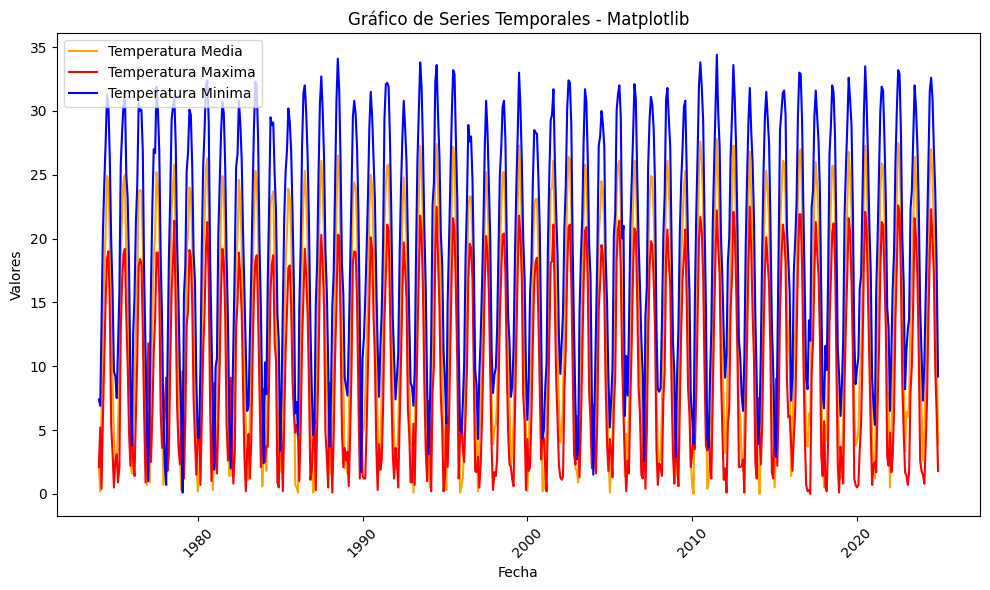

In [114]:
# --- 1. Gráfico de series temporales con Matplotlib ---
plt.figure(figsize=(10, 6))

plt.plot(df['Fecha'], df['Temp Media'], label='Temperatura Media', color='orange')
plt.plot(df['Fecha'], df['Temp Maxima'], label='Temperatura Maxima', color='red')
plt.plot(df['Fecha'], df['Temp Minima'], label='Temperatura Minima', color='blue')

plt.title('Gráfico de Series Temporales - Matplotlib')
plt.xlabel('Fecha')
plt.ylabel('Valores')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [115]:
# --- 2. Gráfico de series temporales con Plotly ---
fig = go.Figure()
fig.add_trace(go.Scatter(x=df['Fecha'], y=df['Temp Media'], mode='lines', name='Temperatura Media', line=dict(color='orange')))
fig.add_trace(go.Scatter(x=df['Fecha'], y=df['Temp Minima'], mode='lines', name='Temperatura Minima', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=df['Fecha'], y=df['Temp Maxima'], mode='lines', name='Temperatura Maxima', line=dict(color='red')))
fig.update_layout(
    title='Gráfico de Series Temporales - Plotly',
    xaxis_title='Fecha',
    yaxis_title='Valores',
    template='plotly_dark'
)
fig.show()

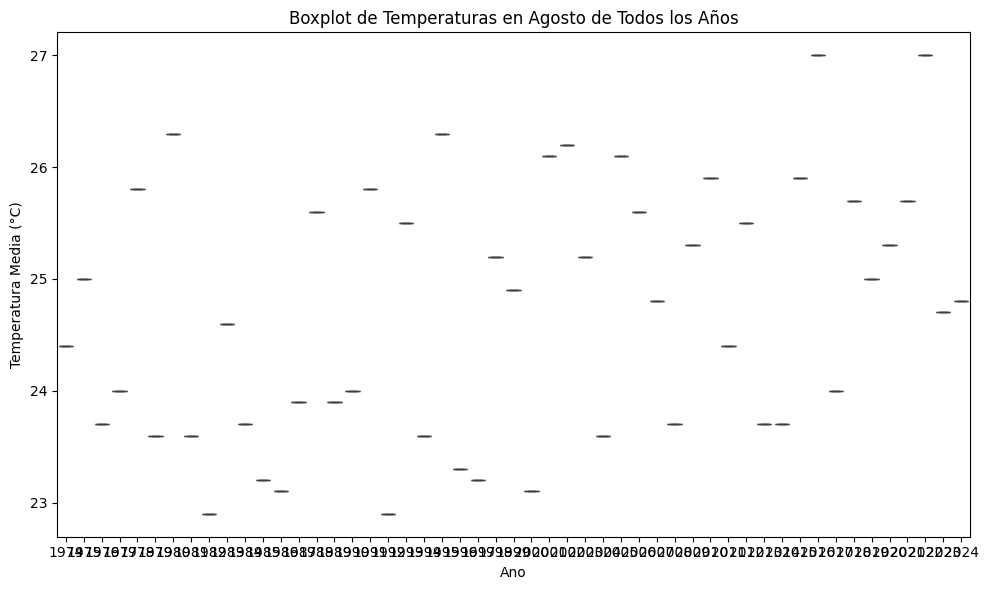

In [116]:
# Filtrar solo los registros correspondientes a agosto de todos los años
df_agosto = df[df['Mes'] == 8]

# --- 3. Boxplot mensual con Seaborn ---
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_agosto, x='Ano', y='Temp Media')
plt.title('Boxplot de Temperaturas en Agosto de Todos los Años')
plt.xlabel('Ano')
plt.ylabel('Temperatura Media (°C)')
plt.tight_layout()
plt.show()

In [117]:
# Filtrar solo los registros correspondientes a agosto de todos los años
df_agosto = df[df['Mes'] == 8]

# --- 4. Boxplot mensual con Plotly ---
fig = px.box(df_agosto, x="Ano", y="Temp Media", title="Boxplot de Temperaturas en Agosto de Todos los Años",
             labels={"Temp Media": "Temperatura Media (°C)", "Ano": "Año"})
fig.show()

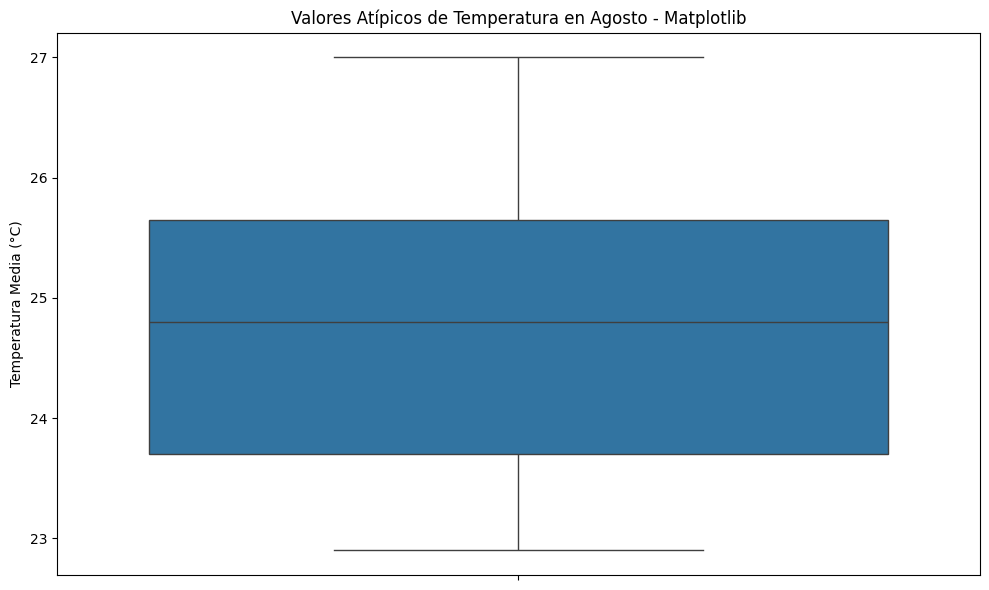

In [118]:
# --- 5. Análisis de valores atípicos en agosto con Matplotlib ---
august_data = df[df['Mes'] == 8]
plt.figure(figsize=(10, 6))
sns.boxplot(august_data['Temp Media'])
plt.title('Valores Atípicos de Temperatura en Agosto - Matplotlib')
plt.ylabel('Temperatura Media (°C)')
plt.tight_layout()
plt.show()

# --- 6. Análisis de valores atípicos en agosto con Plotly ---
fig = px.box(august_data, y="Temp Media", title="Valores Atípicos de Temperatura en Agosto - Plotly",
             labels={"Temp Media": "Temperatura Media (°C)"})
fig.show()

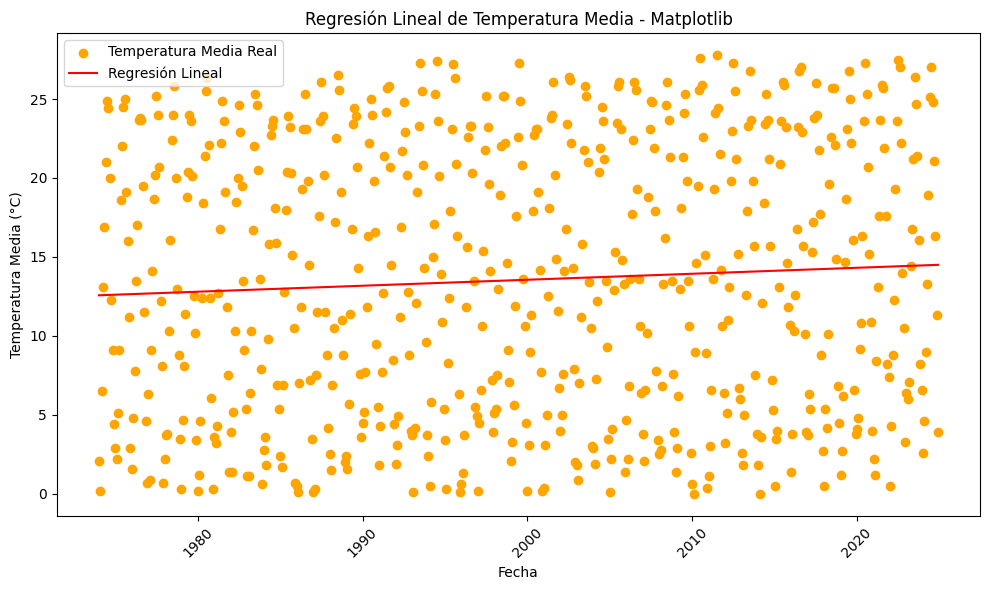

In [119]:
# Convertir 'Fecha' a datetime y luego a timestamp numérico
df['Fecha'] = pd.to_datetime(df['Fecha'])
df['Fecha_num'] = (df['Fecha'] - pd.to_datetime('1970-01-01')).dt.total_seconds() #convertimos a segundos desde 1970.

# Convertir 'Temp Media' a numérico, manejando posibles errores
df['Temp Media'] = pd.to_numeric(df['Temp Media'], errors='coerce')
df = df.dropna(subset=['Temp Media', 'Fecha_num']) #eliminamos los valores nulos.

# --- 7. Regresión lineal con Matplotlib ---
X = df[['Fecha_num']]  # Variable independiente (numérica)
y = df['Temp Media']  # Variable dependiente

model = LinearRegression()
model.fit(X, y)

y_pred = model.predict(X)

plt.figure(figsize=(10, 6))
plt.scatter(df['Fecha'], y, label='Temperatura Media Real', color='orange')
plt.plot(df['Fecha'], y_pred, color='red', label='Regresión Lineal')
plt.title('Regresión Lineal de Temperatura Media - Matplotlib')
plt.xlabel('Fecha')
plt.ylabel('Temperatura Media (°C)')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [120]:
# --- 8. Regresión lineal con Plotly ---
fig = go.Figure()
fig.add_trace(go.Scatter(x=df['Fecha'], y=df['Temp Media'], mode='markers', name='Datos Reales', marker=dict(color='orange')))
fig.add_trace(go.Scatter(x=df['Fecha'], y=y_pred, mode='lines', name='Regresión Lineal', line=dict(color='red')))
fig.update_layout(
    title='Regresión Lineal de Temperatura Media - Plotly',
    xaxis_title='Fecha',
    yaxis_title='Temperatura Media (°C)',
    template='plotly_dark'
)
fig.show()

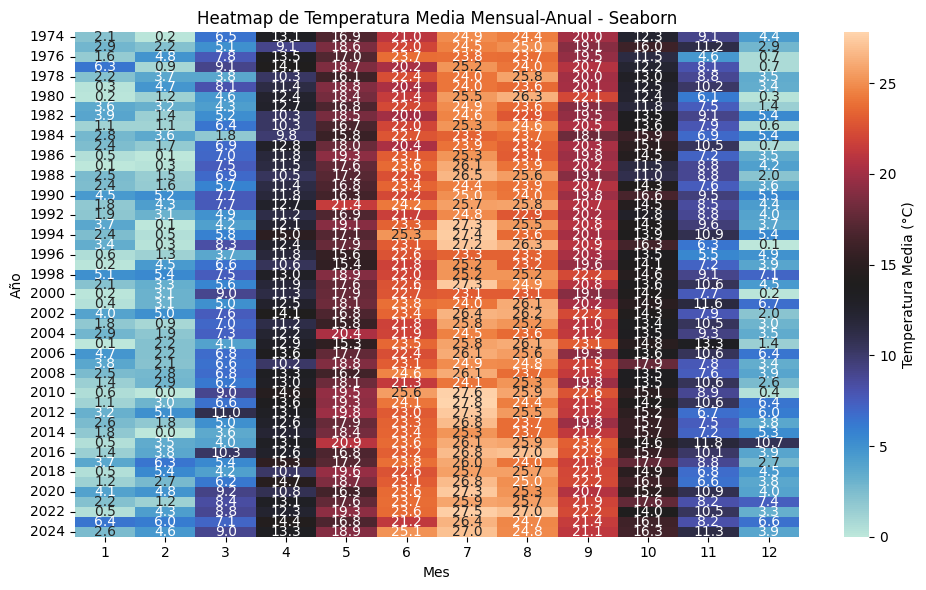

In [121]:
# Limpiar y convertir los tipos de datos
df['Temp Media'] = pd.to_numeric(df['Temp Media'], errors='coerce')
df = df.dropna(subset=['Temp Media'])
df['Ano'] = df['Ano'].astype(int)
df['Mes'] = df['Mes'].astype(int)

# --- 9. Heatmap mensual-anual con Seaborn ---
pivot = df.pivot_table(values='Temp Media', index='Ano', columns='Mes', aggfunc='mean')
plt.figure(figsize=(10, 6))
sns.heatmap(pivot, annot=True, fmt=".1f", cmap='icefire', cbar_kws={'label': 'Temperatura Media (°C)'})
plt.title('Heatmap de Temperatura Media Mensual-Anual - Seaborn')
plt.xlabel('Mes')
plt.ylabel('Año')
plt.tight_layout()
plt.show()

# --- 10. Heatmap mensual-anual con Plotly ---
fig = px.imshow(pivot, color_continuous_scale='icefire', title='Heatmap de Temperatura Media Mensual-Anual - Plotly')
fig.show()

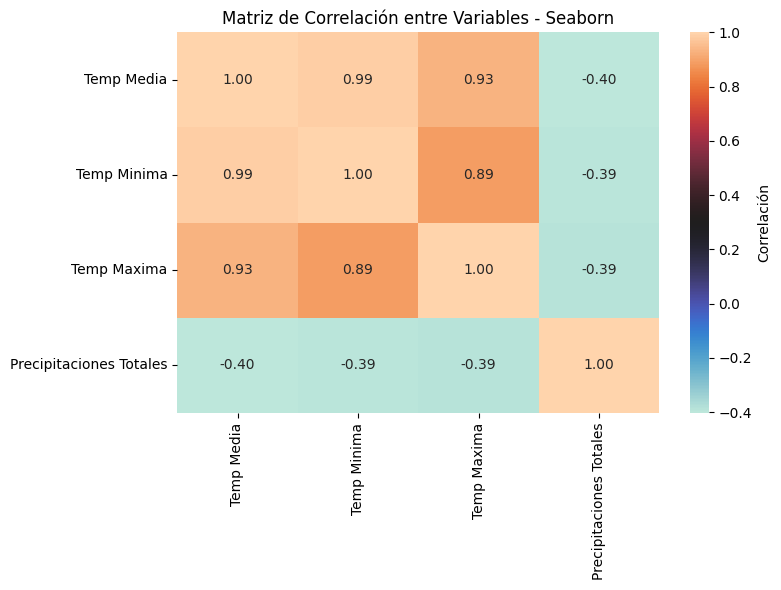

In [122]:
# Verificar y convertir tipos de datos
df['Temp Media'] = pd.to_numeric(df['Temp Media'], errors='coerce')
df['Temp Minima'] = pd.to_numeric(df['Temp Minima'], errors='coerce')
df['Temp Maxima'] = pd.to_numeric(df['Temp Maxima'], errors='coerce')
df['Precipitaciones Totales'] = pd.to_numeric(df['Precipitaciones Totales'], errors='coerce')
df = df.dropna(subset=['Temp Media', 'Temp Minima', 'Temp Maxima', 'Precipitaciones Totales'])

# --- 11. Correlación entre variables con Seaborn ---
correlation_matrix = df[['Temp Media', 'Temp Minima', 'Temp Maxima', 'Precipitaciones Totales']].corr()
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='icefire', fmt='.2f', cbar_kws={'label': 'Correlación'})
plt.title('Matriz de Correlación entre Variables - Seaborn')
plt.tight_layout()
plt.show()

# --- 12. Correlación entre variables con Plotly ---
fig = px.imshow(correlation_matrix, text_auto=True, color_continuous_scale='icefire',
                title='Matriz de Correlación entre Variables - Plotly')
fig.show()

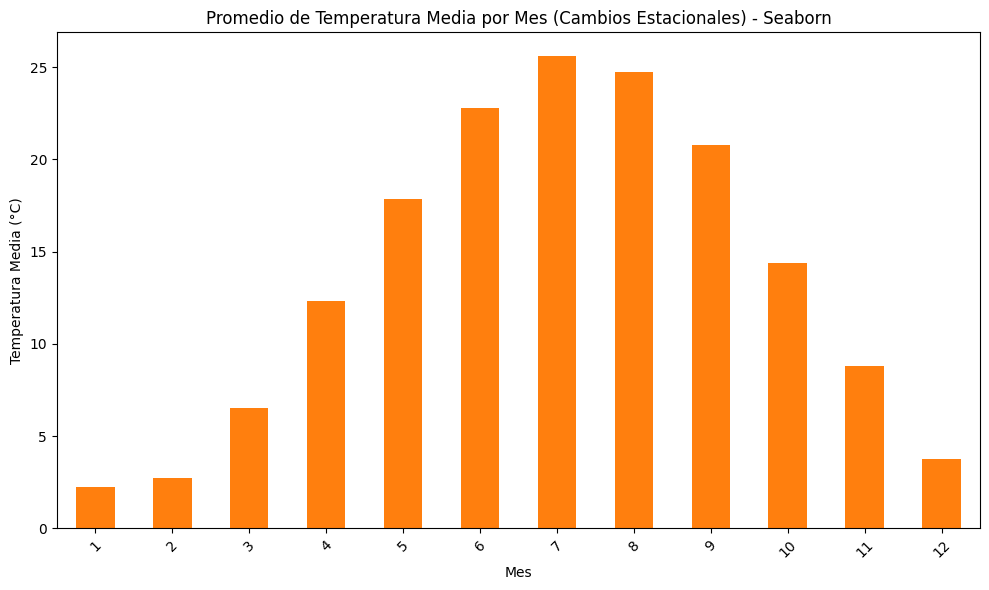

In [123]:
# --- 13. Cambios estacionales con Seaborn ---
monthly_avg_temp = df.groupby('Mes')['Temp Media'].mean()
plt.figure(figsize=(10, 6))
monthly_avg_temp.plot(kind='bar', color='tab:orange')
plt.title('Promedio de Temperatura Media por Mes (Cambios Estacionales) - Seaborn')
plt.xlabel('Mes')
plt.ylabel('Temperatura Media (°C)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# --- 14. Cambios estacionales con Plotly ---
fig = px.bar(monthly_avg_temp, title='Promedio de Temperatura Media por Mes (Cambios Estacionales) - Plotly', labels={"value": "Temperatura Media (°C)", "index": "Mes"})
fig.show()